<a href="https://colab.research.google.com/github/anhvt00/NeuroAI-2024/blob/main/Biologically_plausible_learning_rules_in_SNNs_and_MLPs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# @title Importing dependencies
from IPython.display import Image, SVG, display
import os
from pathlib import Path

import random
from tqdm import tqdm
import warnings
import numpy as np
import matplotlib.pyplot as plt
import scipy
import torch
import torchvision
import contextlib
import io

from ipywidgets import widgets
from IPython.display import YouTubeVideo
from IPython.display import IFrame
from IPython.display import display
# @title Figure settings

import ipywidgets as widgets       # interactive display
%config InlineBackend.figure_format = 'retina'
plt.style.use("https://raw.githubusercontent.com/ClimateMatchAcademy/course-content/main/cma.mplstyle")

### Helper functions

In [ ]:
#@markdown To get started exploring the dataset, here are a few plotting functions:

#@markdown `get_plotting_color()`: Returns a color for the specific dataset, e.g. "train" or model index.
def get_plotting_color(dataset="train", model_idx=None):
  if model_idx is not None:
    dataset = None

  if model_idx == 0 or dataset == "train":
    color = "#1F77B4" # blue
  elif model_idx == 1 or dataset == "valid":
    color = "#FF7F0E" # orange
  elif model_idx == 2 or dataset == "test":
    color = "#2CA02C" # green
  else:
    if model_idx is not None:
      raise NotImplementedError("Colors only implemented for up to 3 models.")
    else:
      raise NotImplementedError(
          f"{dataset} dataset not recognized. Expected 'train', 'valid' "
          "or 'test'."
          )

  return color


#@markdown `plot_examples(subset)`: Plot examples from the dataset organized by their predicted class
#@markdown (if a model is provided) or by their class label otherwise
def plot_examples(subset, num_examples_per_class=8, MLP=None, seed=None,
                  batch_size=32, num_classes=10, ax=None):
  """
  Function for visualizing example images from the dataset, organized by their
  predicted class, if a model is provided, or by their class, otherwise.

  Arguments:
  - subset (torch dataset or torch dataset subset): dataset from which to
    visualized images.
  - num_examples_per_class (int, optional): number of examples to visualize per
    class
  - MLP (MultiLayerPerceptron or None, optional): model to use to retrieve the
    predicted class for each image. If MLP is None, images will be organized by
    their class label. Otherwise, images will be organized by their predicted
    class.
  - seed (int or None, optional): Seed to use to randomly sample images to
    visualize.
  - batch_size (int, optional): If MLP is not None, number of images to
    retrieve predicted class for at one time.
  - num_classes (int, optional): Number of classes in the data.
  - ax (plt subplot, optional): Axis on which to plot images. If None, a new
    axis will be created.

  Returns:
  - ax (plt subplot): Axis on which images were plotted.
  """

  if MLP is None:
    xlabel = "Class"
  else:
    MLP.eval()
    xlabel = "Predicted class"

  if ax is None:
    fig_wid = min(8, num_classes * 0.6)
    fig_hei = min(8, num_examples_per_class * 0.6)
    _, ax = plt.subplots(figsize=(fig_wid, fig_hei))

  if seed is None:
    generator = None
  else:
    generator = torch.Generator()
    generator.manual_seed(seed)

  loader = torch.utils.data.DataLoader(
      subset, batch_size=batch_size, shuffle=True, generator=generator
      )

  plot_images = {i: list() for i in range(num_classes)}
  with torch.no_grad():
    for X, y in loader:
      if MLP is not None:
        y = MLP(X)
        y = torch.argmax(y, axis=1)

      done = True
      for i in range(num_classes):
        num_to_add = int(num_examples_per_class - len(plot_images[i]))
        if num_to_add:
          add_images = np.where(y == i)[0]
          if len(add_images):
            for add_i in add_images[: num_to_add]:
              plot_images[i].append(X[add_i, 0].numpy())
          if len(plot_images[i]) != num_examples_per_class:
            done = False

      if done:
        break

  hei, wid = X[0, 0].shape
  final_image = np.full((num_examples_per_class * hei, num_classes * wid), np.nan)
  for i, images in plot_images.items():
    if len(images):
      final_image[: len(images) * hei, i * wid: (i + 1) * wid] = np.vstack(images)

  ax.imshow(final_image, cmap="gray")

  ax.set_xlabel(xlabel)
  ax.set_xticks((np.arange(num_classes) + 0.5) * wid)
  ax.set_xticklabels([f"{int(i)}" for i in range(num_classes)])
  ax.set_yticks([])
  ax.set_title(f"Examples per {xlabel.lower()}")

  return ax

#@markdown `plot_class_distribution(train_set)`: Plots the distribution of classes in each set (train, validation, test).
def plot_class_distribution(train_set, valid_set=None, test_set=None,
                            num_classes=10, ax=None):
  """
  Function for plotting the number of examples per class in each subset.

  Arguments:
  - train_set (torch dataset or torch dataset subset): training dataset
  - valid_set (torch dataset or torch dataset subset, optional): validation
    dataset
  - test_set (torch dataset or torch dataset subset, optional): test
    dataset
  - num_classes (int, optional): Number of classes in the data.
  - ax (plt subplot, optional): Axis on which to plot images. If None, a new
    axis will be created.

  Returns:
  - ax (plt subplot): Axis on which images were plotted.
  """

  if ax is None:
    _, ax = plt.subplots(figsize=(6, 3))

  bins = np.arange(num_classes + 1) - 0.5

  for dataset_name, dataset in [
      ("train", train_set), ("valid", valid_set), ("test", test_set)
      ]:
    if dataset is None:
      continue

    if hasattr(dataset, "dataset"):
      targets = dataset.dataset.targets[dataset.indices]
    else:
      targets = dataset.targets

    outputs = ax.hist(
        targets,
        bins=bins,
        alpha=0.3,
        color=get_plotting_color(dataset_name),
        label=dataset_name,
        )

    per_class = len(targets) / num_classes
    ax.axhline(
        per_class,
        ls="dashed",
        color=get_plotting_color(dataset_name),
        alpha=0.8
        )

  ax.set_xticks(range(num_classes))
  ax.set_title("Counts per class")
  ax.set_xlabel("Class")
  ax.set_ylabel("Count")
  ax.legend(loc="center right")

  return ax

#@markdown `plot_results(results_dict)`: Plots classification losses and
#@markdown accuracies across epochs for the training and validation sets.
def plot_results(results_dict, num_classes=10, ax=None):
  """
  Function for plotting losses and accuracies across learning.

  Arguments:
  - results_dict (dict): Dictionary storing results across epochs on training
    and validation data.
  - num_classes (float, optional): Number of classes, used to calculate chance
    accuracy.
  - ax (plt subplot, optional): Axis on which to plot results. If None, a new
    axis will be created.

  Returns:
  - ax (plt subplot): Axis on which results were plotted.
  """

  if ax is None:
    _, ax = plt.subplots(figsize=(7, 3.5))

  loss_ax = ax
  acc_ax = None

  chance = 100 / num_classes

  plotted = False
  for result_type in ["losses", "accuracies"]:
    for dataset in ["train", "valid"]:
      key = f"avg_{dataset}_{result_type}"
      if key in results_dict.keys():
        if result_type == "losses":
          ylabel = "Loss"
          plot_ax = loss_ax
          ls = None
        elif result_type == "accuracies":
          if acc_ax is None:
            acc_ax = ax.twinx()
            acc_ax.spines[["right"]].set_visible(True)
            acc_ax.axhline(chance, ls="dashed", color="k", alpha=0.8)
            acc_ax.set_ylim(-5, 105)
          ylabel = "Accuracy (%)"
          plot_ax = acc_ax
          ls = "dashed"
        else:
          raise RuntimeError(f"{result_type} result type not recognized.")

        data = results_dict[key]
        plot_ax.plot(
            data,
            ls=ls,
            label=dataset,
            alpha=0.8,
            color=get_plotting_color(dataset)
            )
        plot_ax.set_ylabel(ylabel)
        plotted = True

  if plotted:
    ax.legend(loc="center left")
    ax.set_xticks(range(len(data)))
    ax.set_xticklabels([f"{int(e)}" for e in range(len(data))])
    ymin, ymax = ax.get_ylim()
    if ymin > 0:
      ymin = 0
      pad = (ymax - ymin) * 0.05
      ax.set_ylim(ymin - pad, ymax + pad)

  else:
    raise RuntimeError("No data found to plot.")

  ax.set_title("Performance across learning")
  ax.set_xlabel("Epoch")

  return ax


#@markdown `plot_scores_per_class(results_dict)`: Plots the classification
#@markdown accuracies by class for the training and validation sets (for the last epoch).
def plot_scores_per_class(results_dict, num_classes=10, ax=None):
  """
  Function for plotting accuracy scores for each class.

  Arguments:
  - results_dict (dict): Dictionary storing results across epochs on training
    and validation data.
  - num_classes (int, optional): Number of classes in the data.
  - ax (plt subplot, optional): Axis on which to plot accuracies. If None, a new
    axis will be created.

  Returns:
  - ax (plt subplot): Axis on which accuracies were plotted.
  """

  if ax is None:
    _, ax = plt.subplots(figsize=(6, 3))

  avgs = list()
  ax.set_prop_cycle(None) # reset color cycle
  for s, dataset in enumerate(["train", "valid"]):
    correct_by_class = results_dict[f"{dataset}_correct_by_class"]
    seen_by_class = results_dict[f"{dataset}_seen_by_class"]
    xs, ys = list(), list()
    for i, total in seen_by_class.items():
      xs.append(i + 0.3 * (s - 0.5))
      if total == 0:
        ys.append(np.nan)
      else:
        ys.append(100 * correct_by_class[i] / total)

    avg_key = f"avg_{dataset}_accuracies"
    if avg_key in results_dict.keys():
      ax.axhline(
          results_dict[avg_key][-1], ls="dashed", alpha=0.8,
          color=get_plotting_color(dataset)
          )

    ax.bar(
        xs, ys, label=dataset, width=0.3, alpha=0.8,
        color=get_plotting_color(dataset)
        )

  ax.set_xticks(range(num_classes))
  ax.set_xlabel("Class")
  ax.set_ylabel("Accuracy (%)")
  ax.set_title("Class scores")
  ax.set_ylim(-5, 105)

  chance = 100 / num_classes
  ax.axhline(chance, ls="dashed", color="k", alpha=0.8)

  ax.legend()

  return ax


#@markdown `plot_weights(MLP)`: Plots weights before and after training.
def plot_weights(MLP, shared_colorbar=False):
  """
  Function for plotting model weights and biases before and after learning.

  Arguments:
  - MLP (torch model): Model for which to plot weights and biases.
  - shared_colorbar (bool, optional): If True, one colorbar is shared for all
      parameters.

  Returns:
  - ax (plt subplot array): Axes on which weights and biases were plotted.
  """

  param_names = MLP.list_parameters()

  params_images = dict()
  pre_means = dict()
  post_means = dict()
  vmin, vmax = np.inf, -np.inf
  for param_name in param_names:
    layer, param_type = param_name.split("_")
    init_params = getattr(MLP, f"init_{layer}_{param_type}").numpy()
    separator = np.full((1, init_params.shape[-1]), np.nan)
    last_params = getattr(getattr(MLP, layer), param_type).detach().numpy()
    diff_params = last_params - init_params

    params_image = np.vstack(
        [init_params, separator, last_params, separator, diff_params]
        )
    vmin = min(vmin, np.nanmin(params_image))
    vmax = min(vmax, np.nanmax(params_image))

    params_images[param_name] = params_image
    pre_means[param_name] = init_params.mean()
    post_means[param_name] = last_params.mean()

  nrows = len(param_names)
  gridspec_kw = dict()
  if len(param_names) == 4:
    gridspec_kw["height_ratios"] = [5, 1, 5, 1]
    cbar_label = "Weight/bias values"
  elif len(param_names) == 2:
    gridspec_kw["height_ratios"] = [5, 5]
    cbar_label = "Weight values"
  else:
    raise NotImplementedError("Expected 2 parameters (weights only) or "
      f"4 parameters (weights and biases), but found {len(param_names)}"
    )

  if shared_colorbar:
    nrows += 1
    gridspec_kw["height_ratios"].append(1)
  else:
    vmin, vmax = None, None

  fig, axes = plt.subplots(
      nrows, 1, figsize=(6, nrows + 3), gridspec_kw=gridspec_kw
      )

  for i, (param_name, params_image) in enumerate(params_images.items()):
    layer, param_type = param_name.split("_")
    layer_str = "First" if layer == "lin1" else "Second"
    param_str = "weights" if param_type == "weight" else "biases"

    axes[i].set_title(f"{layer_str} linear layer {param_str} (pre, post and diff)")
    im = axes[i].imshow(params_image, aspect="auto", vmin=vmin, vmax=vmax)
    if not shared_colorbar:
      cbar = fig.colorbar(im, ax=axes[i], aspect=10)
      cbar.ax.axhline(pre_means[param_name], ls="dotted", color="k", alpha=0.5)
      cbar.ax.axhline(post_means[param_name], color="k", alpha=0.5)

    if param_type == "weight":
      axes[i].set_xlabel("Input dim.")
      axes[i].set_ylabel("Output dim.")
    axes[i].spines[["left", "bottom"]].set_visible(False)
    axes[i].set_xticks([])
    axes[i].set_yticks([])

  if shared_colorbar:
    cax = axes[-1]
    cbar = fig.colorbar(im, cax=cax, orientation="horizontal", location="bottom")
    cax.set_xlabel(cbar_label)

  return axes

def download_mnist(train_prop=0.8, keep_prop=0.5):

  valid_prop = 1 - train_prop

  discard_prop = 1 - keep_prop

  transform = torchvision.transforms.Compose(
      [torchvision.transforms.ToTensor(),
      torchvision.transforms.Normalize((0.1307,), (0.3081,))]
      )


  with contextlib.redirect_stdout(io.StringIO()): #to suppress output

      full_train_set = torchvision.datasets.MNIST(
          root="./data/", train=True, download=True, transform=transform
          )
      full_test_set = torchvision.datasets.MNIST(
          root="./data/", train=False, download=True, transform=transform
          )

  train_set, valid_set, _ = torch.utils.data.random_split(
      full_train_set,
      [train_prop * keep_prop, valid_prop * keep_prop, discard_prop]
      )
  test_set, _ = torch.utils.data.random_split(
      full_test_set,
      [keep_prop, discard_prop]
      )

  print("Number of examples retained:")
  print(f"  {len(train_set)} (training)")
  print(f"  {len(valid_set)} (validation)")
  print(f"  {len(test_set)} (test)")

  return train_set, valid_set, test_set

### Dataset preparation

In [ ]:
# @markdown `download_mnist()`: Function to download MNIST.

train_set, valid_set, test_set = download_mnist()


# Dataloaders
BATCH_SIZE = 32

train_loader = torch.utils.data.DataLoader(train_set, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = torch.utils.data.DataLoader(valid_set, batch_size=BATCH_SIZE, shuffle=False)
test_loader = torch.utils.data.DataLoader(test_set, batch_size=BATCH_SIZE, shuffle=False)

Number of examples retained:
  24001 (training)
  5999 (validation)
  5000 (test)


### Restrict classes function

In [ ]:
#@markdown The following function returns a dataset restricted to specific classes:

#@markdown `restrict_classes(dataset)`: Keeps specified classes in a dataset.

def restrict_classes(dataset, classes=[6], keep=True):
  """
  Removes or keeps specified classes in a dataset.

  Arguments:
  - dataset (torch dataset or subset): Dataset with class targets.
  - classes (list): List of classes to keep or remove.
  - keep (bool): If True, the classes specified are kept. If False, they are
  removed.

  Returns:
  - new_dataset (torch dataset or subset): Datset restricted as specified.
  """

  if hasattr(dataset, "dataset"):
    indices = np.asarray(dataset.indices)
    targets = dataset.dataset.targets[indices]
    dataset = dataset.dataset
  else:
    indices = np.arange(len(dataset))
    targets = dataset.targets

  specified_idxs = np.isin(targets, np.asarray(classes))
  if keep:
    retain_indices = indices[specified_idxs]
  else:
    retain_indices = indices[~specified_idxs]

  new_dataset = torch.utils.data.Subset(dataset, retain_indices)

  return new_dataset

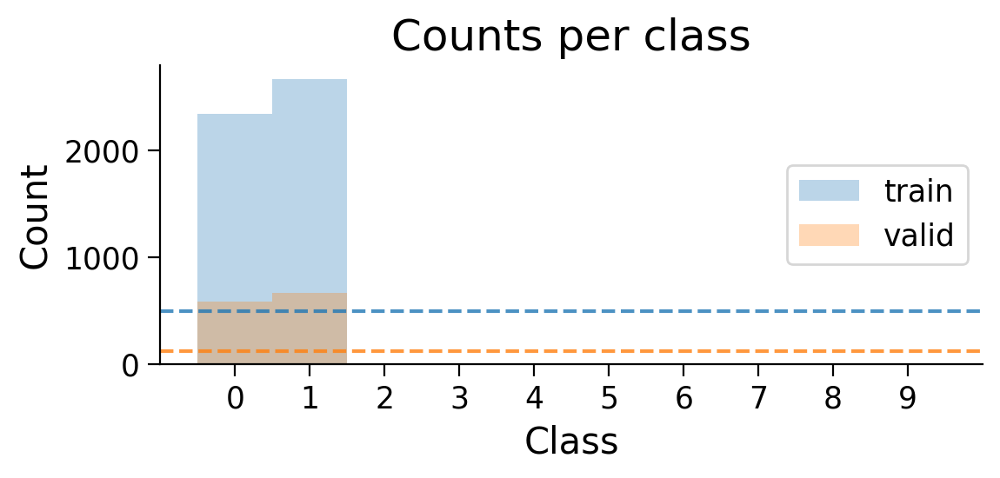

In [ ]:
train_set_2_classes = restrict_classes(train_set, [0, 1])
valid_set_2_classes = restrict_classes(valid_set, [0, 1])

plot_class_distribution(train_set_2_classes, valid_set_2_classes)

train_loader_2cls = torch.utils.data.DataLoader(train_set_2_classes, batch_size=BATCH_SIZE, shuffle=True)
valid_loader_2cls = torch.utils.data.DataLoader(valid_set_2_classes, batch_size=BATCH_SIZE, shuffle=False)

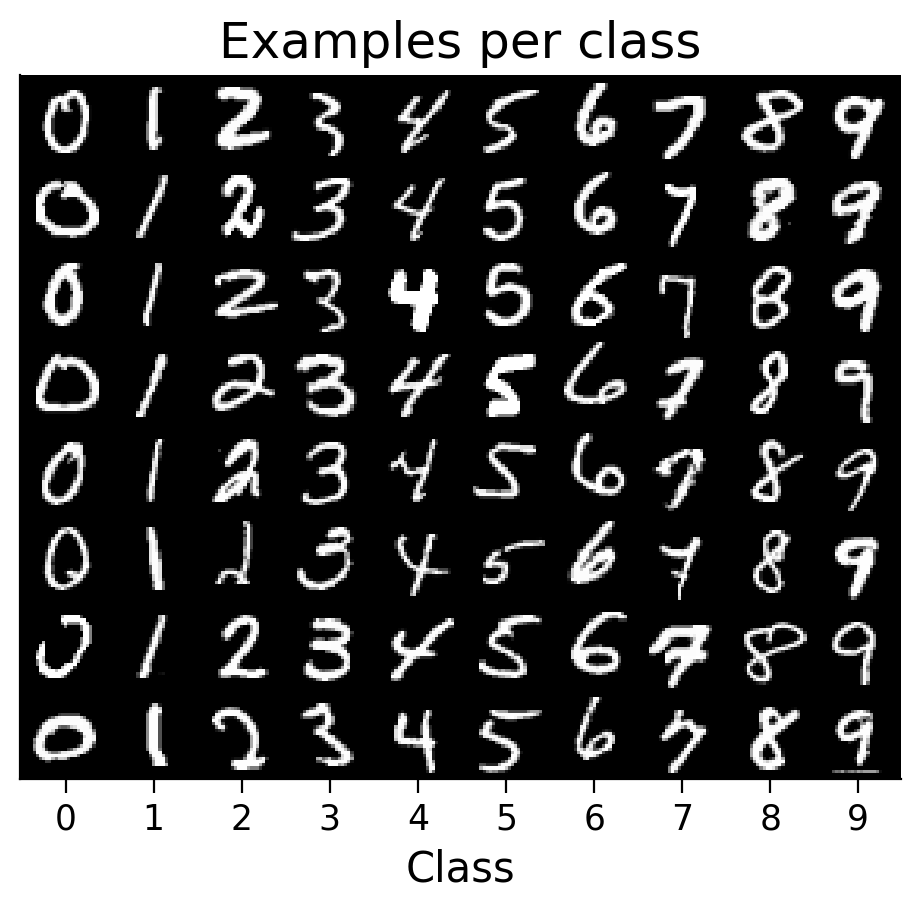

In [ ]:
plot_examples(train_set);

# Part 1: MLP

### Backprop MLP

#### Backprop MLP definition

In [ ]:
NUM_INPUTS = np.product(train_set.dataset.data[0].shape) # size of an MNIST image
NUM_OUTPUTS = 10 # number of MNIST classes

class MultiLayerPerceptron(torch.nn.Module):
  """
  Simple multilayer perceptron model class with one hidden layer.
  """

  def __init__(
      self,
      num_inputs=NUM_INPUTS,
      num_hidden=100,
      num_outputs=NUM_OUTPUTS,
      activation_type="sigmoid",
      bias=False,
      ):
    """
    Initializes a multilayer perceptron with a single hidden layer.

    Arguments:
    - num_inputs (int, optional): number of input units (i.e., image size)
    - num_hidden (int, optional): number of hidden units in the hidden layer
    - num_outputs (int, optional): number of output units (i.e., number of
      classes)
    - activation_type (str, optional): type of activation to use for the hidden
      layer ('sigmoid', 'tanh', 'relu' or 'linear')
    - bias (bool, optional): if True, each linear layer will have biases in
      addition to weights
    """


    super().__init__()

    self.num_inputs = num_inputs
    self.num_hidden = num_hidden
    self.num_outputs = num_outputs
    self.activation_type = activation_type
    self.bias = bias

    # default weights (and biases, if applicable) initialization is used
    # see https://github.com/pytorch/pytorch/blob/main/torch/nn/modules/linear.py
    self.lin1 = torch.nn.Linear(num_inputs, num_hidden, bias=bias)
    self.lin2 = torch.nn.Linear(num_hidden, num_outputs, bias=bias)

    self._store_initial_weights_biases()

    self._set_activation() # activation on the hidden layer
    self.softmax = torch.nn.Softmax(dim=1) # activation on the output layer
    self.activations = {}  # Initialize activations dictionary  <-- Added


  def _store_initial_weights_biases(self):
    """
    Stores a copy of the network's initial weights and biases.
    """

    self.init_lin1_weight = self.lin1.weight.data.clone()
    self.init_lin2_weight = self.lin2.weight.data.clone()
    if self.bias:
      self.init_lin1_bias = self.lin1.bias.data.clone()
      self.init_lin2_bias = self.lin2.bias.data.clone()

  def _set_activation(self):
    """
    Sets the activation function used for the hidden layer.
    """

    if self.activation_type.lower() == "sigmoid":
      self.activation = torch.nn.Sigmoid() # maps to [0, 1]
    elif self.activation_type.lower() == "tanh":
      self.activation = torch.nn.Tanh() # maps to [-1, 1]
    elif self.activation_type.lower() == "relu":
      self.activation = torch.nn.ReLU() # maps to positive
    elif self.activation_type.lower() == "identity":
      self.activation = torch.nn.Identity() # maps to same
    else:
      raise NotImplementedError(
          f"{self.activation_type} activation type not recognized. Only "
          "'sigmoid', 'relu' and 'identity' have been implemented so far."
          )

  def forward(self, X, y=None):
    """
    Runs a forward pass through the network.

    Arguments:
    - X (torch.Tensor): Batch of input images.
    - y (torch.Tensor, optional): Batch of targets. This variable is not used
      here. However, it may be needed for other learning rules, to it is
      included as an argument here for compatibility.

    Returns:
    - y_pred (torch.Tensor): Predicted targets.
    """

    self.activations = {}  # Reset activations  <-- Added
    h = self.activation(self.lin1(X.reshape(-1, self.num_inputs)))
    self.activations['hidden'] = h.detach().cpu().numpy()  # Record activations  <-- Added
    y_pred = self.softmax(self.lin2(h))
    self.activations['output'] = y_pred.detach().cpu().numpy()  # Record activations  <-- Added
    return y_pred

  def forward_backprop(self, X):
        """
        Identical to forward(). Should not be overwritten when creating new
        child classes to implement other learning rules, as this method is used
        to compare the gradients calculated with other learning rules to those
        calculated with backprop.
        """
        self.activations = {}  # Reset activations  <-- Added
        h = self.activation(self.lin1(X.reshape(-1, self.num_inputs)))
        self.activations['hidden'] = h.detach().cpu().numpy()  # Record activations  <-- Added
        y_pred = self.softmax(self.lin2(h))
        self.activations['output'] = y_pred.detach().cpu().numpy()  # Record activations  <-- Added
        return y_pred


  def list_parameters(self):
    """
    Returns a list of model names for a gradient dictionary.

    Returns:
    - params_list (list): List of parameter names.
    """

    params_list = list()

    for layer_str in ["lin1", "lin2"]:
      params_list.append(f"{layer_str}_weight")
      if self.bias:
        params_list.append(f"{layer_str}_bias")

    return params_list


  def gather_gradient_dict(self):
    """
    Gathers a gradient dictionary for the model's parameters. Raises a
    runtime error if any parameters have no gradients.

    Returns:
    - gradient_dict (dict): A dictionary of gradients for each parameter.
    """

    params_list = self.list_parameters()

    gradient_dict = dict()
    for param_name in params_list:
      layer_str, param_str = param_name.split("_")
      layer = getattr(self, layer_str)
      grad = getattr(layer, param_str).grad
      if grad is None:
        raise RuntimeError("No gradient was computed")
      gradient_dict[param_name] = grad.detach().clone().numpy()

    return gradient_dict

#### Define backprop optimizer

In [ ]:
class BasicOptimizer(torch.optim.Optimizer):
  """
  Simple optimizer class based on the SGD optimizer.
  """
  def __init__(self, params, lr=0.01, weight_decay=0):
    """
    Initializes a basic optimizer object.

    Arguments:
    - params (generator): Generator for torch model parameters.
    - lr (float, optional): Learning rate.
    - weight_decay (float, optional): Weight decay.
    """

    if lr < 0.0:
        raise ValueError(f"Invalid learning rate: {lr}")
    if weight_decay < 0.0:
        raise ValueError(f"Invalid weight_decay value: {weight_decay}")

    defaults = dict(
        lr=lr,
        weight_decay=weight_decay,
        )

    super().__init__(params, defaults)

  def step(self):
      """
      Performs a single optimization step.
      """

      for group in self.param_groups:
        for p in group["params"]:

          # only update parameters with gradients
          if p.grad is not None:

            # apply weight decay to gradient, if applicable
            if group["weight_decay"] != 0:
              p.grad = p.grad.add(p, alpha=group["weight_decay"])

            # apply gradient-based update
            p.data.add_(p.grad, alpha=-group["lr"])

#### Training MLP models

In [ ]:
#@markdown `train_model(MLP, train_loader, valid_loader, optimizer)`: Main function.
#@markdown Trains the model across epochs. Aggregates loss and accuracy statistics
#@markdown from the training and validation datasets into a results dictionary which is returned.
def train_model(MLP, train_loader, valid_loader, optimizer, num_epochs=5):
  """
  Train a model for several epochs.

  Arguments:
  - MLP (torch model): Model to train.
  - train_loader (torch dataloader): Dataloader to use to train the model.
  - valid_loader (torch dataloader): Dataloader to use to validate the model.
  - optimizer (torch optimizer): Optimizer to use to update the model.
  - num_epochs (int, optional): Number of epochs to train model.

  Returns:
  - results_dict (dict): Dictionary storing results across epochs on training
    and validation data.
  """

  results_dict = {
      "avg_train_losses": list(),
      "avg_valid_losses": list(),
      "avg_train_accuracies": list(),
      "avg_valid_accuracies": list(),
  }

  for e in tqdm(range(num_epochs)):
    no_train = True if e == 0 else False # to get a baseline
    latest_epoch_results_dict = train_epoch(
        MLP, train_loader, valid_loader, optimizer=optimizer, no_train=no_train
        )

    for key, result in latest_epoch_results_dict.items():
      if key in results_dict.keys() and isinstance(results_dict[key], list):
        results_dict[key].append(latest_epoch_results_dict[key])
      else:
        results_dict[key] = result # copy latest
    print(f"Epoch {e + 1}/{num_epochs}")
    print(f"Train Loss: {results_dict['avg_train_losses'][-1]:.4f}, Train Accuracy: {results_dict['avg_train_accuracies'][-1]:.2f}%")
    print(f"Valid Loss: {results_dict['avg_valid_losses'][-1]:.4f}, Valid Accuracy: {results_dict['avg_valid_accuracies'][-1]:.2f}%")


  return results_dict


def train_epoch(MLP, train_loader, valid_loader, optimizer, no_train=False):
  """
  Train a model for one epoch.

  Arguments:
  - MLP (torch model): Model to train.
  - train_loader (torch dataloader): Dataloader to use to train the model.
  - valid_loader (torch dataloader): Dataloader to use to validate the model.
  - optimizer (torch optimizer): Optimizer to use to update the model.
  - no_train (bool, optional): If True, the model is not trained for the
    current epoch. Allows a baseline (chance) performance to be computed in the
    first epoch before training starts.

  Returns:
  - epoch_results_dict (dict): Dictionary storing epoch results on training
    and validation data.
  """

  criterion = torch.nn.NLLLoss()

  epoch_results_dict = dict()
  for dataset in ["train", "valid"]:
    for sub_str in ["correct_by_class", "seen_by_class"]:
      epoch_results_dict[f"{dataset}_{sub_str}"] = {
          i:0 for i in range(MLP.num_outputs)
          }

  MLP.train()
  train_losses, train_acc = list(), list()
  for X, y in train_loader:
    y_pred = MLP(X, y=y)
    loss = criterion(torch.log(y_pred), y)
    acc = (torch.argmax(y_pred.detach(), axis=1) == y).sum() / len(y)
    train_losses.append(loss.item() * len(y))
    train_acc.append(acc.item() * len(y))
    update_results_by_class_in_place(
        y, y_pred.detach(), epoch_results_dict, dataset="train",
        num_classes=MLP.num_outputs
        )
    optimizer.zero_grad()
    if not no_train:
      loss.backward()
      optimizer.step()

  num_items = len(train_loader.dataset)
  epoch_results_dict["avg_train_losses"] = np.sum(train_losses) / num_items
  epoch_results_dict["avg_train_accuracies"] = np.sum(train_acc) / num_items * 100

  MLP.eval()
  valid_losses, valid_acc = list(), list()
  with torch.no_grad():
    for X, y in valid_loader:
      y_pred = MLP(X)
      loss = criterion(torch.log(y_pred), y)
      acc = (torch.argmax(y_pred, axis=1) == y).sum() / len(y)
      valid_losses.append(loss.item() * len(y))
      valid_acc.append(acc.item() * len(y))
      update_results_by_class_in_place(
          y, y_pred.detach(), epoch_results_dict, dataset="valid"
          )

  num_items = len(valid_loader.dataset)
  epoch_results_dict["avg_valid_losses"] = np.sum(valid_losses) / num_items
  epoch_results_dict["avg_valid_accuracies"] = np.sum(valid_acc) / num_items * 100

  return epoch_results_dict


def update_results_by_class_in_place(y, y_pred, result_dict, dataset="train",
                                     num_classes=10):
  """
  Updates results dictionary in place during a training epoch by adding data
  needed to compute the accuracies for each class.

  Arguments:
  - y (torch Tensor): target labels
  - y_pred (torch Tensor): predicted targets
  - result_dict (dict): Dictionary storing epoch results on training
    and validation data.
  - dataset (str, optional): Dataset for which results are being added.
  - num_classes (int, optional): Number of classes.
  """

  correct_by_class = None
  seen_by_class = None

  y_pred = np.argmax(y_pred, axis=1)
  if len(y) != len(y_pred):
    raise RuntimeError("Number of predictions does not match number of targets.")

  for i in result_dict[f"{dataset}_seen_by_class"].keys():
    idxs = np.where(y == int(i))[0]
    result_dict[f"{dataset}_seen_by_class"][int(i)] += len(idxs)

    num_correct = int(sum(y[idxs] == y_pred[idxs]))
    result_dict[f"{dataset}_correct_by_class"][int(i)] += num_correct

In [ ]:
NUM_EPOCHS = 10
# Model
NUM_HIDDEN = 100
ACTIVATION = "relu" # output constrained between 0 and 1
BIAS = False
LR = 1e-3

MLP_10cls = MultiLayerPerceptron(
    num_hidden=NUM_HIDDEN,
    activation_type=ACTIVATION,
    bias=BIAS,
    )


backprop_optimizer_10cls = BasicOptimizer(MLP_10cls.parameters(), lr=LR)
MLP_results_dict_10cls = train_model(
    MLP_10cls,
    train_loader,
    valid_loader,
    optimizer=backprop_optimizer_10cls,
    num_epochs=8
    )


 12%|█▎        | 1/8 [00:10<01:10, 10.06s/it]

Epoch 1/8
Train Loss: 2.3399, Train Accuracy: 8.83%
Valid Loss: 2.3398, Valid Accuracy: 8.70%


 25%|██▌       | 2/8 [00:20<01:01, 10.33s/it]

Epoch 2/8
Train Loss: 1.7437, Train Accuracy: 58.38%
Valid Loss: 1.2222, Valid Accuracy: 77.41%


 38%|███▊      | 3/8 [00:31<00:52, 10.41s/it]

Epoch 3/8
Train Loss: 0.9510, Train Accuracy: 81.92%
Valid Loss: 0.7549, Valid Accuracy: 83.91%


 50%|█████     | 4/8 [00:40<00:40, 10.02s/it]

Epoch 4/8
Train Loss: 0.6638, Train Accuracy: 85.38%
Valid Loss: 0.5860, Valid Accuracy: 85.95%


 62%|██████▎   | 5/8 [00:50<00:30, 10.17s/it]

Epoch 5/8
Train Loss: 0.5441, Train Accuracy: 87.07%
Valid Loss: 0.5039, Valid Accuracy: 87.05%


 75%|███████▌  | 6/8 [01:01<00:20, 10.29s/it]

Epoch 6/8
Train Loss: 0.4794, Train Accuracy: 88.06%
Valid Loss: 0.4543, Valid Accuracy: 87.96%


 88%|████████▊ | 7/8 [01:12<00:10, 10.43s/it]

Epoch 7/8
Train Loss: 0.4387, Train Accuracy: 88.60%
Valid Loss: 0.4222, Valid Accuracy: 88.50%


100%|██████████| 8/8 [01:22<00:00, 10.26s/it]

Epoch 8/8
Train Loss: 0.4106, Train Accuracy: 89.08%
Valid Loss: 0.4001, Valid Accuracy: 89.01%


#### Evaluation MLP on 10-class task

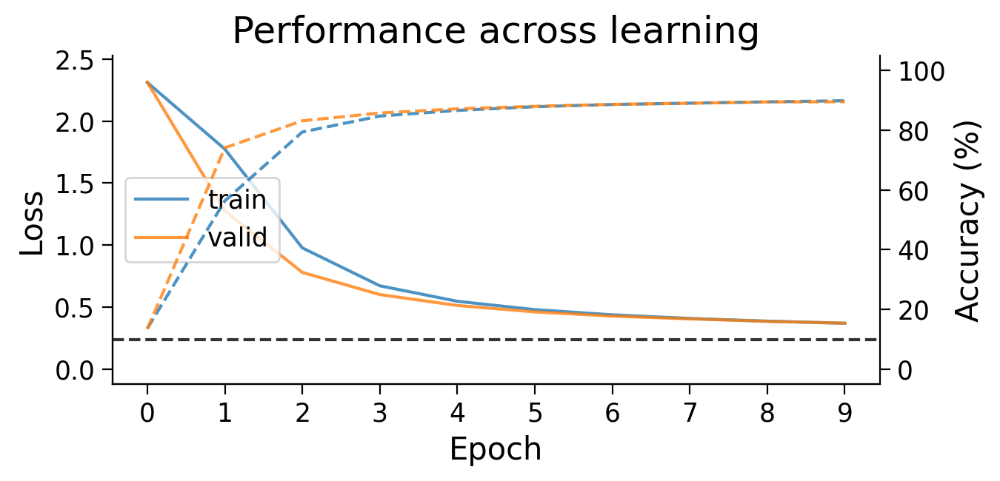

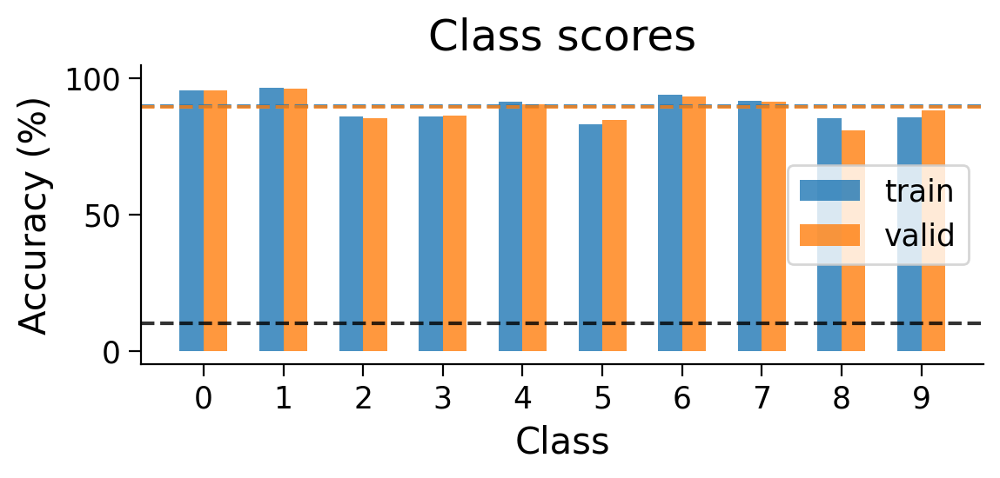

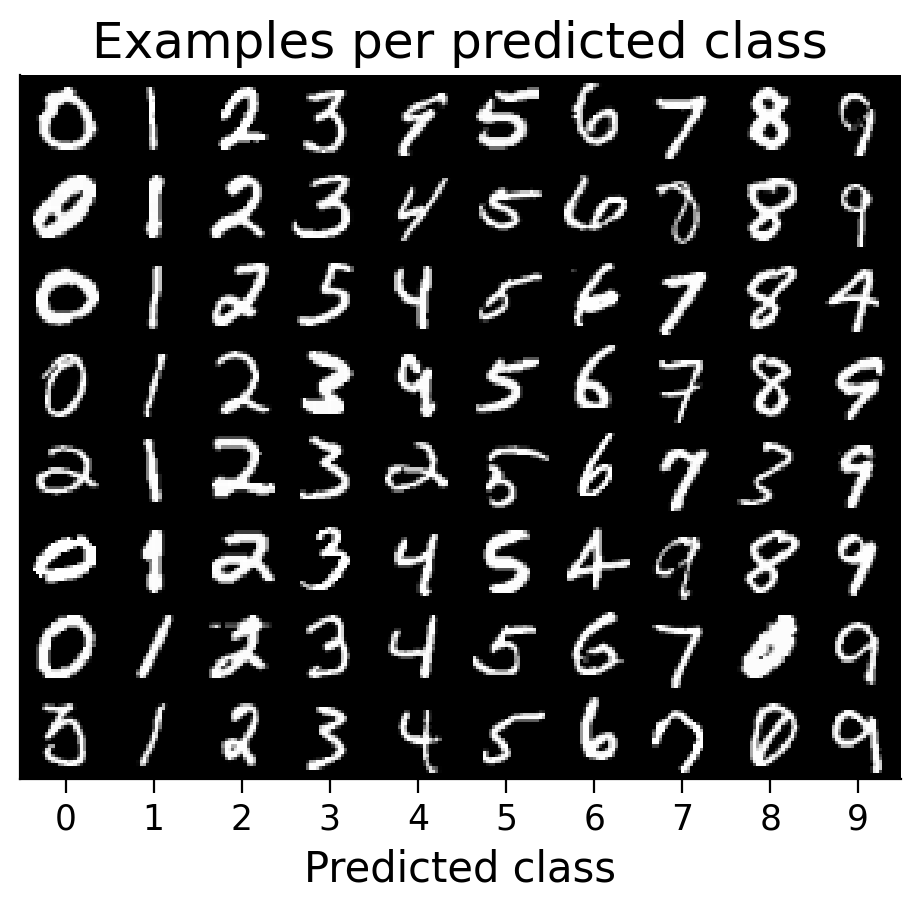

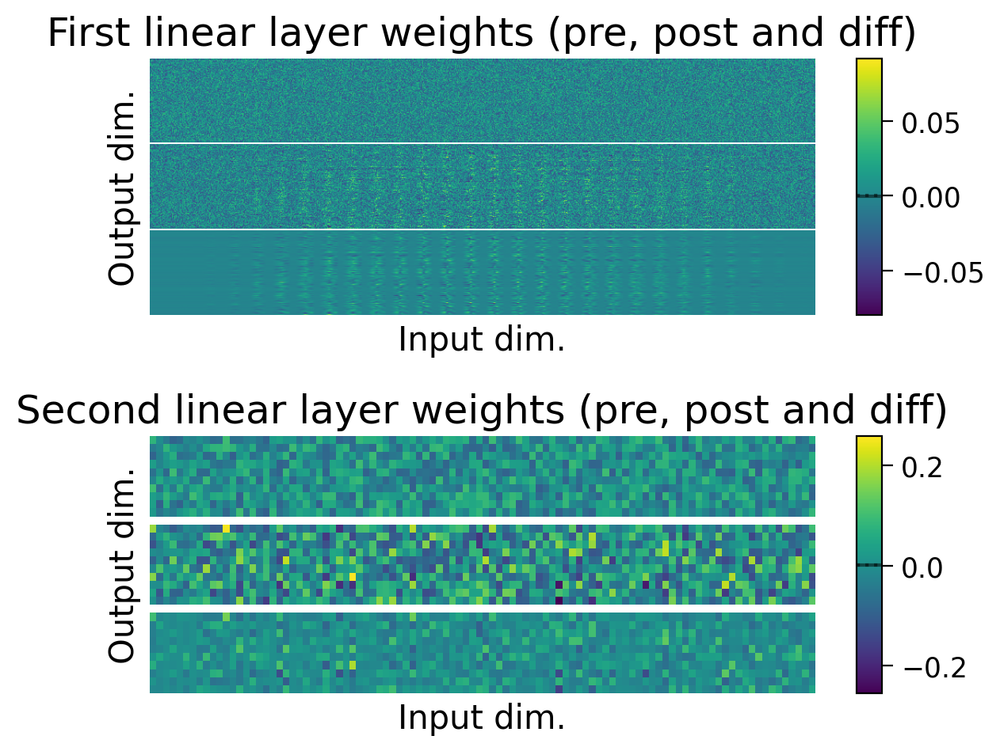

In [ ]:
plot_results(MLP_results_dict_10cls);
plot_scores_per_class(MLP_results_dict_10cls);
plot_examples(valid_loader.dataset, MLP=MLP_10cls);
plot_weights(MLP=MLP_10cls);

 12%|█▎        | 1/8 [00:02<00:20,  2.89s/it]

Epoch 1/8
Train Loss: 0.6878, Train Accuracy: 46.05%
Valid Loss: 0.6889, Valid Accuracy: 45.86%


 25%|██▌       | 2/8 [00:05<00:16,  2.69s/it]

Epoch 2/8
Train Loss: 0.2426, Train Accuracy: 98.19%
Valid Loss: 0.0842, Valid Accuracy: 99.54%


 38%|███▊      | 3/8 [00:07<00:11,  2.38s/it]

Epoch 3/8
Train Loss: 0.0569, Train Accuracy: 99.58%
Valid Loss: 0.0409, Valid Accuracy: 99.62%


 50%|█████     | 4/8 [00:09<00:08,  2.21s/it]

Epoch 4/8
Train Loss: 0.0330, Train Accuracy: 99.58%
Valid Loss: 0.0288, Valid Accuracy: 99.62%


 62%|██████▎   | 5/8 [00:11<00:06,  2.13s/it]

Epoch 5/8
Train Loss: 0.0242, Train Accuracy: 99.64%
Valid Loss: 0.0235, Valid Accuracy: 99.62%


 75%|███████▌  | 6/8 [00:13<00:04,  2.16s/it]

Epoch 6/8
Train Loss: 0.0197, Train Accuracy: 99.66%
Valid Loss: 0.0205, Valid Accuracy: 99.62%


 88%|████████▊ | 7/8 [00:16<00:02,  2.32s/it]

Epoch 7/8
Train Loss: 0.0169, Train Accuracy: 99.70%
Valid Loss: 0.0181, Valid Accuracy: 99.62%


100%|██████████| 8/8 [00:18<00:00,  2.29s/it]

Epoch 8/8
Train Loss: 0.0150, Train Accuracy: 99.70%
Valid Loss: 0.0167, Valid Accuracy: 99.62%


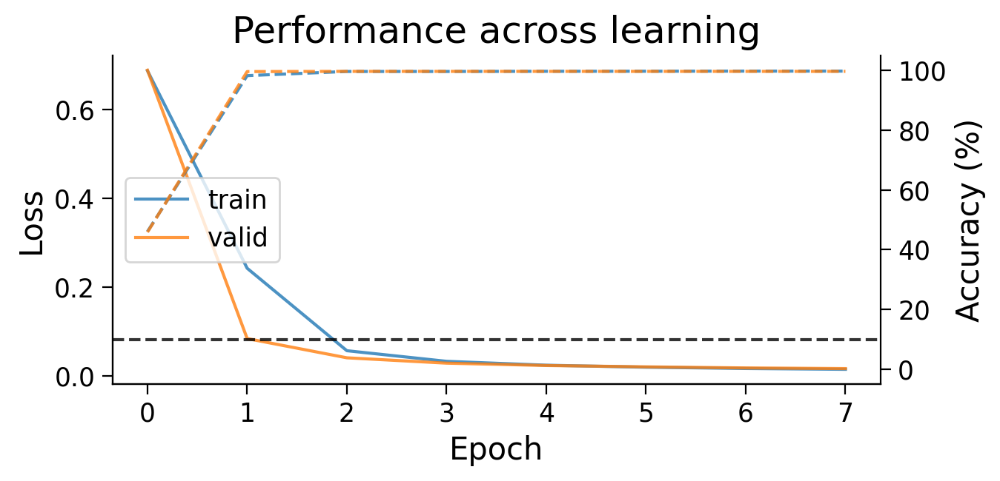

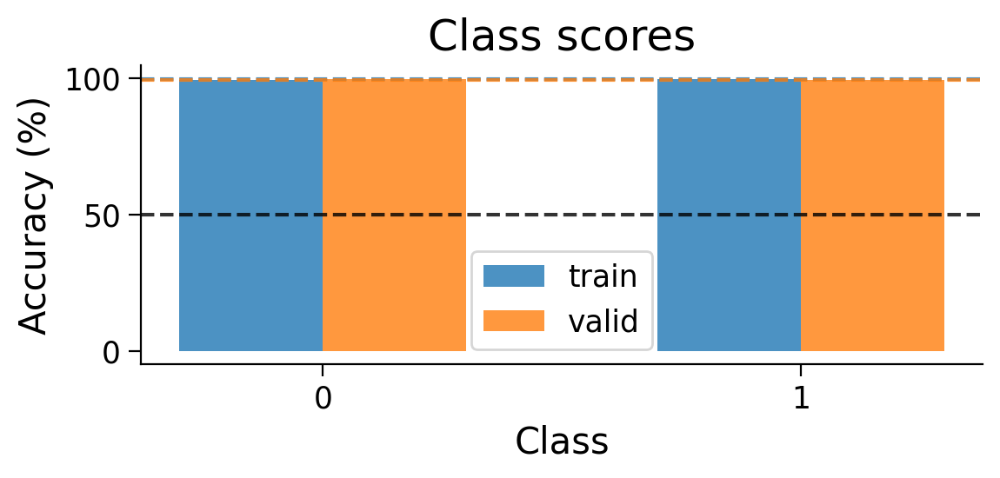

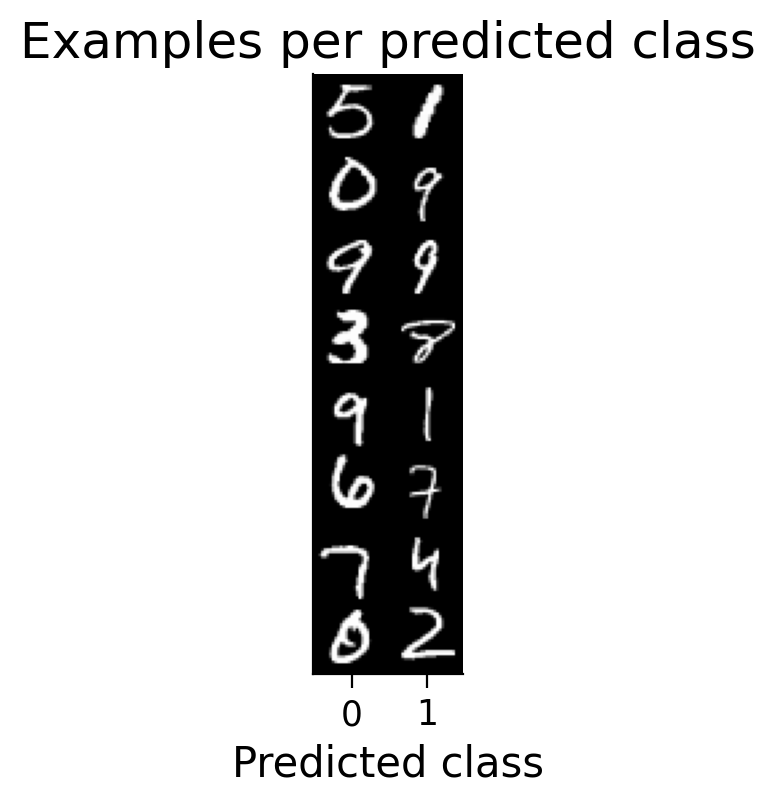

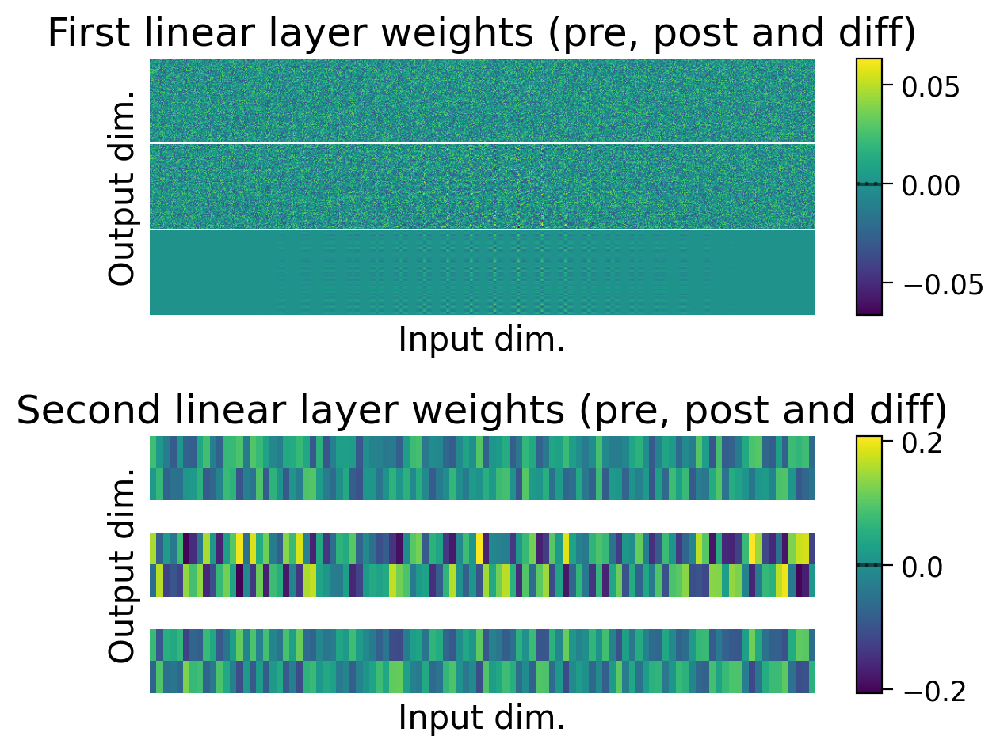

In [ ]:
MLP_2cls = MultiLayerPerceptron(
    num_hidden=NUM_HIDDEN,
    activation_type=ACTIVATION,
    bias=BIAS,
    num_outputs=2
    )


LR = 0.01
backprop_optimizer_2cls = BasicOptimizer(MLP_2cls.parameters(), lr=LR)

MLP_results_dict_2cls = train_model(
    MLP_2cls,Technische
    train_loader_2cls,
    valid_loader_2cls,
    optimizer=backprop_optimizer_2cls,
    num_epochs=NUM_EPOCHS
    )
plot_results(MLP_results_dict_2cls);
plot_scores_per_class(MLP_results_dict_2cls, num_classes=2);
plot_examples(valid_loader.dataset, MLP=MLP_2cls, num_classes=2);
plot_weights(MLP=MLP_2cls);

## Hebbian MLP

### Hebbian rule

In [ ]:
class HebbianFunction(torch.autograd.Function):
  """
  Gradient computing function class for Hebbian learning.
  """

  @staticmethod
  def forward(context, input, weight, bias=None, nonlinearity=None, target=None):
    """
    Forward pass method for the layer. Computes the output of the layer and
    stores variables needed for the backward pass.

    Arguments:
    - context (torch context): context in which variables can be stored for
      the backward pass.
    - input (torch tensor): input to the layer.
    - weight (torch tensor): layer weights.
    - bias (torch tensor, optional): layer biases.
    - nonlinearity (torch functional, optional): nonlinearity for the layer.
    - target (torch tensor, optional): layer target, if applicable.

    Returns:
    - output (torch tensor): layer output.
    """

    # compute the output for the layer (linear layer with non-linearity)
    output = input.mm(weight.t())
    if bias is not None:
      output += bias.unsqueeze(0).expand_as(output)
    if nonlinearity is not None:
      output = nonlinearity(output)

    # calculate the output to use for the backward pass
    output_for_update = output if target is None else target

    # store variables in the context for the backward pass
    context.save_for_backward(input, weight, bias, output_for_update)

    return output

  @staticmethod
  def backward(context, grad_output=None):
    """
    Backward pass method for the layer. Computes and returns the gradients for
    all variables passed to forward (returning None if not applicable).

    Arguments:
    - context (torch context): context in which variables can be stored for
      the backward pass.
    - input (torch tensor): input to the layer.
    - weight (torch tensor): layer weights.
    - bias (torch tensor, optional): layer biases.
    - nonlinearity (torch functional, optional): nonlinearity for the layer.
    - target (torch tensor, optional): layer target, if applicable.

    Returns:
    - grad_input (None): gradients for the input (None, since gradients are not
      backpropagated in Hebbian learning).
    - grad_weight (torch tensor): gradients for the weights.
    - grad_bias (torch tensor or None): gradients for the biases, if they aren't
      None.
    - grad_nonlinearity (None): gradients for the nonlinearity (None, since
      gradients do not apply to the non-linearities).
    - grad_target (None): gradients for the targets (None, since
      gradients do not apply to the targets).
    """

    input, weight, bias, output_for_update = context.saved_tensors
    grad_input = None
    grad_weight = None
    grad_bias = None
    grad_nonlinearity = None
    grad_target = None

    input_needs_grad = context.needs_input_grad[0]
    if input_needs_grad:
      pass

    weight_needs_grad = context.needs_input_grad[1]
    if weight_needs_grad:
      grad_weight = output_for_update.t().mm(input)
      grad_weight = grad_weight / len(input) # average across batch

      # center around 0
      grad_weight = grad_weight - grad_weight.mean(axis=0) # center around 0

      ## or apply Oja's rule (not compatible with clamping outputs to the targets!)
      # oja_subtract = output_for_update.pow(2).mm(grad_weight).mean(axis=0)
      # grad_weight = grad_weight - oja_subtract

      # take the negative, as the gradient will be subtracted
      grad_weight = -grad_weight

    if bias is not None:
      bias_needs_grad = context.needs_input_grad[2]
      if bias_needs_grad:
        grad_bias = output_for_update.mean(axis=0) # average across batch

        # center around 0
        grad_bias = grad_bias - grad_bias.mean()

        ## or apply an adaptation of Oja's rule for biases
        ## (not compatible with clamping outputs to the targets!)
        # oja_subtract = (output_for_update.pow(2) * bias).mean(axis=0)
        # grad_bias = grad_bias - oja_subtract

        # take the negative, as the gradient will be subtracted
        grad_bias = -grad_bias

    return grad_input, grad_weight, grad_bias, grad_nonlinearity, grad_target

### HebbianMLP definition

In [ ]:
class HebbianMultiLayerPerceptron(MultiLayerPerceptron):
    """
    Hebbian multilayer perceptron with one hidden layer.
    """

    def __init__(self, clamp_output=True, **kwargs):
        """
        Initializes a Hebbian multilayer perceptron object

        Arguments:
        - clamp_output (bool, optional): if True, outputs are clamped to targets,
          if available, when computing weight updates.
        """
        self.clamp_output = clamp_output
        super().__init__(**kwargs)
        self.activations = {}  # Initialize activations dictionary  <-- Added

    def forward(self, X, y=None):
        """
        Runs a forward pass through the network.

        Arguments:
        - X (torch.Tensor): Batch of input images.
        - y (torch.Tensor, optional): Batch of targets, stored for the backward
          pass to compute the gradients for the last layer.

        Returns:
        - y_pred (torch.Tensor): Predicted targets.
        """
        self.activations = {}  # Reset activations  <-- Added

        h = HebbianFunction.apply(
            X.reshape(-1, self.num_inputs),
            self.lin1.weight,
            self.lin1.bias,
            self.activation,
        )
        self.activations['hidden'] = h.detach().cpu().numpy()  # Record activations  <-- Added

        # if targets are provided, they can be used instead of the last layer's
        # output to train the last layer.
        if y is None or not self.clamp_output:
            targets = None
        else:
            targets = torch.nn.functional.one_hot(
                y, num_classes=self.num_outputs
            ).float()

        y_pred = HebbianFunction.apply(
            h,
            self.lin2.weight,
            self.lin2.bias,
            self.softmax,
            targets
        )
        self.activations['output'] = y_pred.detach().cpu().numpy()  # Record activations  <-- Added

        return y_pred


## Evaluation on MLP

#### Training HebbianMLP without targets on 2-class task

 10%|█         | 1/10 [00:01<00:17,  1.99s/it]

Epoch 1/10
Train Loss: 0.7205, Train Accuracy: 53.75%
Valid Loss: 0.7186, Valid Accuracy: 53.91%


 20%|██        | 2/10 [00:04<00:16,  2.07s/it]

Epoch 2/10
Train Loss: 0.7305, Train Accuracy: 53.75%
Valid Loss: 0.7389, Valid Accuracy: 53.91%


 30%|███       | 3/10 [00:06<00:16,  2.33s/it]

Epoch 3/10
Train Loss: 0.7472, Train Accuracy: 53.75%
Valid Loss: 0.7497, Valid Accuracy: 53.91%


 40%|████      | 4/10 [00:09<00:14,  2.35s/it]

Epoch 4/10
Train Loss: 0.7539, Train Accuracy: 53.75%
Valid Loss: 0.7554, Valid Accuracy: 53.91%


 50%|█████     | 5/10 [00:11<00:11,  2.24s/it]

Epoch 5/10
Train Loss: 0.7679, Train Accuracy: 53.75%
Valid Loss: 0.7840, Valid Accuracy: 53.91%


 60%|██████    | 6/10 [00:13<00:08,  2.18s/it]

Epoch 6/10
Train Loss: 0.8292, Train Accuracy: 53.75%
Valid Loss: 0.8784, Valid Accuracy: 53.91%


 70%|███████   | 7/10 [00:15<00:06,  2.14s/it]

Epoch 7/10
Train Loss: 0.9638, Train Accuracy: 53.75%
Valid Loss: 1.0538, Valid Accuracy: 53.91%


 80%|████████  | 8/10 [00:17<00:04,  2.13s/it]

Epoch 8/10
Train Loss: 1.1776, Train Accuracy: 53.75%
Valid Loss: 1.2933, Valid Accuracy: 53.91%


 90%|█████████ | 9/10 [00:20<00:02,  2.38s/it]

Epoch 9/10
Train Loss: 1.4403, Train Accuracy: 53.75%
Valid Loss: 1.5751, Valid Accuracy: 53.91%


100%|██████████| 10/10 [00:22<00:00,  2.25s/it]

Epoch 10/10
Train Loss: 1.7338, Train Accuracy: 53.75%
Valid Loss: 1.8816, Valid Accuracy: 53.91%


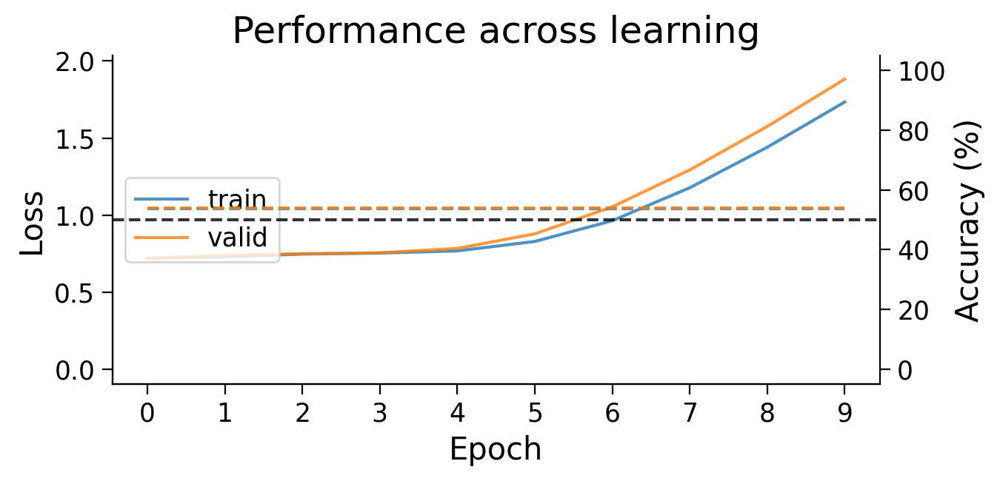

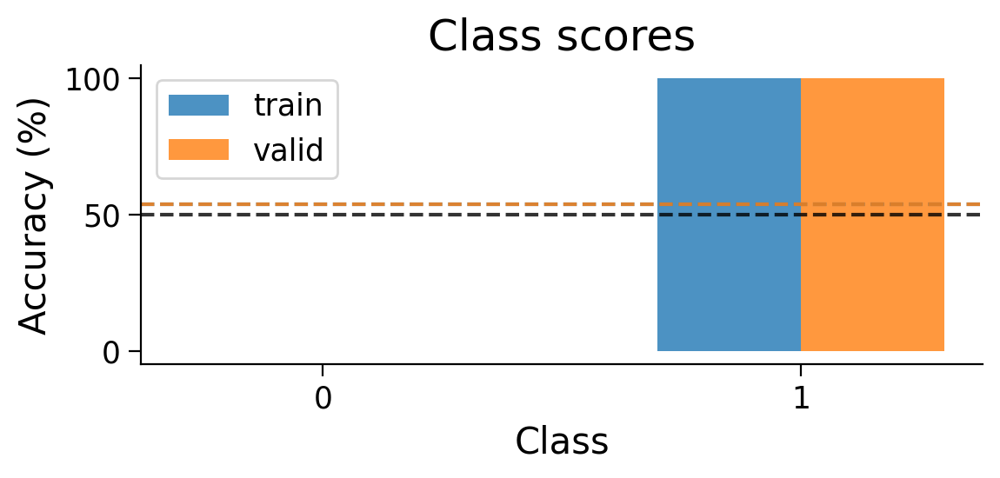

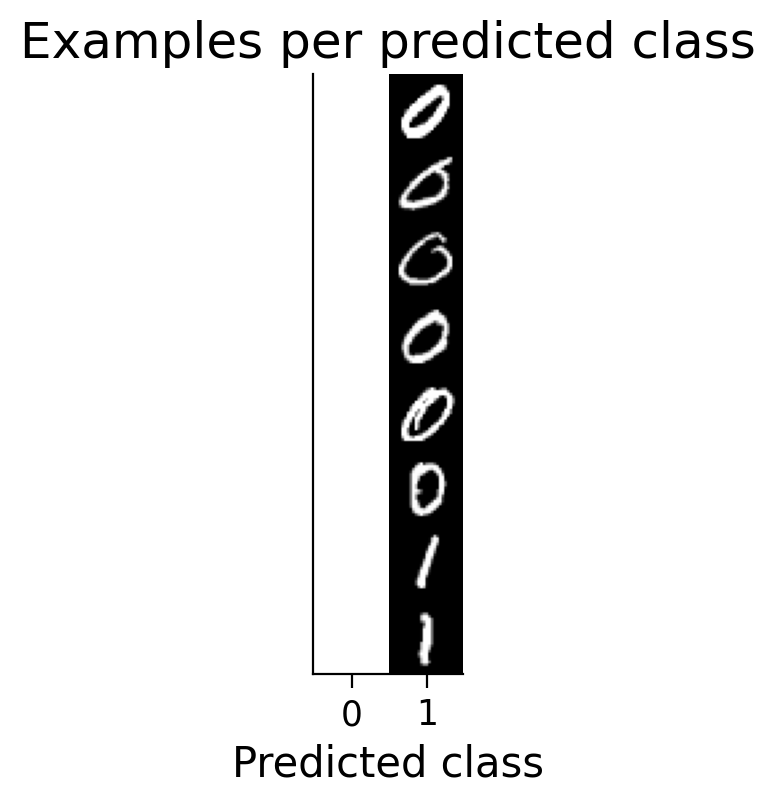

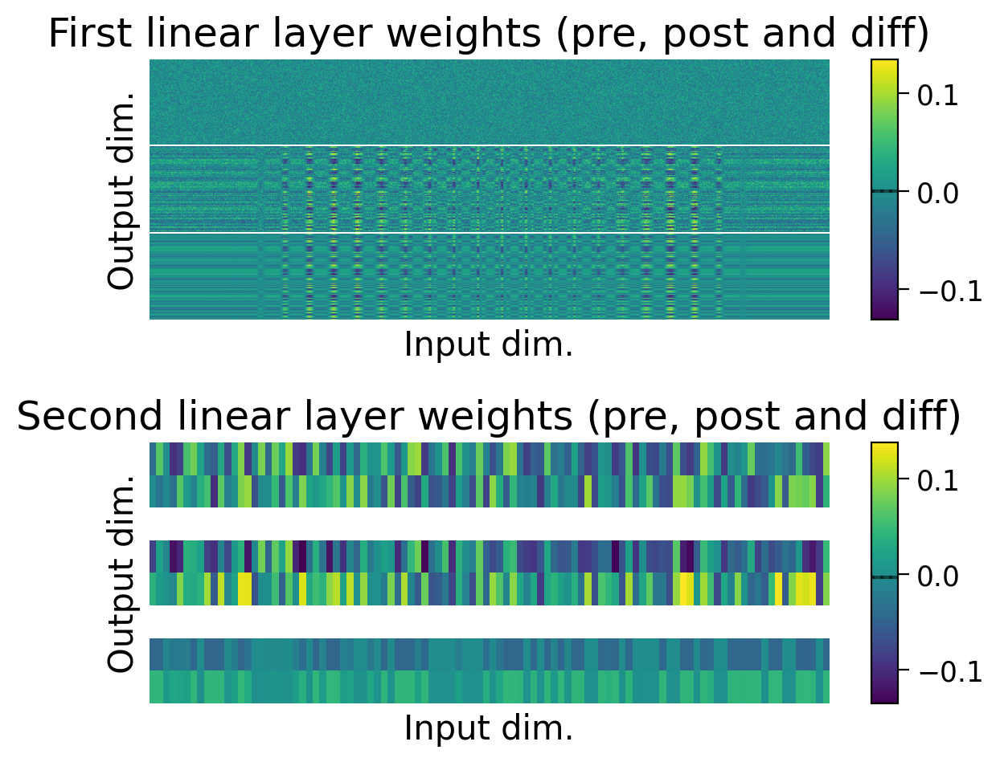

In [ ]:
HEBB_LR = 1e-4 # lower, since Hebbian gradients are much bigger than backprop gradients

HebbianMLP_2cls = HebbianMultiLayerPerceptron(
    num_hidden=NUM_HIDDEN,
    num_outputs=2,
    clamp_output=False,
)

Hebb_optimizer_2cls = BasicOptimizer(HebbianMLP_2cls.parameters(), lr=HEBB_LR)

Hebb_results_dict_2cls = train_model(
    HebbianMLP_2cls,
    train_loader_2cls,
    valid_loader_2cls,
    Hebb_optimizer_2cls,
    num_epochs=10
    );

plot_results(Hebb_results_dict_2cls, num_classes=2)
plot_scores_per_class(Hebb_results_dict_2cls, num_classes=2)
plot_examples(valid_loader_2cls.dataset, MLP=HebbianMLP_2cls, num_classes=2)
plot_weights(HebbianMLP_2cls);

#### Training HebbianMLP with targets on 10-class task

 12%|█▎        | 1/8 [00:09<01:07,  9.71s/it]

Epoch 1/8
Train Loss: 2.3216, Train Accuracy: 15.89%
Valid Loss: 2.3201, Valid Accuracy: 16.72%


 25%|██▌       | 2/8 [00:19<00:59,  9.94s/it]

Epoch 2/8
Train Loss: 2.3225, Train Accuracy: 16.05%
Valid Loss: 2.3220, Valid Accuracy: 16.89%


 38%|███▊      | 3/8 [00:30<00:51, 10.32s/it]

Epoch 3/8
Train Loss: 2.3245, Train Accuracy: 16.30%
Valid Loss: 2.3243, Valid Accuracy: 17.17%


 50%|█████     | 4/8 [00:41<00:41, 10.49s/it]

Epoch 4/8
Train Loss: 2.3270, Train Accuracy: 16.57%
Valid Loss: 2.3272, Valid Accuracy: 17.27%


 62%|██████▎   | 5/8 [00:52<00:31, 10.61s/it]

Epoch 5/8
Train Loss: 2.3304, Train Accuracy: 16.80%
Valid Loss: 2.3309, Valid Accuracy: 17.32%


 75%|███████▌  | 6/8 [01:02<00:21, 10.64s/it]

Epoch 6/8
Train Loss: 2.3348, Train Accuracy: 16.86%
Valid Loss: 2.3358, Valid Accuracy: 17.49%


 88%|████████▊ | 7/8 [01:12<00:10, 10.43s/it]

Epoch 7/8
Train Loss: 2.3402, Train Accuracy: 16.97%
Valid Loss: 2.3422, Valid Accuracy: 17.44%


100%|██████████| 8/8 [01:23<00:00, 10.44s/it]

Epoch 8/8
Train Loss: 2.3475, Train Accuracy: 16.93%
Valid Loss: 2.3505, Valid Accuracy: 17.17%


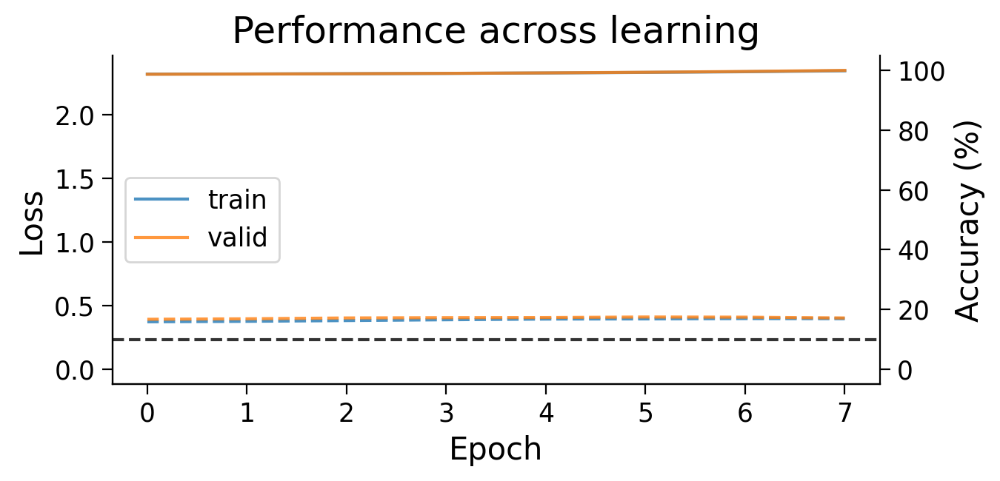

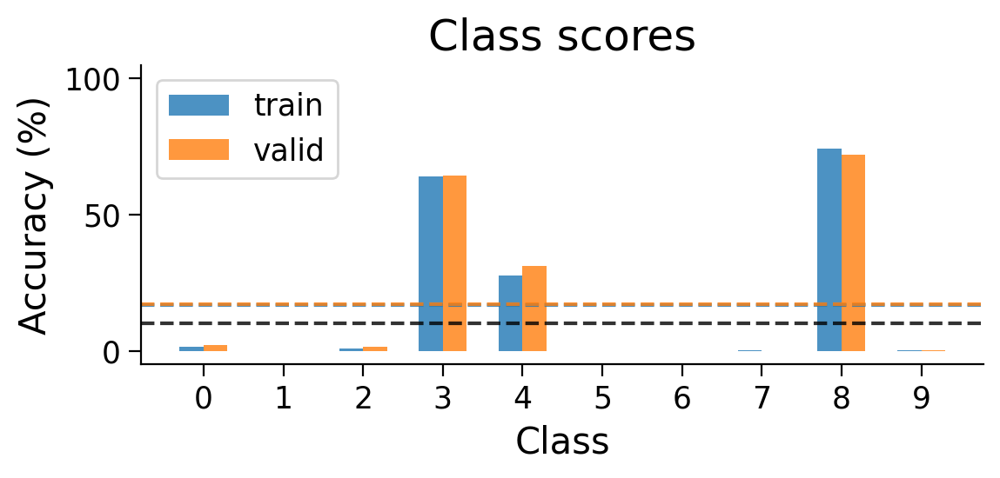

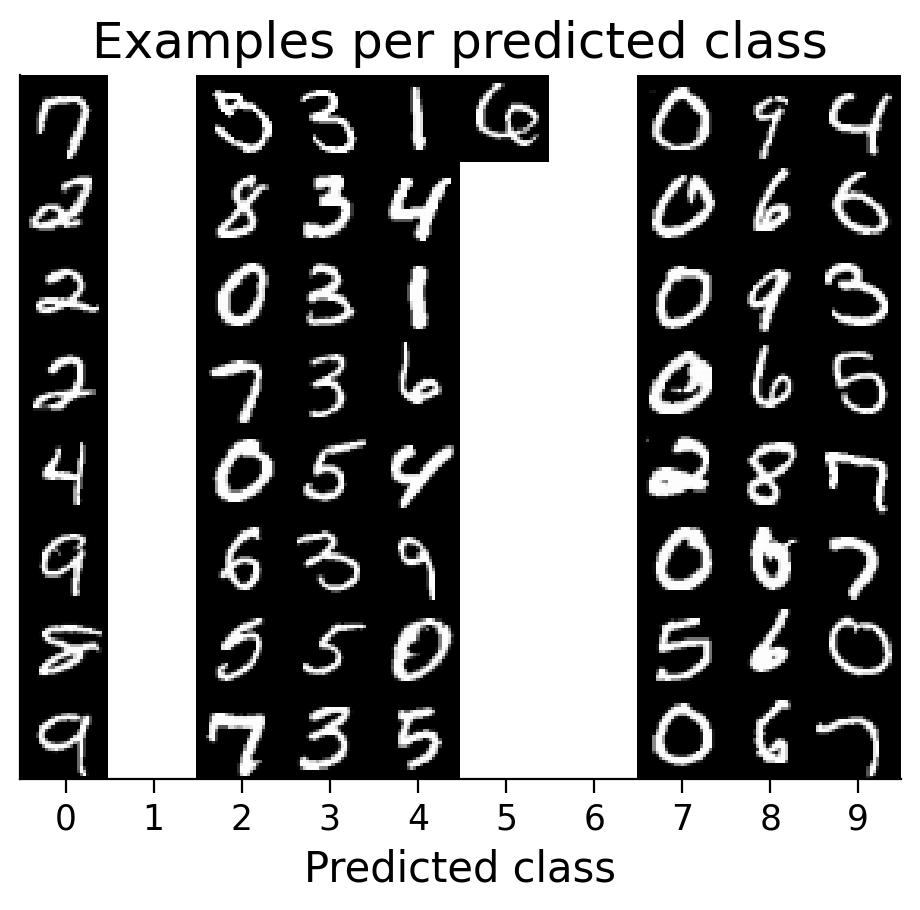

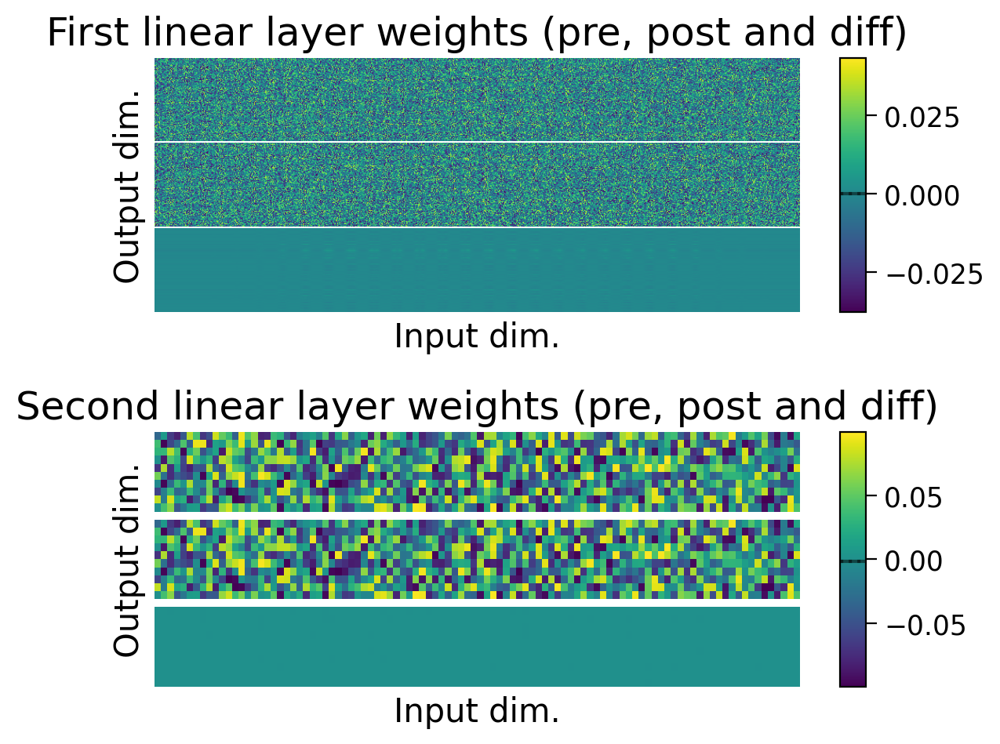

In [ ]:
HEBB_LR = 1e-6 # lower, since Hebbian gradients are much bigger than backprop gradients

HebbianMLP_10cls = HebbianMultiLayerPerceptron(
    num_hidden=NUM_HIDDEN,
    num_outputs=10,
    clamp_output=True,
    activation_type='relu'
)

Hebb_optimizer_10cls = BasicOptimizer(HebbianMLP_10cls.parameters(), lr=HEBB_LR)

Hebb_results_dict_10cls = train_model(
    HebbianMLP_10cls,
    train_loader,
    valid_loader,
    Hebb_optimizer_10cls,
    num_epochs=8
    );

plot_results(Hebb_results_dict_10cls, num_classes=10)
plot_scores_per_class(Hebb_results_dict_10cls, num_classes=10)
plot_examples(valid_loader.dataset, MLP=HebbianMLP_10cls, num_classes=10)
plot_weights(HebbianMLP_10cls);

#### Training HebbianMLP with targets on 2-class task

 10%|█         | 1/10 [00:01<00:16,  1.78s/it]

Epoch 1/10
Train Loss: 0.7910, Train Accuracy: 53.75%
Valid Loss: 0.7875, Valid Accuracy: 53.91%


 20%|██        | 2/10 [00:03<00:16,  2.03s/it]

Epoch 2/10
Train Loss: 0.7911, Train Accuracy: 53.75%
Valid Loss: 0.7887, Valid Accuracy: 53.91%


 30%|███       | 3/10 [00:06<00:15,  2.16s/it]

Epoch 3/10
Train Loss: 0.7948, Train Accuracy: 53.75%
Valid Loss: 0.7921, Valid Accuracy: 53.91%


 40%|████      | 4/10 [00:08<00:12,  2.05s/it]

Epoch 4/10
Train Loss: 0.7950, Train Accuracy: 53.75%
Valid Loss: 0.7888, Valid Accuracy: 53.91%


 50%|█████     | 5/10 [00:10<00:09,  1.99s/it]

Epoch 5/10
Train Loss: 0.7836, Train Accuracy: 53.75%
Valid Loss: 0.7700, Valid Accuracy: 53.91%


 60%|██████    | 6/10 [00:11<00:07,  1.95s/it]

Epoch 6/10
Train Loss: 0.7623, Train Accuracy: 53.75%
Valid Loss: 0.7530, Valid Accuracy: 53.91%


 70%|███████   | 7/10 [00:13<00:05,  1.92s/it]

Epoch 7/10
Train Loss: 0.7530, Train Accuracy: 53.75%
Valid Loss: 0.7504, Valid Accuracy: 53.91%


 80%|████████  | 8/10 [00:15<00:03,  1.96s/it]

Epoch 8/10
Train Loss: 0.7567, Train Accuracy: 53.75%
Valid Loss: 0.7546, Valid Accuracy: 53.91%


 90%|█████████ | 9/10 [00:18<00:02,  2.11s/it]

Epoch 9/10
Train Loss: 0.7604, Train Accuracy: 53.75%
Valid Loss: 0.7588, Valid Accuracy: 53.91%


100%|██████████| 10/10 [00:20<00:00,  2.01s/it]

Epoch 10/10
Train Loss: 0.7632, Train Accuracy: 53.75%
Valid Loss: 0.7612, Valid Accuracy: 53.91%


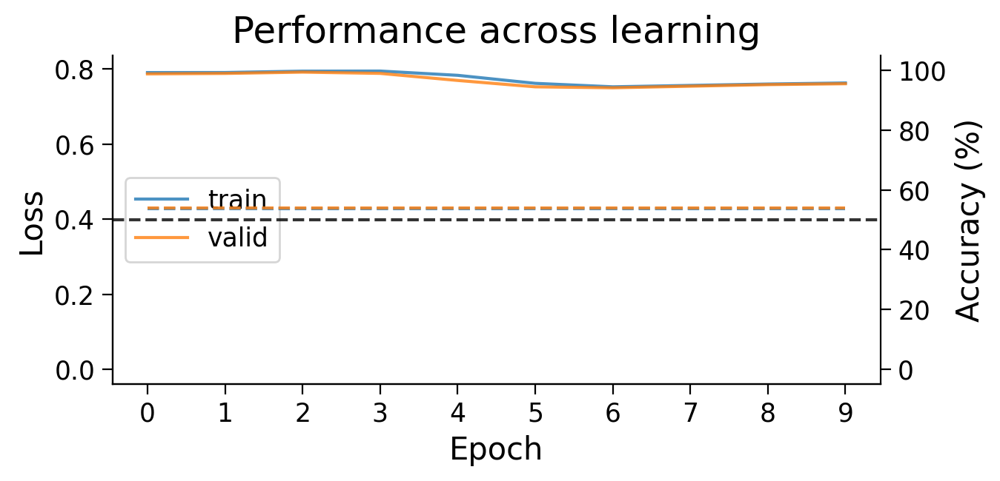

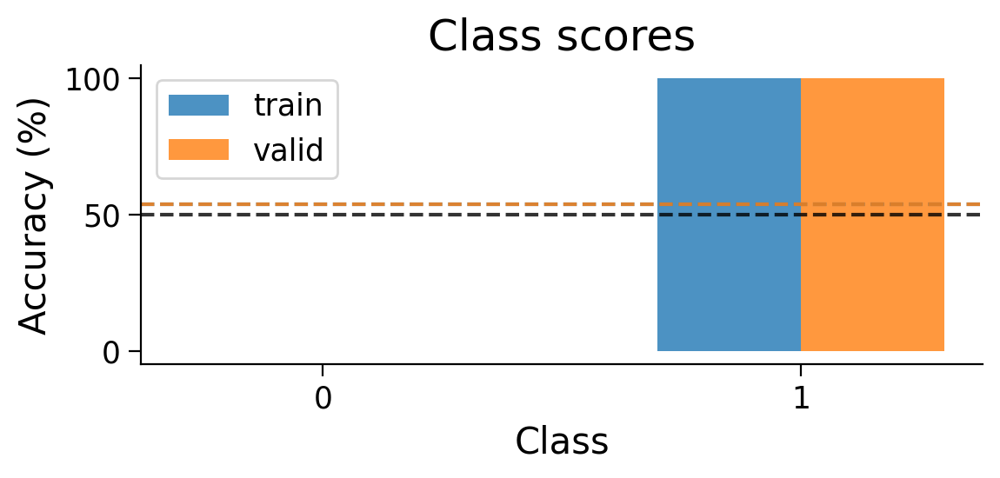

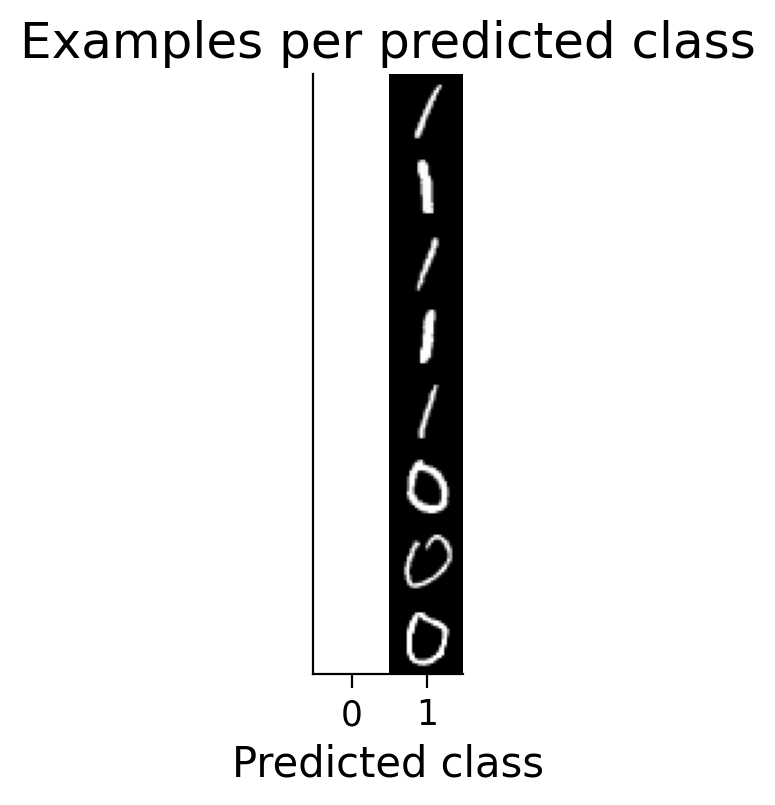

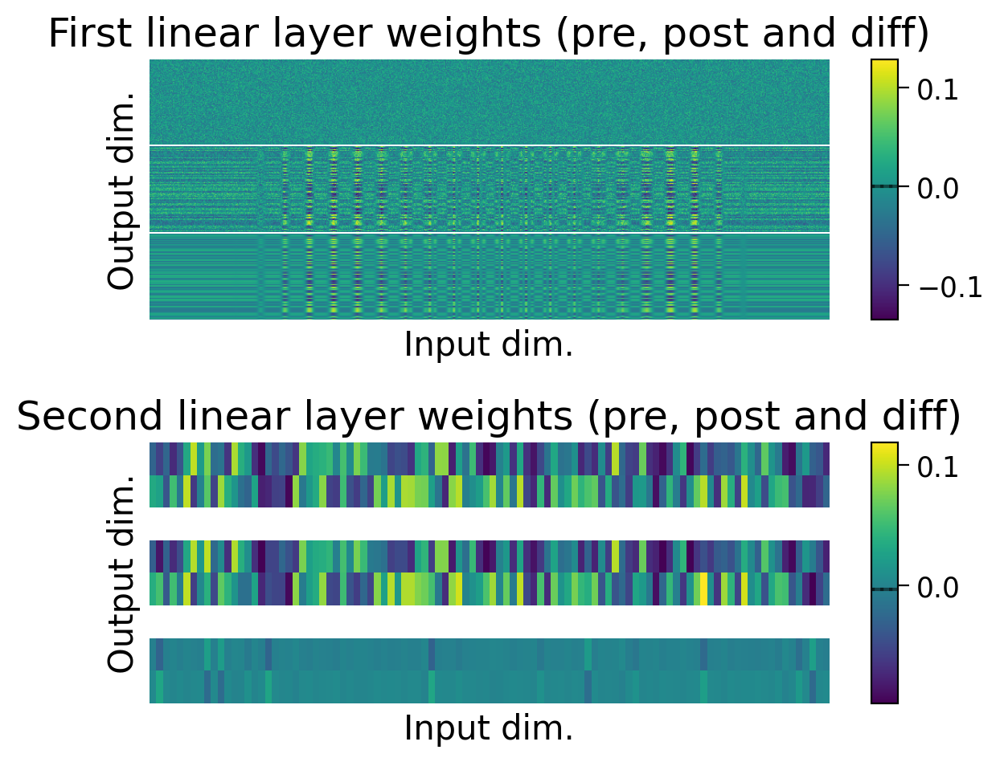

In [ ]:
HebbianMLP_2cls = HebbianMultiLayerPerceptron(
    num_hidden=NUM_HIDDEN,
    num_outputs=2,
    clamp_output=True, # clamp output to targets
)

Hebb_optimizer_2cls = BasicOptimizer(HebbianMLP_2cls.parameters(), lr=HEBB_LR)

Hebb_results_dict_2cls = train_model(
    HebbianMLP_2cls,
    train_loader_2cls,
    valid_loader_2cls,
    Hebb_optimizer_2cls,
    num_epochs=10
    );

plot_results(Hebb_results_dict_2cls, num_classes=2)
plot_scores_per_class(Hebb_results_dict_2cls, num_classes=2)
plot_examples(valid_loader_2cls.dataset, MLP=HebbianMLP_2cls, num_classes=2)
plot_weights(HebbianMLP_2cls);

#### Training MLP and HebbianMLP on 3-class task (supervised)

In [ ]:
#@markdown `train_model_extended`: Initializes model and optimizer, restricts datasets to
#@markdown specified classes, trains model. Returns trained model and results dictionary.

def train_model_extended(model_type="backprop", keep_num_classes="all", lr=LR,
                         num_epochs=5, partial_backprop=False,
                         num_hidden=NUM_HIDDEN, bias=BIAS,
                         batch_size=BATCH_SIZE, plot_distribution=False):
  """
  Initializes model and optimizer, restricts datasets to specified classes and
  trains the model. Returns the trained model and results dictionary.

  Arguments:
  - model_type (str, optional): model to initialize ("backprop" or "Hebbian")
  - keep_num_classes (str or int, optional): number of classes to keep (from 0)
  - lr (float or list, optional): learning rate for both or each layer
  - num_epochs (int, optional): number of epochs to train model.
  - partial_backprop (bool, optional): if True, backprop is used to train the
    final Hebbian learning model.
  - num_hidden (int, optional): number of hidden units in the hidden layer
  - bias (bool, optional): if True, each linear layer will have biases in
      addition to weights.
  - batch_size (int, optional): batch size for dataloaders.
  - plot_distribution (bool, optional): if True, dataset class distributions
    are plotted.

  Returns:
  - MLP (torch module): Model
  - results_dict (dict): Dictionary storing results across epochs on training
    and validation data.
  """

  if isinstance(keep_num_classes, str):
    if keep_num_classes == "all":
      num_classes = 10
      use_train_set = train_set
      use_valid_set = valid_set
    else:
      raise ValueError("If 'keep_classes' is a string, it should be 'all'.")
  else:
    num_classes = int(keep_num_classes)
    use_train_set = restrict_classes(train_set, np.arange(keep_num_classes))
    use_valid_set = restrict_classes(valid_set, np.arange(keep_num_classes))

  if plot_distribution:
    plot_class_distribution(use_train_set, use_valid_set)

  train_loader = torch.utils.data.DataLoader(
      use_train_set, batch_size=batch_size, shuffle=True
      )
  valid_loader = torch.utils.data.DataLoader(
      use_valid_set, batch_size=batch_size, shuffle=False
        )

  model_params = {
      "num_hidden": num_hidden,
      "num_outputs": num_classes,
      "bias": bias,
  }

  if model_type.lower() == "backprop":
    Model = MultiLayerPerceptron
  elif model_type.lower() == "hebbian":
    if partial_backprop:
      Model = HebbianBackpropMultiLayerPerceptron
    else:
      Model = HebbianMultiLayerPerceptron
      model_params["clamp_output"] = True
  else:
    raise ValueError(
        f"Got {model_type} model type, but expected 'backprop' or 'hebbian'."
        )

  MLP = Model(**model_params)

  if isinstance(lr, list):
    if len(lr) != 2:
      raise ValueError("If 'lr' is a list, it must be of length 2.")
    optimizer = BasicOptimizer([
        {"params": MLP.lin1.parameters(), "lr": lr[0]},
        {"params": MLP.lin2.parameters(), "lr": lr[1]},
    ])
  else:
    optimizer = BasicOptimizer(MLP.parameters(), lr=lr)


  results_dict = train_model(
      MLP,
      train_loader,
      valid_loader,
      optimizer,
      num_epochs=num_epochs
      )

  return MLP, results_dict

 20%|██        | 1/5 [00:02<00:10,  2.63s/it]

Epoch 1/5
Train Loss: 1.1660, Train Accuracy: 36.42%
Valid Loss: 1.1674, Valid Accuracy: 36.41%


 40%|████      | 2/5 [00:05<00:08,  2.87s/it]

Epoch 2/5
Train Loss: 0.5437, Train Accuracy: 88.56%
Valid Loss: 0.2729, Valid Accuracy: 95.29%


 60%|██████    | 3/5 [00:08<00:05,  3.00s/it]

Epoch 3/5
Train Loss: 0.2090, Train Accuracy: 96.03%
Valid Loss: 0.1524, Valid Accuracy: 97.15%


 80%|████████  | 4/5 [00:11<00:02,  2.89s/it]

Epoch 4/5
Train Loss: 0.1398, Train Accuracy: 96.60%
Valid Loss: 0.1136, Valid Accuracy: 97.93%


100%|██████████| 5/5 [00:14<00:00,  2.85s/it]

Epoch 5/5
Train Loss: 0.1119, Train Accuracy: 97.14%
Valid Loss: 0.0943, Valid Accuracy: 97.98%


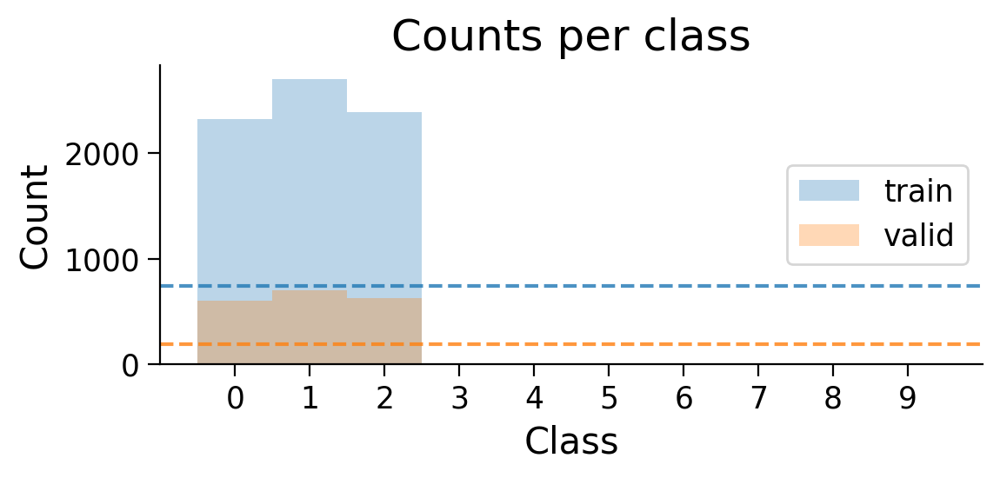

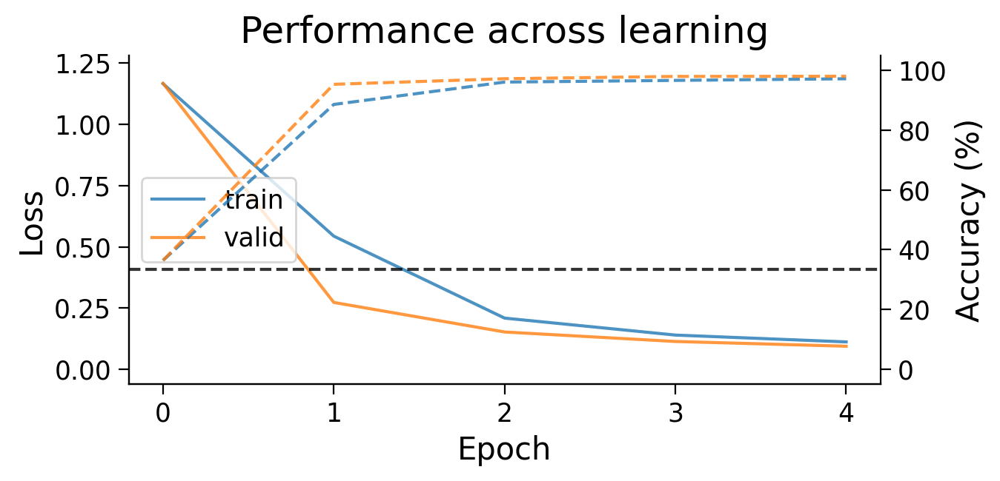

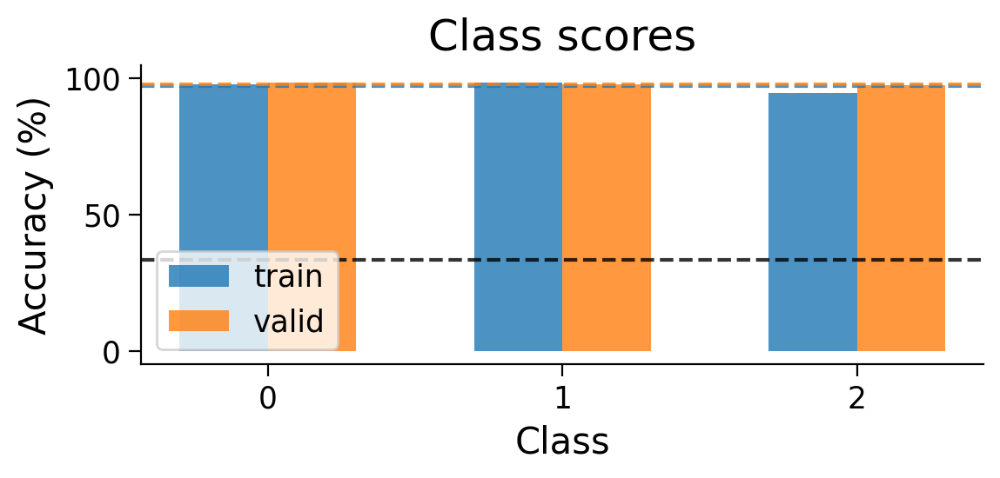

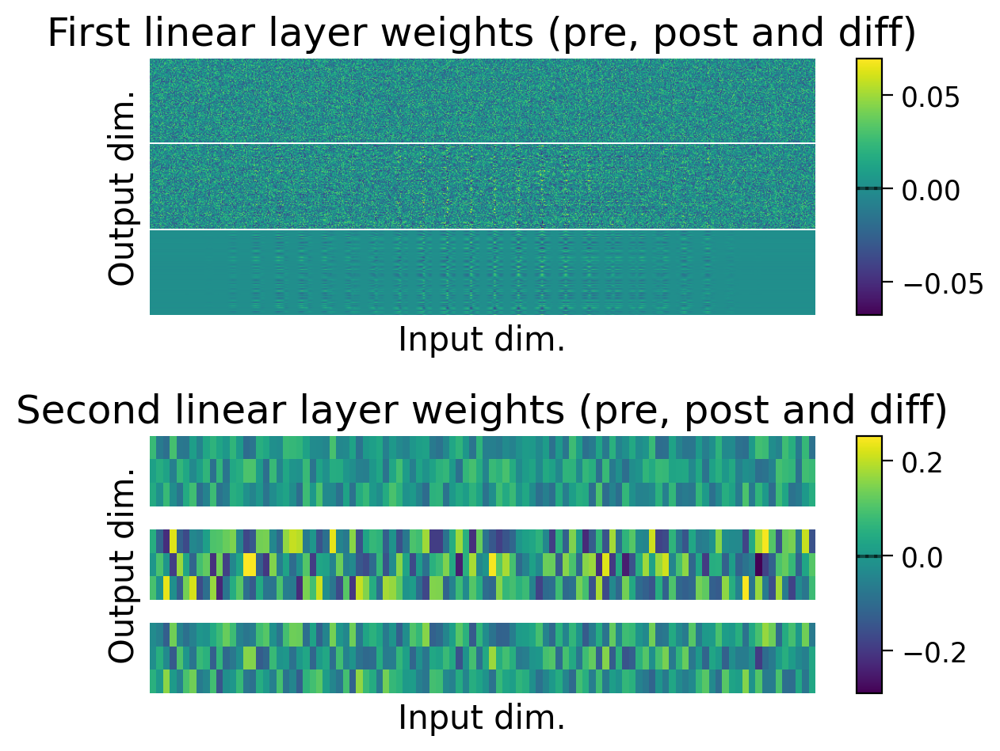

In [ ]:
MLP_3cls, results_dict_3cls = train_model_extended(
    model_type="backprop",
    keep_num_classes=3,
    num_epochs=5,
    lr=LR,
    plot_distribution=True,
)

plot_results(results_dict_3cls, num_classes=3)
plot_scores_per_class(results_dict_3cls, num_classes=3)
plot_weights(MLP_3cls);

  7%|▋         | 1/15 [00:05<01:12,  5.17s/it]

Epoch 1/15
Train Loss: 1.1132, Train Accuracy: 31.23%
Valid Loss: 1.1122, Valid Accuracy: 31.07%


 13%|█▎        | 2/15 [00:08<00:53,  4.11s/it]

Epoch 2/15
Train Loss: 1.1103, Train Accuracy: 29.08%
Valid Loss: 1.1067, Valid Accuracy: 24.75%


 20%|██        | 3/15 [00:11<00:42,  3.55s/it]

Epoch 3/15
Train Loss: 1.1050, Train Accuracy: 17.82%
Valid Loss: 1.1039, Valid Accuracy: 19.83%


 27%|██▋       | 4/15 [00:14<00:38,  3.53s/it]

Epoch 4/15
Train Loss: 1.1002, Train Accuracy: 36.61%
Valid Loss: 1.0949, Valid Accuracy: 45.16%


 33%|███▎      | 5/15 [00:19<00:39,  3.95s/it]

Epoch 5/15
Train Loss: 1.0870, Train Accuracy: 42.51%
Valid Loss: 1.0817, Valid Accuracy: 40.34%


 40%|████      | 6/15 [00:22<00:31,  3.54s/it]

Epoch 6/15
Train Loss: 1.0802, Train Accuracy: 36.65%
Valid Loss: 1.0816, Valid Accuracy: 34.13%


 47%|████▋     | 7/15 [00:25<00:26,  3.31s/it]

Epoch 7/15
Train Loss: 1.0865, Train Accuracy: 32.77%
Valid Loss: 1.0911, Valid Accuracy: 31.80%


 53%|█████▎    | 8/15 [00:28<00:22,  3.16s/it]

Epoch 8/15
Train Loss: 1.0945, Train Accuracy: 31.61%
Valid Loss: 1.0966, Valid Accuracy: 31.54%


 60%|██████    | 9/15 [00:31<00:19,  3.27s/it]

Epoch 9/15
Train Loss: 1.0980, Train Accuracy: 31.42%
Valid Loss: 1.0986, Valid Accuracy: 31.43%


 67%|██████▋   | 10/15 [00:34<00:15,  3.14s/it]

Epoch 10/15
Train Loss: 1.0988, Train Accuracy: 31.49%
Valid Loss: 1.0987, Valid Accuracy: 31.59%


 73%|███████▎  | 11/15 [00:37<00:12,  3.04s/it]

Epoch 11/15
Train Loss: 1.0983, Train Accuracy: 33.73%
Valid Loss: 1.0979, Valid Accuracy: 36.41%


 80%|████████  | 12/15 [00:40<00:08,  2.97s/it]

Epoch 12/15
Train Loss: 1.0975, Train Accuracy: 36.42%
Valid Loss: 1.0971, Valid Accuracy: 36.41%


 87%|████████▋ | 13/15 [00:43<00:06,  3.15s/it]

Epoch 13/15
Train Loss: 1.0969, Train Accuracy: 36.42%
Valid Loss: 1.0968, Valid Accuracy: 36.41%


 93%|█████████▎| 14/15 [00:46<00:03,  3.04s/it]

Epoch 14/15
Train Loss: 1.0968, Train Accuracy: 36.42%
Valid Loss: 1.0972, Valid Accuracy: 36.41%


100%|██████████| 15/15 [00:49<00:00,  3.28s/it]

Epoch 15/15
Train Loss: 1.0979, Train Accuracy: 36.42%
Valid Loss: 1.0982, Valid Accuracy: 36.41%


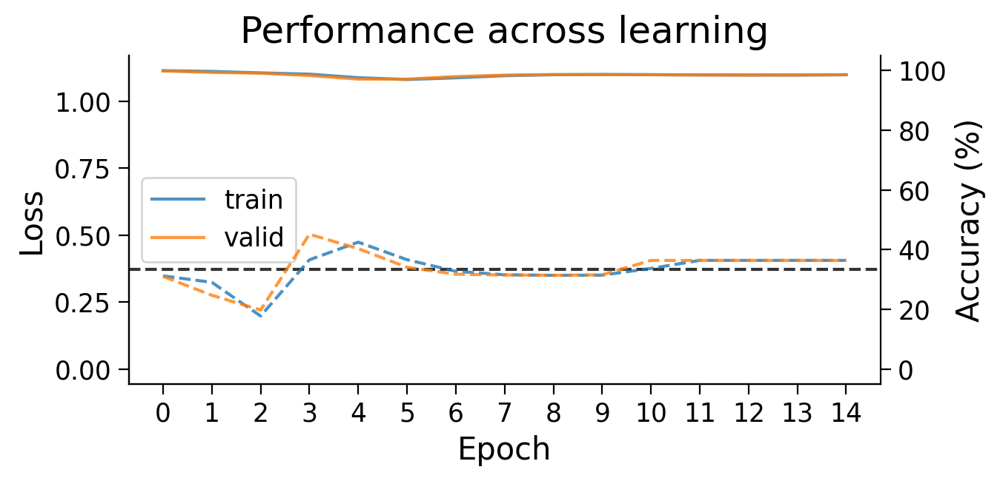

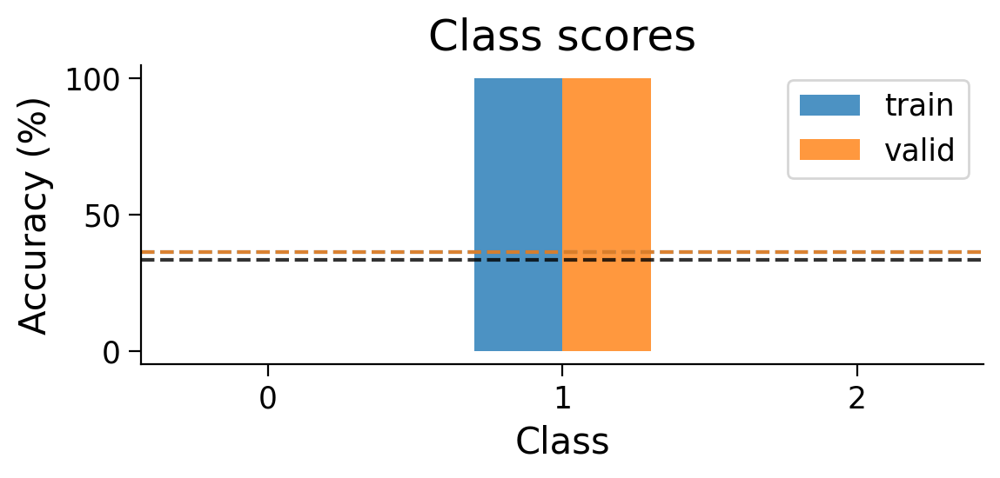

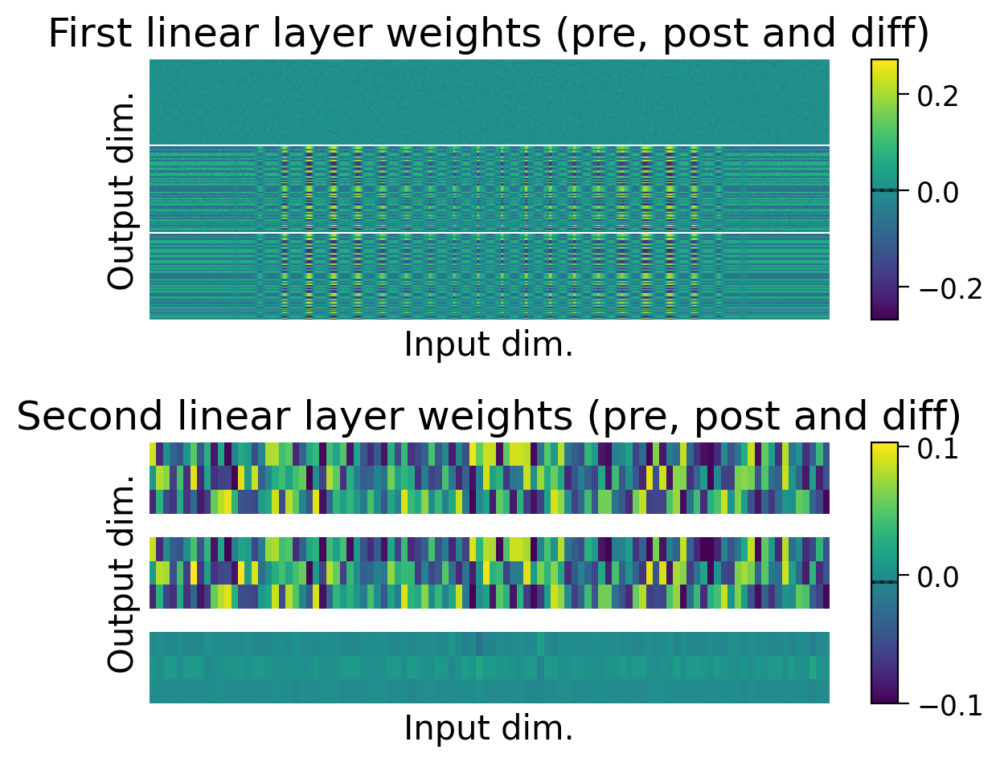

In [ ]:
HebbianMLP_3cls, Hebbian_results_dict_3cls = train_model_extended(
    model_type="hebbian",
    keep_num_classes=3,
    num_epochs=15,
    lr=HEBB_LR,
)

plot_results(Hebbian_results_dict_3cls, num_classes=3)
plot_scores_per_class(Hebbian_results_dict_3cls, num_classes=3)
plot_weights(HebbianMLP_3cls);

  7%|▋         | 1/15 [00:03<00:43,  3.10s/it]

Epoch 1/15
Train Loss: 1.1097, Train Accuracy: 36.42%
Valid Loss: 1.1072, Valid Accuracy: 36.41%


 13%|█▎        | 2/15 [00:06<00:41,  3.19s/it]

Epoch 2/15
Train Loss: 1.1045, Train Accuracy: 36.42%
Valid Loss: 1.1011, Valid Accuracy: 36.41%


 20%|██        | 3/15 [00:09<00:36,  3.03s/it]

Epoch 3/15
Train Loss: 1.0980, Train Accuracy: 36.42%
Valid Loss: 1.0904, Valid Accuracy: 36.41%


 27%|██▋       | 4/15 [00:13<00:38,  3.50s/it]

Epoch 4/15
Train Loss: 1.0898, Train Accuracy: 36.42%
Valid Loss: 1.0727, Valid Accuracy: 36.41%


 33%|███▎      | 5/15 [00:19<00:45,  4.57s/it]

Epoch 5/15
Train Loss: 1.0641, Train Accuracy: 36.42%
Valid Loss: 1.0500, Valid Accuracy: 36.41%


 40%|████      | 6/15 [00:22<00:35,  3.98s/it]

Epoch 6/15
Train Loss: 1.0475, Train Accuracy: 36.42%
Valid Loss: 1.0287, Valid Accuracy: 36.41%


 47%|████▋     | 7/15 [00:25<00:28,  3.62s/it]

Epoch 7/15
Train Loss: 1.0331, Train Accuracy: 36.42%
Valid Loss: 1.0141, Valid Accuracy: 36.41%


 53%|█████▎    | 8/15 [00:28<00:24,  3.49s/it]

Epoch 8/15
Train Loss: 1.0171, Train Accuracy: 36.42%
Valid Loss: 1.0107, Valid Accuracy: 36.41%


 60%|██████    | 9/15 [00:31<00:20,  3.38s/it]

Epoch 9/15
Train Loss: 1.0192, Train Accuracy: 36.42%
Valid Loss: 1.0188, Valid Accuracy: 36.41%


 67%|██████▋   | 10/15 [00:34<00:16,  3.20s/it]

Epoch 10/15
Train Loss: 1.0413, Train Accuracy: 36.42%
Valid Loss: 1.0429, Valid Accuracy: 36.41%


 73%|███████▎  | 11/15 [00:37<00:12,  3.07s/it]

Epoch 11/15
Train Loss: 1.0662, Train Accuracy: 36.42%
Valid Loss: 1.0791, Valid Accuracy: 36.41%


 80%|████████  | 12/15 [00:40<00:09,  3.04s/it]

Epoch 12/15
Train Loss: 1.1102, Train Accuracy: 36.42%
Valid Loss: 1.1345, Valid Accuracy: 36.41%


 87%|████████▋ | 13/15 [00:43<00:06,  3.13s/it]

Epoch 13/15
Train Loss: 1.1897, Train Accuracy: 36.42%
Valid Loss: 1.2113, Valid Accuracy: 36.41%


 93%|█████████▎| 14/15 [00:46<00:03,  3.02s/it]

Epoch 14/15
Train Loss: 1.2651, Train Accuracy: 36.42%
Valid Loss: 1.3054, Valid Accuracy: 36.41%


100%|██████████| 15/15 [00:49<00:00,  3.29s/it]

Epoch 15/15
Train Loss: 1.3665, Train Accuracy: 36.42%
Valid Loss: 1.4147, Valid Accuracy: 36.41%


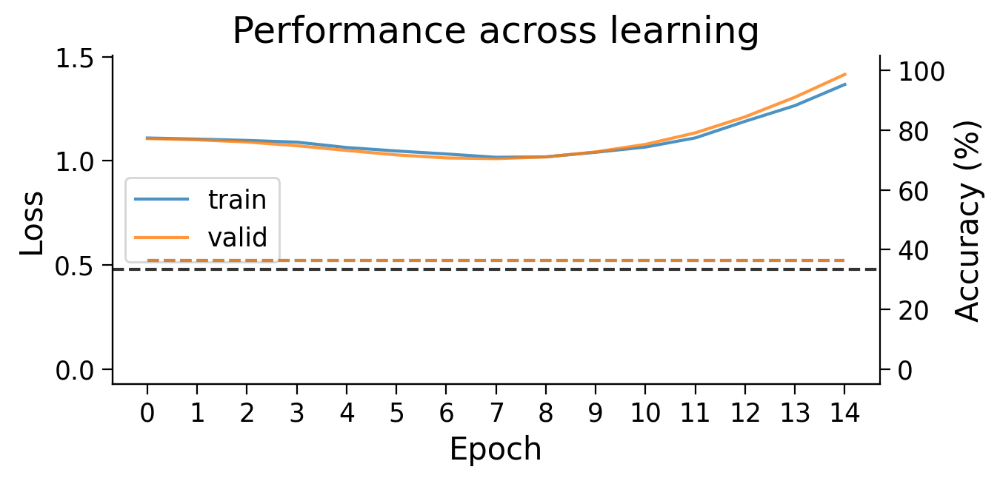

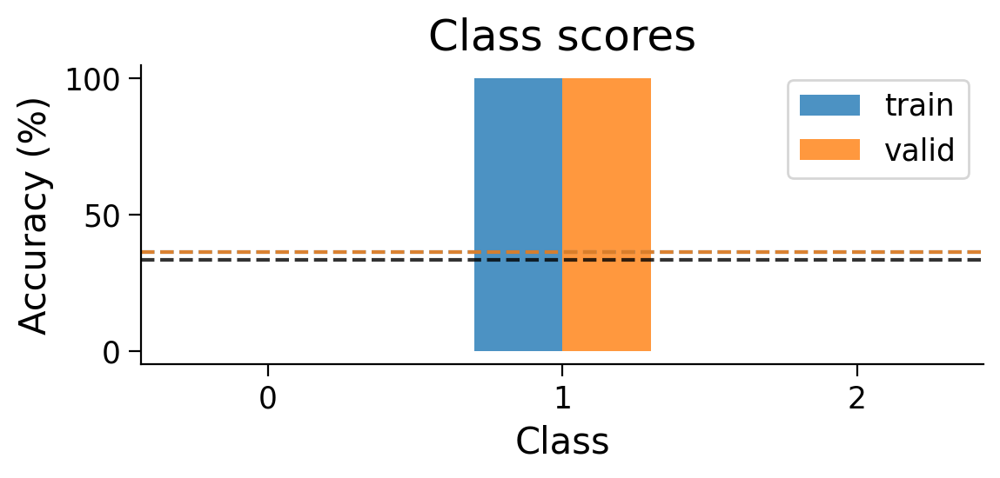

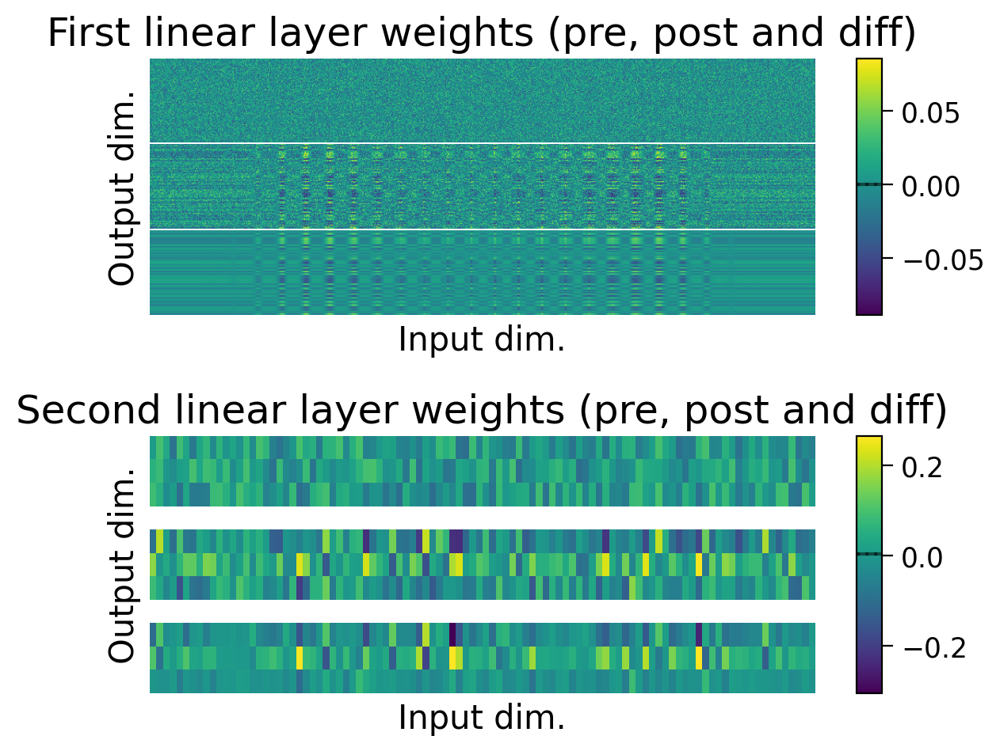

In [ ]:
HebbianMLP_3cls, Hebbian_results_dict_3cls = train_model_extended(
    model_type="hebbian",
    keep_num_classes=3,
    num_epochs=15,
    lr=[HEBB_LR / 4, HEBB_LR * 8], # learning rate for each layer
)

plot_results(Hebbian_results_dict_3cls, num_classes=3)
plot_scores_per_class(Hebbian_results_dict_3cls, num_classes=3)
plot_weights(HebbianMLP_3cls);

#### Hybid training: first layer with BP and second layer with Hebbian

In [ ]:
#@markdown `HebbianBackpropMultiLayerPerceptron()`: Class combining Hebbian learning and backpropagation.

class HebbianBackpropMultiLayerPerceptron(MultiLayerPerceptron):
  """
  Hybrid backprop/Hebbian multilayer perceptron with one hidden layer.
  """

  def forward(self, X, y=None):
    """
    Runs a forward pass through the network.

    Arguments:
    - X (torch.Tensor): Batch of input images.
    - y (torch.Tensor, optional): Batch of targets, not used here.

    Returns:
    - y_pred (torch.Tensor): Predicted targets.
    """

    # Hebbian layer
    h = HebbianFunction.apply(
        X.reshape(-1, self.num_inputs),
        self.lin1.weight,
        self.lin1.bias,
        self.activation,
    )

    # backprop layer
    y_pred = self.softmax(self.lin2(h))

    return y_pred

 20%|██        | 1/5 [00:09<00:38,  9.54s/it]

Epoch 1/5
Train Loss: 2.3699, Train Accuracy: 10.60%
Valid Loss: 2.3705, Valid Accuracy: 10.25%


 40%|████      | 2/5 [00:19<00:29,  9.83s/it]

Epoch 2/5
Train Loss: 2.2284, Train Accuracy: 28.87%
Valid Loss: 2.1290, Valid Accuracy: 39.29%


 60%|██████    | 3/5 [00:29<00:19,  9.90s/it]

Epoch 3/5
Train Loss: 2.0530, Train Accuracy: 52.51%
Valid Loss: 1.9860, Valid Accuracy: 48.31%


 80%|████████  | 4/5 [00:38<00:09,  9.66s/it]

Epoch 4/5
Train Loss: 1.9744, Train Accuracy: 54.82%
Valid Loss: 1.9815, Valid Accuracy: 43.24%


100%|██████████| 5/5 [00:49<00:00,  9.81s/it]

Epoch 5/5
Train Loss: 2.0125, Train Accuracy: 51.19%
Valid Loss: 2.0599, Valid Accuracy: 26.05%


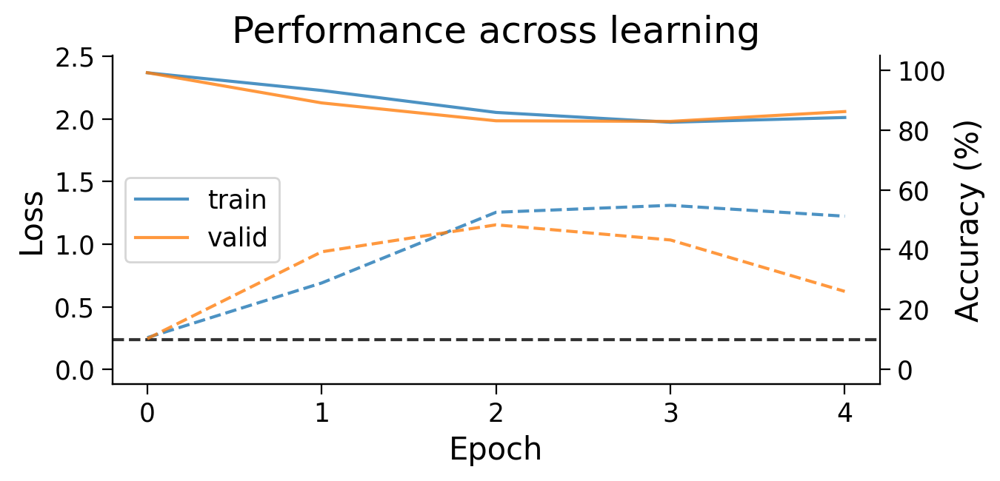

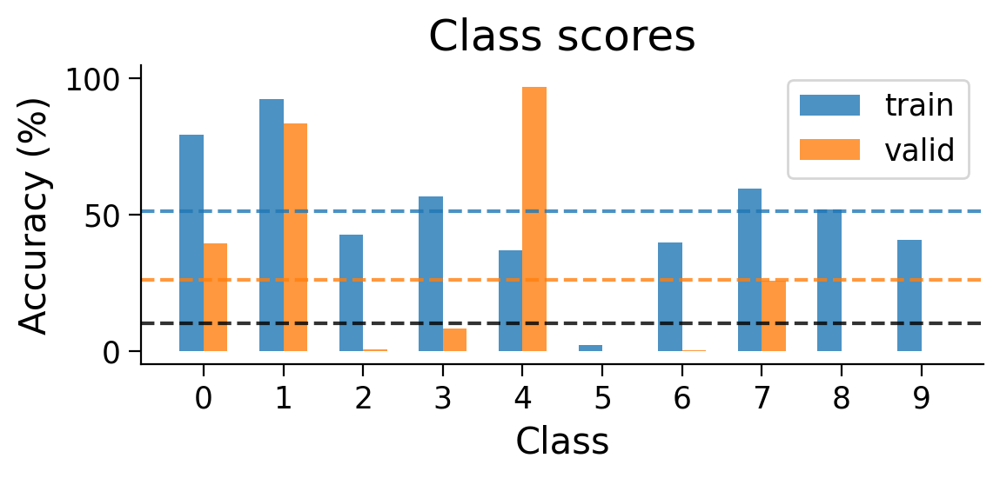

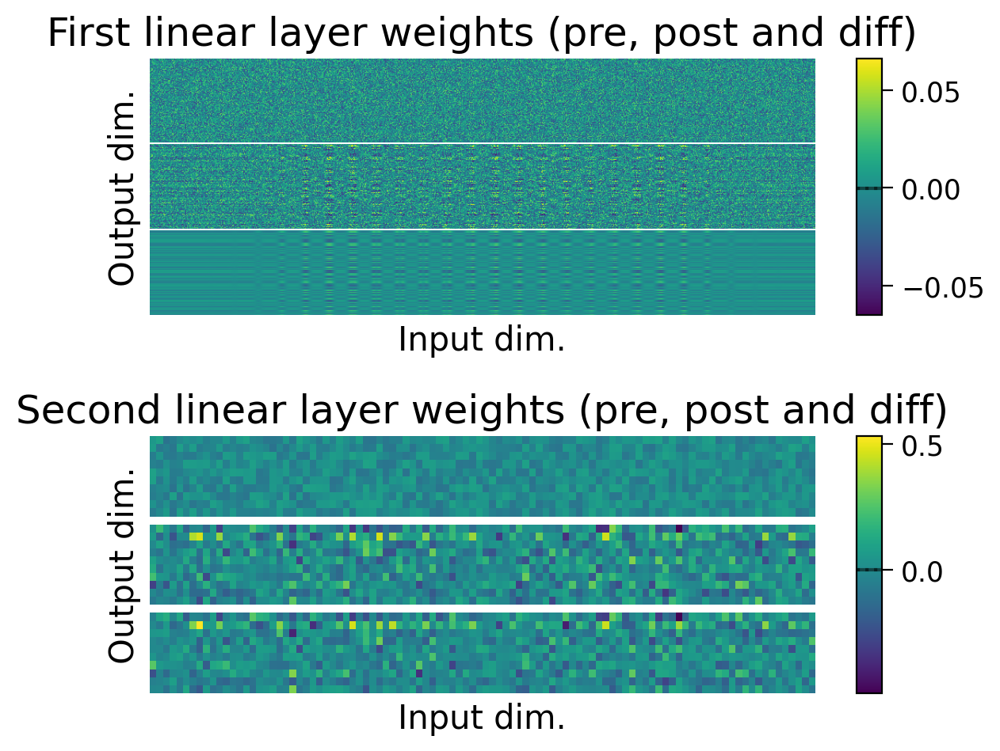

In [ ]:
HybridMLP, Hybrid_results_dict = train_model_extended(
    model_type="hebbian",
    num_epochs=5,
    partial_backprop=True, # backprop on the final layer
    lr=[HEBB_LR / 5, LR], # learning rates for each layer
)

plot_results(Hybrid_results_dict)
plot_scores_per_class(Hybrid_results_dict)
plot_weights(HybridMLP);

## Feedback alignment MLP

In [ ]:
import torch
import torch.nn as nn
import numpy as np
from torch.autograd import Function


class FeedbackAlignmentFunction(Function):
    @staticmethod
    def forward(context, input, weight, weight_fa, bias=None):
        context.save_for_backward(input, weight, weight_fa, bias)
        output = input.matmul(weight.t())
        if bias is not None:
            output += bias.unsqueeze(0).expand_as(output)
        return output

    @staticmethod
    def backward(context, grad_output):
        input, weight, weight_fa, bias = context.saved_variables
        grad_input = grad_weight = grad_weight_fa = grad_bias = None
        if context.needs_input_grad[0]:
            grad_input = grad_output.matmul(weight_fa)
        if context.needs_input_grad[1]:
            grad_weight = grad_output.t().matmul(input)
        if bias is not None and context.needs_input_grad[3]:
            grad_bias = grad_output.sum(0).squeeze(0)

        return grad_input, grad_weight, grad_weight_fa, grad_bias


class FeedbackAlignmentLinear(nn.Module):
    def __init__(self, input_features, output_features, bias=True):
        super(FeedbackAlignmentLinear, self).__init__()
        self.input_features = input_features
        self.output_features = output_features

        self.weight = nn.Parameter(torch.Tensor(output_features, input_features))
        if bias:
            self.bias = nn.Parameter(torch.Tensor(output_features))
        else:
            self.register_parameter('bias', None)

        self.weight_fa = nn.Parameter(torch.rand(output_features, input_features, requires_grad=False))

        torch.nn.init.kaiming_uniform_(self.weight)
        torch.nn.init.kaiming_uniform_(self.weight_fa)
        if self.bias is not None:
            torch.nn.init.constant_(self.bias, 1)

    def forward(self, input):
        return FeedbackAlignmentFunction.apply(input, self.weight, self.weight_fa, self.bias)


class FeedbackAlignmentMLP(MultiLayerPerceptron):
    def __init__(self, clamp_output=True, **kwargs):
        self.clamp_output = clamp_output
        super().__init__(**kwargs)
        self.lin1 = FeedbackAlignmentLinear(self.num_inputs, self.num_hidden, bias=self.bias)
        self.lin2 = FeedbackAlignmentLinear(self.num_hidden, self.num_outputs, bias=self.bias)
        self.activations = {}

    def forward(self, X, y=None):
        self.activations = {}

        h = self.activation(self.lin1(X.reshape(-1, self.num_inputs)))
        self.activations['hidden'] = h.detach().cpu().numpy()

        if y is None or not self.clamp_output:
            targets = None
        else:
            targets = torch.nn.functional.one_hot(y, num_classes=self.num_outputs).float()

        y_pred = self.softmax(self.lin2(h))
        self.activations['output'] = y_pred.detach().cpu().numpy()

        return y_pred


 12%|█▎        | 1/8 [00:09<01:07,  9.61s/it]

Epoch 1/8
Train Loss: 2.4625, Train Accuracy: 7.41%
Valid Loss: 2.4598, Valid Accuracy: 7.75%


<ipython-input-229-4b74809ad3d4>:18: DeprecationWarning: 'saved_variables' is deprecated; use 'saved_tensors'
  input, weight, weight_fa, bias = context.saved_variables
 25%|██▌       | 2/8 [00:19<00:59,  9.94s/it]

Epoch 2/8
Train Loss: 2.3074, Train Accuracy: 14.15%
Valid Loss: 2.2107, Valid Accuracy: 19.80%


 38%|███▊      | 3/8 [00:30<00:51, 10.23s/it]

Epoch 3/8
Train Loss: 2.1378, Train Accuracy: 27.32%
Valid Loss: 2.0530, Valid Accuracy: 34.24%


 50%|█████     | 4/8 [00:41<00:41, 10.46s/it]

Epoch 4/8
Train Loss: 1.9733, Train Accuracy: 41.14%
Valid Loss: 1.8810, Valid Accuracy: 47.56%


 62%|██████▎   | 5/8 [00:51<00:31, 10.56s/it]

Epoch 5/8
Train Loss: 1.8002, Train Accuracy: 51.64%
Valid Loss: 1.7071, Valid Accuracy: 56.26%


 75%|███████▌  | 6/8 [01:02<00:20, 10.47s/it]

Epoch 6/8
Train Loss: 1.6318, Train Accuracy: 59.02%
Valid Loss: 1.5447, Valid Accuracy: 61.66%


 88%|████████▊ | 7/8 [01:12<00:10, 10.41s/it]

Epoch 7/8
Train Loss: 1.4791, Train Accuracy: 63.82%
Valid Loss: 1.4020, Valid Accuracy: 66.01%


100%|██████████| 8/8 [01:23<00:00, 10.41s/it]

Epoch 8/8
Train Loss: 1.3466, Train Accuracy: 67.92%
Valid Loss: 1.2797, Valid Accuracy: 69.89%


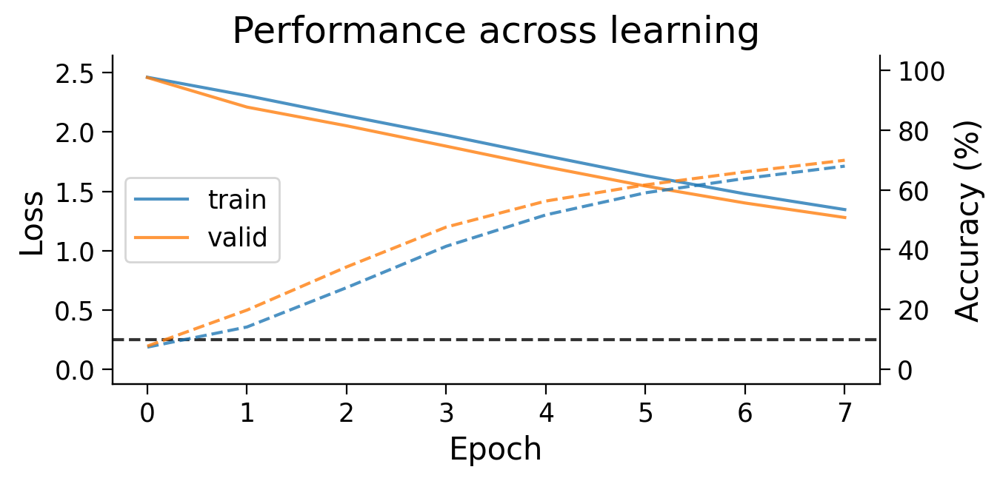

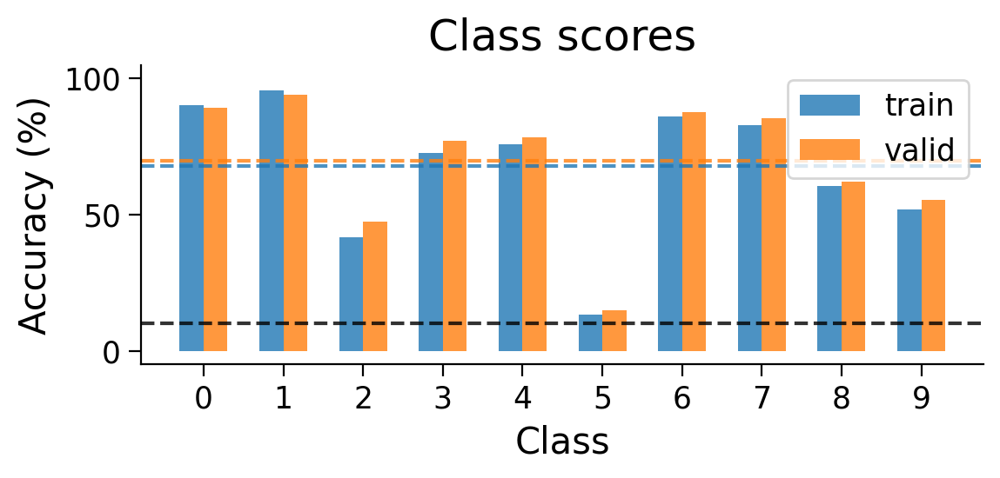

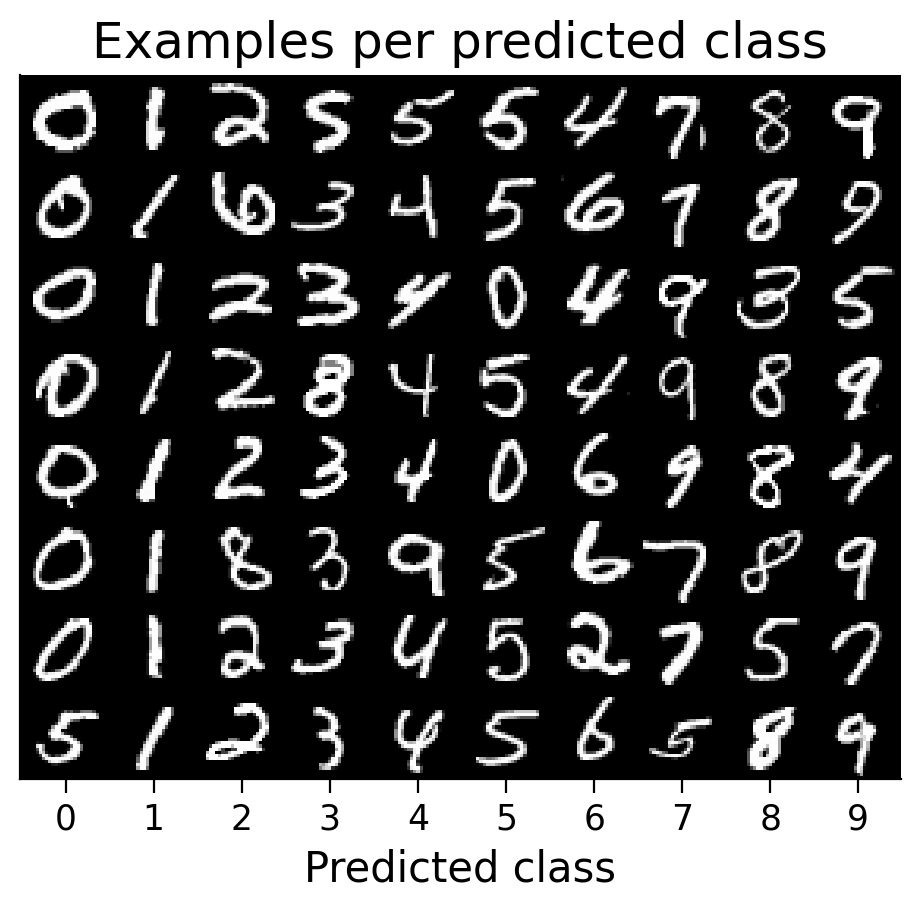

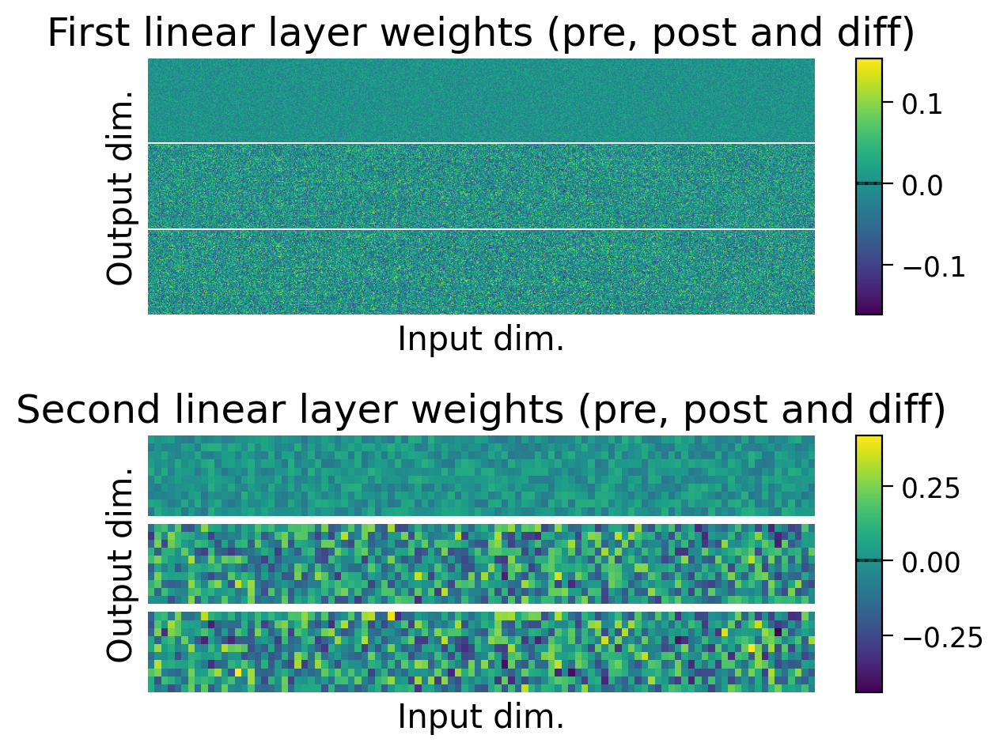

In [ ]:
LR = 1e-3
NUM_HIDDEN = 100
BIAS = False
ACTIVATION = 'sigmoid'

FeedbackAlignmentMLP_10cls = FeedbackAlignmentMLP(
    num_hidden=NUM_HIDDEN,
    num_outputs=10,
    # clamp_output=True,
    # activation_type=ACTIVATION
)

fa_optimizer_10cls = BasicOptimizer(FeedbackAlignmentMLP_10cls.parameters(), lr=LR)

FA_results_dict_10cls = train_model(
    FeedbackAlignmentMLP_10cls,
    train_loader,
    valid_loader,
    fa_optimizer_10cls,
    num_epochs=8
    );

plot_results(FA_results_dict_10cls, num_classes=10)
plot_scores_per_class(FA_results_dict_10cls, num_classes=10)
plot_examples(valid_loader.dataset, MLP=FeedbackAlignmentMLP_10cls, num_classes=10)
plot_weights(FeedbackAlignmentMLP_10cls);

## Kolen Pollack MLP

In [ ]:
class KolenPollackFunction(Function):
    @staticmethod
    def forward(context, input, weight, weight_fa, bias=None):
        context.save_for_backward(input, weight, weight_fa, bias)
        output = input.matmul(weight.t())
        if bias is not None:
            output += bias.unsqueeze(0).expand_as(output)
        return output

    @staticmethod
    def backward(context, grad_output):
        input, weight, weight_fa, bias = context.saved_variables
        grad_input = grad_weight = grad_weight_fa = grad_bias = None

        if context.needs_input_grad[0]:
            grad_input = grad_output.matmul(weight_fa)
        if context.needs_input_grad[1]:
            grad_weight = grad_output.t().matmul(input)
        if bias is not None and context.needs_input_grad[3]:
            grad_bias = grad_output.sum(0).squeeze(0)

        grad_weight_fa = grad_weight  # Update the weight_fa with the gradient of the weight

        return grad_input, grad_weight, grad_weight_fa, grad_bias


class KolenPollackLinear(nn.Module):
    def __init__(self, input_features, output_features, bias=True):
        super(KolenPollackLinear, self).__init__()
        self.input_features = input_features
        self.output_features = output_features

        self.weight = nn.Parameter(torch.Tensor(output_features, input_features))
        if bias:
            self.bias = nn.Parameter(torch.Tensor(output_features))
        else:
            self.register_parameter('bias', None)

        self.weight_fa = nn.Parameter(torch.rand(output_features, input_features, requires_grad=False))

        torch.nn.init.kaiming_uniform_(self.weight)
        torch.nn.init.kaiming_uniform_(self.weight_fa)
        if self.bias is not None:
            torch.nn.init.constant_(self.bias, 1)

    def forward(self, input):
        return KolenPollackFunction.apply(input, self.weight, self.weight_fa, self.bias)


class KolenPollackMLP(MultiLayerPerceptron):
    def __init__(self, clamp_output=True, **kwargs):
        self.clamp_output = clamp_output
        super().__init__(**kwargs)
        self.lin1 = KolenPollackLinear(self.num_inputs, self.num_hidden, bias=self.bias)
        self.lin2 = KolenPollackLinear(self.num_hidden, self.num_outputs, bias=self.bias)
        self.activations = {}

    def forward(self, X, y=None):
        self.activations = {}

        h = self.activation(self.lin1(X.reshape(-1, self.num_inputs)))
        self.activations['hidden'] = h.detach().cpu().numpy()

        if y is None or not self.clamp_output:
            targets = None
        else:
            targets = torch.nn.functional.one_hot(y, num_classes=self.num_outputs).float()

        y_pred = self.softmax(self.lin2(h))
        self.activations['output'] = y_pred.detach().cpu().numpy()

        return y_pred


 12%|█▎        | 1/8 [00:10<01:12, 10.34s/it]

Epoch 1/8
Train Loss: 2.6737, Train Accuracy: 14.85%
Valid Loss: 2.6699, Valid Accuracy: 14.65%


<ipython-input-230-31dc3f676148>:12: DeprecationWarning: 'saved_variables' is deprecated; use 'saved_tensors'
  input, weight, weight_fa, bias = context.saved_variables
 25%|██▌       | 2/8 [00:21<01:04, 10.68s/it]

Epoch 2/8
Train Loss: 2.4056, Train Accuracy: 14.11%
Valid Loss: 2.2662, Valid Accuracy: 13.54%


 38%|███▊      | 3/8 [00:32<00:53, 10.74s/it]

Epoch 3/8
Train Loss: 2.1976, Train Accuracy: 20.04%
Valid Loss: 2.1327, Valid Accuracy: 27.27%


 50%|█████     | 4/8 [00:42<00:43, 10.76s/it]

Epoch 4/8
Train Loss: 2.0576, Train Accuracy: 31.94%
Valid Loss: 1.9788, Valid Accuracy: 35.91%


 62%|██████▎   | 5/8 [00:53<00:31, 10.56s/it]

Epoch 5/8
Train Loss: 1.8958, Train Accuracy: 39.92%
Valid Loss: 1.8106, Valid Accuracy: 43.96%


 75%|███████▌  | 6/8 [01:04<00:21, 10.69s/it]

Epoch 6/8
Train Loss: 1.7281, Train Accuracy: 48.19%
Valid Loss: 1.6423, Valid Accuracy: 53.04%


 88%|████████▊ | 7/8 [01:15<00:10, 10.81s/it]

Epoch 7/8
Train Loss: 1.5653, Train Accuracy: 56.49%
Valid Loss: 1.4851, Valid Accuracy: 61.53%


100%|██████████| 8/8 [01:25<00:00, 10.75s/it]

Epoch 8/8
Train Loss: 1.4156, Train Accuracy: 63.65%
Valid Loss: 1.3432, Valid Accuracy: 67.61%


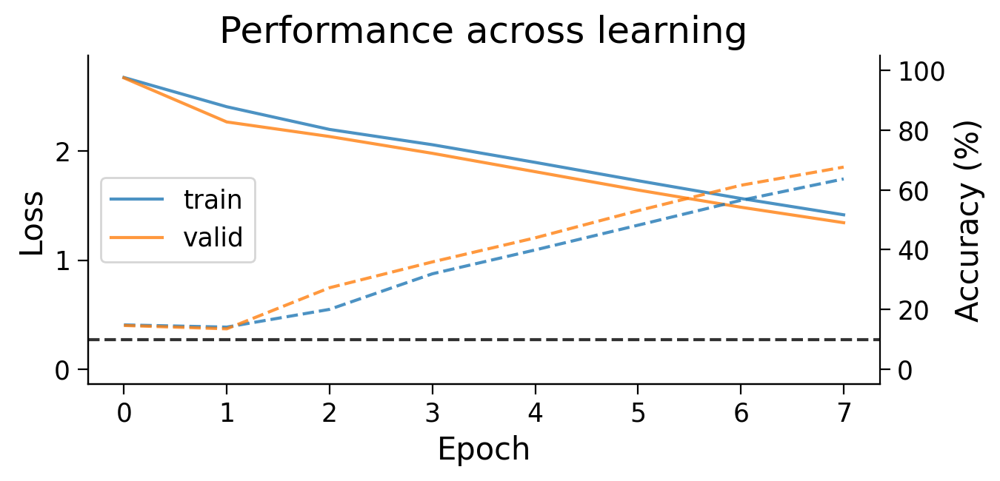

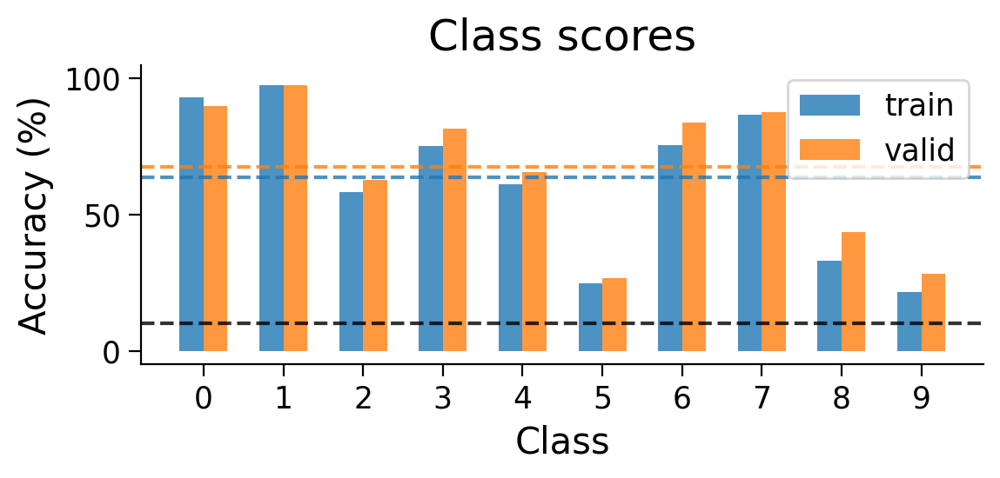

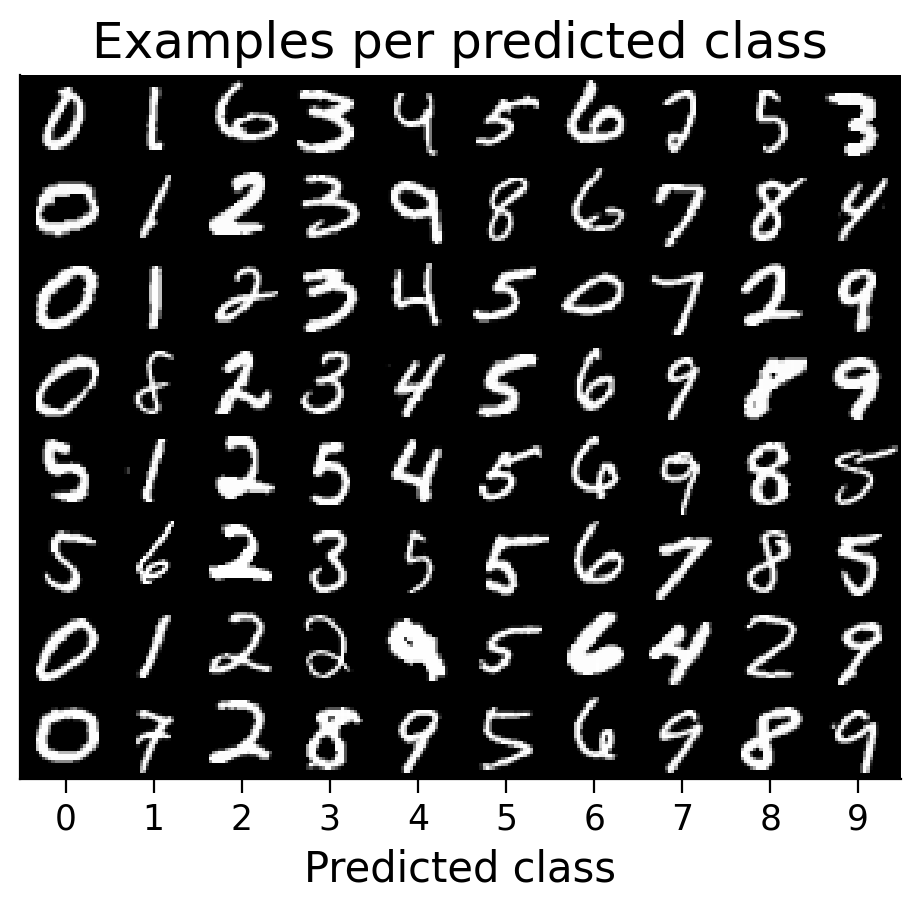

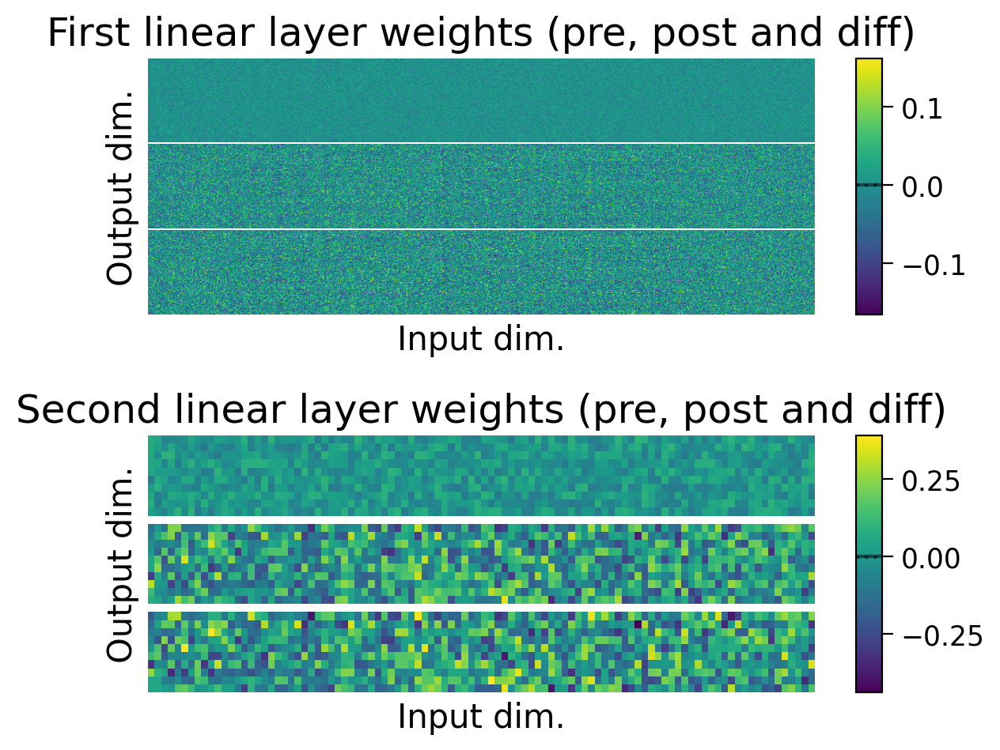

In [ ]:
LR = 1e-3
NUM_HIDDEN = 100
BIAS = False
ACTIVATION = 'sigmoid'

KolenPollackMLP_10cls = KolenPollackMLP(
    num_hidden=NUM_HIDDEN,
    num_outputs=10,
    # clamp_output=True,
    # activation_type=ACTIVATION
)

kp_optimizer_10cls = BasicOptimizer(KolenPollackMLP_10cls.parameters(), lr=LR)

kp_results_dict_10cls = train_model(
    KolenPollackMLP_10cls,
    train_loader,
    valid_loader,
    kp_optimizer_10cls,
    num_epochs=8
    );

plot_results(kp_results_dict_10cls, num_classes=10)
plot_scores_per_class(kp_results_dict_10cls, num_classes=10)
plot_examples(valid_loader.dataset, MLP=KolenPollackMLP_10cls, num_classes=10)
plot_weights(KolenPollackMLP_10cls);

### Plot SNR of gradient variance for each parameter

In [ ]:
#@markdown `compute_gradient_SNR(MLP, dataset)`: Passes a dataset through a model
#@markdown and computes the SNR of the gradients computed by the model for each example.
#@markdown Returns a dictionary containing the gradient SNRs for each layer of a model.

def compute_gradient_SNR(MLP, dataset):
  """
  Computes gradient SNRs for a model given a dataset.

  Arguments:
  - MLP (torch model): Model for which to compute gradient SNRs.
  - dataset (torch dataset): Dataset with which to compute gradient SNRs.

  Returns:
  - SNR_dict (dict): Dictionary compiling gradient SNRs for each parameter
    (i.e., the weights and/or biases of each layer).
  """

  MLP.eval()

  criterion = torch.nn.NLLLoss()

  gradients = {key: list() for key in MLP.list_parameters()}

  # initialize a loader with a batch size of 1
  loader = torch.utils.data.DataLoader(dataset, batch_size=1)

  # collect gradients computed on the dataset of data
  for X, y in loader:
    y_pred = MLP(X, y=y)
    loss = criterion(torch.log(y_pred), y)

    MLP.zero_grad() # zero grad before
    loss.backward()
    for key, value in MLP.gather_gradient_dict().items():
      gradients[key].append(value)
    MLP.zero_grad() # zero grad after, since no optimzer step is taken

  # aggregate the gradients
  SNR_dict = {key: list() for key in MLP.list_parameters()}
  for key, value in gradients.items():
      SNR_dict[key] = compute_SNR(np.asarray(value))

  return SNR_dict


def compute_SNR(data, epsilon=1e-7):
    """
    Calculates the average SNR for of data across the first axis.

    Arguments:
    - data (torch Tensor): items x gradients
    - epsilon (float, optional): value added to the denominator to avoid
      division by zero.

    Returns:
    - avg_SNR (float): average SNR across data items
    """

    absolute_mean = np.abs(np.mean(data, axis=0))
    std = np.std(data, axis=0)
    SNR_by_item = absolute_mean / (std + epsilon)
    avg_SNR = np.mean(SNR_by_item)

    return avg_SNR

#@markdown `plot_gradient_SNRs(SNR_dict)`: Plots gradient SNRs collected in
#@markdown a dictionary.
def plot_gradient_SNRs(SNR_dict, width=0.5, ax=None):
    """
    Plot gradient SNRs for various learning rules.

    Arguments:
    - SNR_dict (dict): Gradient SNRs for each learning rule.
    - width (float, optional): Width of the bars.
    - ax (plt subplot, optional): Axis on which to plot gradient SNRs. If None, a
      new axis will be created.

    Returns:
    - ax (plt subplot): Axis on which gradient SNRs were plotted.
    """
    if ax is None:
        wid = min(8, len(SNR_dict) * 1.5)
        _, ax = plt.subplots(figsize=(wid, 4))

    xlabels = list()
    SNR_means = list()
    SNR_sems = list()
    SNRs_scatter = list()
    for m, (model_type, SNRs) in enumerate(SNR_dict.items()):
        xlabels.append(model_type)
        color = get_plotting_color(model_idx=m)
        ax.bar(
            m, np.mean(SNRs), yerr=scipy.stats.sem(SNRs),
            alpha=0.5, width=width, capsize=5, color=color
        )
        s = [20 + i * 30 for i in range(len(SNRs))]
        ax.scatter([m] * len(SNRs), SNRs, alpha=0.8, s=s, color=color, zorder=5)

    x = np.arange(len(xlabels))
    ax.set_xticks(x)
    x_pad = (x.max() - x.min() + width) * 0.3
    ax.set_xlim(x.min() - x_pad, x.max() + x_pad)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Learning rule")
    ax.set_ylabel("SNR")
    ax.set_title("SNR of the gradients")

    return ax

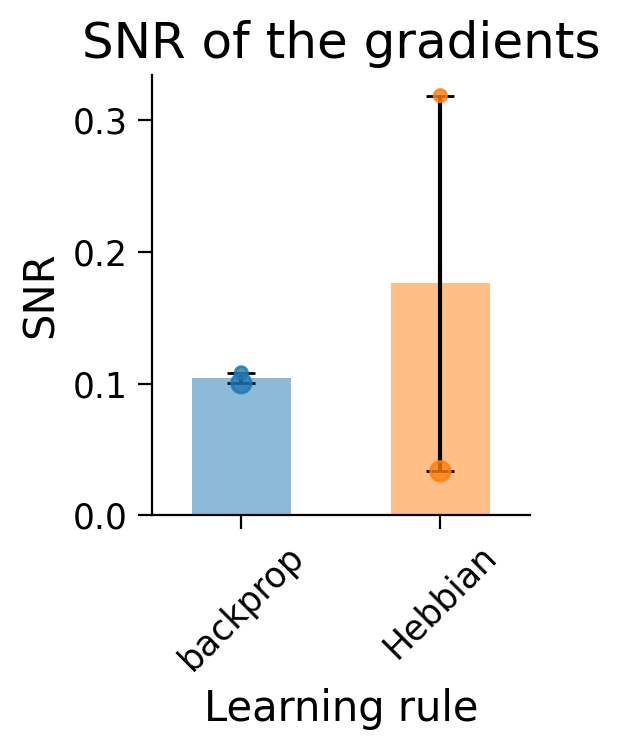

In [ ]:
SNR_dict = dict()
for model_type in ["backprop", "Hebbian", k]:
  model_params = {
      "num_hidden": NUM_HIDDEN,
      "activation_type": ACTIVATION,
      "bias": BIAS,
  }

  if model_type == "Hebbian":
    model_fct = HebbianMultiLayerPerceptron
  else:
    model_fct = MultiLayerPerceptron

  model = model_fct(**model_params)

  model_SNR_dict = compute_gradient_SNR(model, valid_loader.dataset)

  SNR_dict[model_type] = [SNR for SNR in model_SNR_dict.values()]

plot_gradient_SNRs(SNR_dict);

### Estimate the gradient bias with respect to backprop using cosine similarity

In [ ]:
#@markdown `train_and_calculate_cosine_sim(MLP, train_loader, valid_loader, optimizer)`:
#@markdown Trains a model using a specific learning rule, while computing the cosine
#@markdown similarity of the gradients proposed the learning rule compared to those proposed
#@markdown by error backpropagation.
def train_and_calculate_cosine_sim(MLP, train_loader, valid_loader, optimizer,
                                   num_epochs=8):
  """
  Train model across epochs, calculating the cosine similarity between the
  gradients proposed by the learning rule it's trained with, compared to those
  proposed by error backpropagation.

  Arguments:
  - MLP (torch model): Model to train.
  - train_loader (torch dataloader): Dataloader to use to train the model.
  - valid_loader (torch dataloader): Dataloader to use to validate the model.
  - optimizer (torch optimizer): Optimizer to use to update the model.
  - num_epochs (int, optional): Number of epochs to train model.

  Returns:
  - cosine_sim (dict): Dictionary storing the cosine similarity between the
    model's learning rule and backprop across epochs, computed on the
    validation data.
  """

  criterion = torch.nn.NLLLoss()

  cosine_sim_dict = {key: list() for key in MLP.list_parameters()}

  for e in tqdm(range(num_epochs)):
    MLP.train()
    for X, y in train_loader:
      y_pred = MLP(X, y=y)
      loss = criterion(torch.log(y_pred), y)
      optimizer.zero_grad()
      if e != 0:
        loss.backward()
        optimizer.step()

    MLP.eval()
    lr_gradients_dict = {key: list() for key in cosine_sim_dict.keys()}
    backprop_gradients_dict = {key: list() for key in cosine_sim_dict.keys()}

    for X, y in valid_loader:
      # collect gradients computed with learning rule
      y_pred = MLP(X, y=y)
      loss = criterion(torch.log(y_pred), y)

      MLP.zero_grad()
      loss.backward()
      for key, value in MLP.gather_gradient_dict().items():
        lr_gradients_dict[key].append(value)
      MLP.zero_grad()

      # collect gradients computed with backprop
      y_pred = MLP.forward_backprop(X)
      loss = criterion(torch.log(y_pred), y)

      MLP.zero_grad()
      loss.backward()
      for key, value in MLP.gather_gradient_dict().items():
        backprop_gradients_dict[key].append(value)
      MLP.zero_grad()

    for key in cosine_sim_dict.keys():
      lr_grad = np.asarray(lr_gradients_dict[key])
      bp_grad = np.asarray(backprop_gradients_dict[key])
      if (lr_grad == 0).all():
        warnings.warn(
          f"Learning rule computed all 0 gradients for epoch {e}. "
          "Cosine similarity cannot be calculated."
          )
        epoch_cosine_sim = np.nan
      elif (bp_grad == 0).all():
        warnings.warn(
          f"Backprop. rule computed all 0 gradients for epoch {e}. "
          "Cosine similarity cannot be calculated."
          )
        epoch_cosine_sim = np.nan
      else:
        epoch_cosine_sim = calculate_cosine_similarity(lr_grad, bp_grad)

      cosine_sim_dict[key].append(epoch_cosine_sim)

  return cosine_sim_dict


def calculate_cosine_similarity(data1, data2):
    """
    Calculates the cosine similarity between two vectors.

    Arguments:
    - data1 (torch Tensor): first vector
    - data2 (torch Tensor): second vector
    """

    data1 = data1.reshape(-1)
    data2 = data2.reshape(-1)

    numerator = np.dot(data1, data2)
    denominator = (
        np.sqrt(np.dot(data1, data1)) * np.sqrt(np.dot(data2, data2))
      )

    cosine_sim = numerator / denominator

    return cosine_sim

#@markdown `plot_gradient_cosine_sims(cosine_sim_dict)`: Plots cosine similarity
#@markdown of the gradients proposed by a model across learning to those proposed
#@markdown by error backpropagation.
def plot_gradient_cosine_sims(cosine_sim_dict, ax=None):
  """
  Plot gradient cosine similarities to error backpropagation for various
  learning rules.

  Arguments:
  - cosine_sim_dict (dict): Gradient cosine similarities for each learning rule.
  - ax (plt subplot, optional): Axis on which to plot gradient cosine
    similarities. If None, a new axis will be created.

  Returns:
  - ax (plt subplot): Axis on which gradient cosine similarities were plotted.
  """

  if ax is None:
    _, ax = plt.subplots(figsize=(8, 4))

  max_num_epochs = 0
  for m, (model_type, cosine_sims) in enumerate(cosine_sim_dict.items()):
    cosine_sims = np.asarray(cosine_sims) # params x epochs
    num_epochs = cosine_sims.shape[1]
    x = np.arange(num_epochs)
    cosine_sim_means = np.nanmean(cosine_sims, axis=0)
    cosine_sim_sems = scipy.stats.sem(cosine_sims, axis=0, nan_policy="omit")

    ax.plot(x, cosine_sim_means, label=model_type, alpha=0.8)

    color = get_plotting_color(model_idx=m)
    ax.fill_between(
        x,
        cosine_sim_means - cosine_sim_sems,
        cosine_sim_means + cosine_sim_sems,
        alpha=0.3, lw=0, color=color
        )

    for i, param_cosine_sims in enumerate(cosine_sims):
      s = 20 + i * 30
      ax.scatter(x, param_cosine_sims, color=color, s=s, alpha=0.6)

    max_num_epochs = max(max_num_epochs, num_epochs)

  if max_num_epochs > 0:
    x = np.arange(max_num_epochs)
    xlabels = [f"{int(e)}" for e in x]
    ax.set_xticks(x)
    ax.set_xticklabels(xlabels)

  ymin = ax.get_ylim()[0]
  ymin = min(-0.1, ymin)
  ax.set_ylim(ymin, 1.1)

  ax.axhline(0, ls="dashed", color="k", zorder=-5, alpha=0.5)

  ax.set_xlabel("Epoch")
  ax.set_ylabel("Cosine similarity")
  ax.set_title("Cosine similarity to backprop gradients in MLP")
  ax.legend()

  return ax

100%|██████████| 10/10 [01:37<00:00,  9.71s/it]


100%|██████████| 10/10 [01:44<00:00, 10.40s/it]


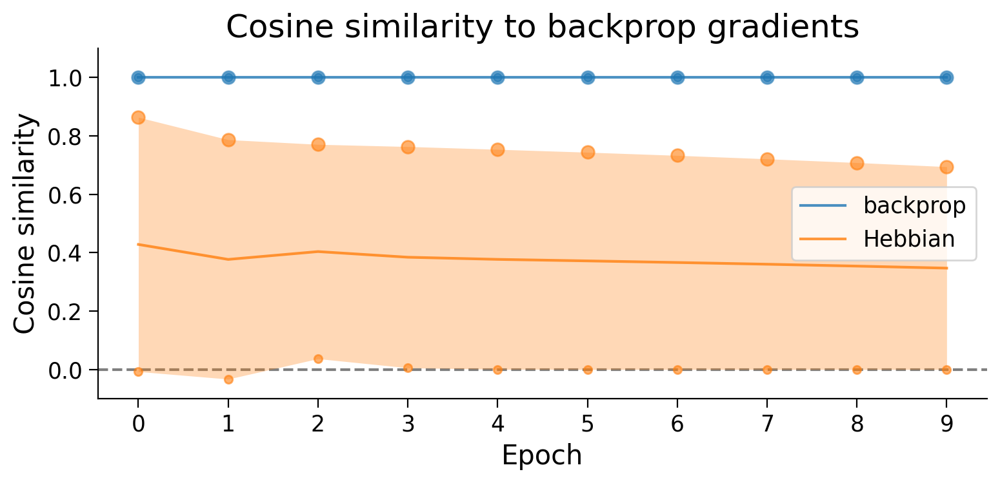

In [ ]:
NUM_EPOCHS = 10

cosine_sim_dict = dict()
for model_type in ["backprop", "Hebbian"]:
  model_params = {
      "num_hidden": NUM_HIDDEN,
      "activation_type": ACTIVATION,
      "bias": BIAS,
  }

  if model_type == "Hebbian":
    model_fct = HebbianMultiLayerPerceptron
    lr = HEBB_LR
  else:
    model_fct = MultiLayerPerceptron
    lr = LR

  model = model_fct(**model_params)

  optimizer = BasicOptimizer(model.parameters(), lr=lr)

  print(f"Collecting Cosine similarities for {model_type}-trained model...")
  model_cosine_sim_dict = train_and_calculate_cosine_sim(
      model, train_loader, valid_loader, optimizer, num_epochs=NUM_EPOCHS
      )

  cosine_sim_dict[model_type] = [
      cos_sim for cos_sim in model_cosine_sim_dict.values()
      ]

plot_gradient_cosine_sims(cosine_sim_dict);

<Axes: title={'center': 'Cosine similarity to backprop gradients in MLP'}, xlabel='Epoch', ylabel='Cosine similarity'>

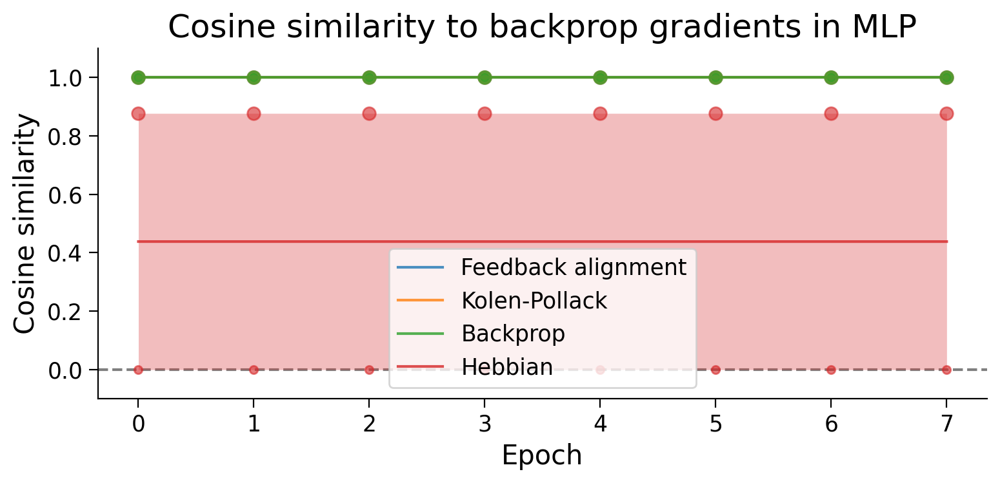

In [ ]:
# Dictionary to store cosine similarities
cosine_sim_dict = dict()

# Iterate over all model types
for model_type in ["Feedback alignment", "Kolen-Pollack", "Backprop", "Hebbian"]:
    model_params = {
        "num_inputs": NUM_INPUTS,
        "num_hidden": NUM_HIDDEN,
        "num_outputs": NUM_OUTPUTS,
        "activation_type": ACTIVATION,
        "bias": BIAS,
    }

    # Instantiate the appropriate model and set learning rate based on model_type
    if model_type == "Hebbian":
        model_fct = HebbianMultiLayerPerceptron
        lr = HEBB_LR
    elif model_type == "Feedback alignment":
        model_fct = FeedbackAlignmentMLP
        lr = LR
    elif model_type == "Kolen-Pollack":
        model_fct = KolenPollackMLP
        lr = LR
    else:
        model_fct = MultiLayerPerceptron
        lr = LR

    # Initialize the model
    model = model_fct(**model_params)

    # Define the optimizer
    optimizer = BasicOptimizer(model.parameters(), lr=lr)

    print(f"Collecting Cosine similarities for {model_type}-trained model...")
    # Train the model and calculate cosine similarities
    model_cosine_sim_dict = train_and_calculate_cosine_sim(
        model, train_loader, valid_loader, optimizer, num_epochs=8
    )

    # Store the cosine similarities in the dictionary
    cosine_sim_dict[model_type] = [
        cos_sim for cos_sim in model_cosine_sim_dict.values()
    ]

# Plot the gradient cosine similarities
plot_gradient_cosine_sims(cosine_sim_dict)

In [ ]:
cosine_sim_dict

{'Feedback alignment': [[1.0, 1.0, 1.0, 1.0, 0.9999999, 1.0, 1.0, 1.0],
  [1.0, 0.99999994, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]],
 'Kolen-Pollack': [[1.0,
   1.0,
   1.0000001,
   0.99999994,
   1.0,
   1.0000001,
   1.0000001,
   1.0],
  [1.0, 1.0000001, 1.0, 1.0, 1.0000001, 1.0000001, 1.0, 0.9999999]],
 'Backprop': [[1.0,
   0.99999994,
   0.99999994,
   1.0,
   1.0000001,
   1.0000001,
   1.0,
   1.0000001],
  [1.0, 1.0, 1.0000001, 1.0, 1.0, 0.99999994, 1.0000001, 1.0]],
 'Hebbian': [[-0.00042777054,
   -0.00044879975,
   -0.00046967226,
   -0.0004912035,
   -0.00051294063,
   -0.0005346591,
   -0.00055688753,
   -0.00057932833],
  [0.8765077,
   0.87651455,
   0.876522,
   0.87652844,
   0.87653536,
   0.8765424,
   0.8765491,
   0.87655616]]}

# Part 2: SNN

In [ ]:
!pip install snntorch

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinu

In [ ]:
import torch
import torch.nn as nn
import snntorch as snn
import snntorch.functional as SF
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from tqdm import tqdm
import numpy as np

num_steps = 25
dtype = torch.float
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

### Optimizer

In [ ]:
class BasicOptimizer(torch.optim.Optimizer):
  """
  Simple optimizer class based on the SGD optimizer.
  """
  def __init__(self, params, lr=0.01, weight_decay=0):
    """
    Initializes a basic optimizer object.

    Arguments:
    - params (generator): Generator for torch model parameters.
    - lr (float, optional): Learning rate.
    - weight_decay (float, optional): Weight decay.
    """

    if lr < 0.0:
        raise ValueError(f"Invalid learning rate: {lr}")
    if weight_decay < 0.0:
        raise ValueError(f"Invalid weight_decay value: {weight_decay}")

    defaults = dict(
        lr=lr,
        weight_decay=weight_decay,
        )

    super().__init__(params, defaults)

  def step(self):
      """
      Performs a single optimization step.
      """

      for group in self.param_groups:
        for p in group["params"]:

          # only update parameters with gradients
          if p.grad is not None:

            # apply weight decay to gradient, if applicable
            if group["weight_decay"] != 0:
              p.grad = p.grad.add(p, alpha=group["weight_decay"])

            # apply gradient-based update
            p.data.add_(p.grad, alpha=-group["lr"])

### Training functions

In [ ]:
def train_model(MLP, train_loader, valid_loader, optimizer, num_epochs=5):
    results_dict = {
        "avg_train_losses": list(),
        "avg_valid_losses": list(),
        "avg_train_accuracies": list(),
        "avg_valid_accuracies": list(),
    }

    for e in tqdm(range(num_epochs)):
        no_train = True if e == 0 else False  # to get a baseline
        latest_epoch_results_dict = train_epoch(
            MLP, train_loader, valid_loader, optimizer=optimizer, no_train=no_train
        )

        for key, result in latest_epoch_results_dict.items():
            if key in results_dict.keys() and isinstance(results_dict[key], list):
                results_dict[key].append(latest_epoch_results_dict[key])
            else:
                results_dict[key] = result  # copy latest
         # Logging
        print(f"Epoch {e + 1}/{num_epochs}")
        print(f"Train Loss: {results_dict['avg_train_losses'][-1]:.4f}, Train Accuracy: {results_dict['avg_train_accuracies'][-1]:.2f}%")
        print(f"Valid Loss: {results_dict['avg_valid_losses'][-1]:.4f}, Valid Accuracy: {results_dict['avg_valid_accuracies'][-1]:.2f}%")


    return results_dict


def train_epoch(MLP, train_loader, valid_loader, optimizer, no_train=False):
    criterion = SF.ce_count_loss()  # Cross-entropy loss on spike count

    epoch_results_dict = dict()
    for dataset in ["train", "valid"]:
        for sub_str in ["correct_by_class", "seen_by_class"]:
            epoch_results_dict[f"{dataset}_{sub_str}"] = {
                i: 0 for i in range(MLP.num_outputs)
            }

    MLP.train()
    train_losses, train_acc = list(), list()
    for X, y in train_loader:
        X, y = X.to(device), y.to(device)  # Move data to GPU
        y_pred, mem_rec = MLP(X, y)
        loss = criterion(y_pred, y)  # Calculate the loss
        acc = SF.accuracy_rate(y_pred, y)  # Calculate accuracy
        train_losses.append(loss.item() * len(y))
        train_acc.append(acc.item() * len(y))
        update_results_by_class_in_place(
            y, y_pred.detach().sum(dim=0), epoch_results_dict, dataset="train",
            num_classes=MLP.num_outputs
        )
        optimizer.zero_grad()
        if not no_train:
            loss.backward()
            optimizer.step()

    num_items = len(train_loader.dataset)
    epoch_results_dict["avg_train_losses"] = np.sum(train_losses) / num_items
    epoch_results_dict["avg_train_accuracies"] = np.sum(train_acc) / num_items * 100

    MLP.eval()
    valid_losses, valid_acc = list(), list()
    with torch.no_grad():
        for X, y in valid_loader:
            X, y = X.to(device), y.to(device)  # Move data to GPU
            y_pred, mem_rec = MLP(X, y)
            loss = criterion(y_pred, y)  # Calculate the loss
            acc = SF.accuracy_rate(y_pred, y)  # Calculate accuracy
            valid_losses.append(loss.item() * len(y))
            valid_acc.append(acc.item() * len(y))
            update_results_by_class_in_place(
                y, y_pred.detach().sum(dim=0), epoch_results_dict, dataset="valid"
            )

    num_items = len(valid_loader.dataset)
    epoch_results_dict["avg_valid_losses"] = np.sum(valid_losses) / num_items
    epoch_results_dict["avg_valid_accuracies"] = np.sum(valid_acc) / num_items * 100

    return epoch_results_dict


def update_results_by_class_in_place(y, y_pred, result_dict, dataset="train",
                                     num_classes=10):
    y_pred = np.argmax(y_pred, axis=1)
    if len(y) != len(y_pred):
        raise RuntimeError("Number of predictions does not match number of targets.")

    for i in result_dict[f"{dataset}_seen_by_class"].keys():
        idxs = np.where(y == int(i))[0]
        result_dict[f"{dataset}_seen_by_class"][int(i)] += len(idxs)

        num_correct = int(sum(y[idxs] == y_pred[idxs]))
        result_dict[f"{dataset}_correct_by_class"][int(i)] += num_correct


### Plot weights function

In [ ]:
def plot_weights(MLP, shared_colorbar=False):
  """
  Function for plotting model weights and biases before and after learning.

  Arguments:
  - MLP (torch model): Model for which to plot weights and biases.
  - shared_colorbar (bool, optional): If True, one colorbar is shared for all
      parameters.

  Returns:
  - ax (plt subplot array): Axes on which weights and biases were plotted.
  """

  # param_names = MLP.list_parameters()
  # Filter param_names to include only weights
  # param_names = [name for name in MLP.list_parameters() if 'weight' in name]
  param_names = ["fc1_weight", "fc2_weight"]

  params_images = dict()
  pre_means = dict()
  post_means = dict()
  vmin, vmax = np.inf, -np.inf
  for param_name in param_names:
    layer, param_type = param_name.split("_")
    init_params = getattr(MLP, f"init_{layer}_{param_type}").numpy()
    separator = np.full((1, init_params.shape[-1]), np.nan)
    last_params = getattr(getattr(MLP, layer), param_type).detach().numpy()
    diff_params = last_params - init_params

    params_image = np.vstack(
        [init_params, separator, last_params, separator, diff_params]
        )
    vmin = min(vmin, np.nanmin(params_image))
    vmax = min(vmax, np.nanmax(params_image))

    params_images[param_name] = params_image
    pre_means[param_name] = init_params.mean()
    post_means[param_name] = last_params.mean()

  nrows = len(param_names)
  gridspec_kw = dict()
  if len(param_names) == 4:
    gridspec_kw["height_ratios"] = [5, 1, 5, 1]
    cbar_label = "Weight/bias values"
  elif len(param_names) == 2:
    gridspec_kw["height_ratios"] = [5, 5]
    cbar_label = "Weight values"
  else:
    raise NotImplementedError("Expected 2 parameters (weights only) or "
      f"4 parameters (weights and biases), but found {len(param_names)}"
    )

  if shared_colorbar:
    nrows += 1
    gridspec_kw["height_ratios"].append(1)
  else:
    vmin, vmax = None, None

  fig, axes = plt.subplots(
      nrows, 1, figsize=(6, nrows + 3), gridspec_kw=gridspec_kw
      )

  for i, (param_name, params_image) in enumerate(params_images.items()):
    layer, param_type = param_name.split("_")
    layer_str = "First" if layer == "fc1" else "Second"
    param_str = "weights" if param_type == "weight" else "biases"

    axes[i].set_title(f"{layer_str} linear layer {param_str} (pre, post and diff)")
    im = axes[i].imshow(params_image, aspect="auto", vmin=vmin, vmax=vmax)
    if not shared_colorbar:
      cbar = fig.colorbar(im, ax=axes[i], aspect=10)
      cbar.ax.axhline(pre_means[param_name], ls="dotted", color="k", alpha=0.5)
      cbar.ax.axhline(post_means[param_name], color="k", alpha=0.5)

    if param_type == "weight":
      axes[i].set_xlabel("Input dim.")
      axes[i].set_ylabel("Output dim.")
    axes[i].spines[["left", "bottom"]].set_visible(False)
    axes[i].set_xticks([])
    axes[i].set_yticks([])

  if shared_colorbar:
    cax = axes[-1]
    cbar = fig.colorbar(im, cax=cax, orientation="horizontal", location="bottom")
    cax.set_xlabel(cbar_label)

  return axes


# Backprop SNN  

### Definition of backprop SNN

In [ ]:
class SNN(nn.Module):
    def __init__(self, num_inputs=28*28, num_hidden=100, num_outputs=10, num_steps=25, beta=0.95):
        super(SNN, self).__init__()
        self.num_inputs = num_inputs
        self.num_hidden = num_hidden
        self.num_outputs = num_outputs
        self.num_steps = num_steps
        self.beta = beta

        self.fc1 = nn.Linear(num_inputs, num_hidden)
        self.lif1 = snn.Leaky(beta=beta)
        self.fc2 = nn.Linear(num_hidden, num_outputs)
        self.lif2 = snn.Leaky(beta=beta)

        self._initialize_weights()
        self._store_initial_weights_biases()
        self.activations = {}  # Initialize activations dictionary


    def _initialize_weights(self):
        torch.nn.init.xavier_uniform_(self.fc1.weight)
        torch.nn.init.xavier_uniform_(self.fc2.weight)
        if self.fc1.bias is not None:
            torch.nn.init.zeros_(self.fc1.bias)
        if self.fc2.bias is not None:
            torch.nn.init.zeros_(self.fc2.bias)

    def _store_initial_weights_biases(self):
        """
        Stores a copy of the network's initial weights and biases.
        """
        self.init_fc1_weight = self.fc1.weight.data.clone()
        self.init_fc2_weight = self.fc2.weight.data.clone()
        if self.fc1.bias is not None:
            self.init_fc1_bias = self.fc1.bias.data.clone()
        if self.fc2.bias is not None:
            self.init_fc2_bias = self.fc2.bias.data.clone()

    def forward(self, x, y=None):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = self.fc1(x)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
              self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = self.fc2(spk1)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
              self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def forward_backprop(self, x, y=None):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = self.fc1(x)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
              self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = self.fc2(spk1)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)


    def list_parameters(self):
        """
        Returns a list of model names for a gradient dictionary.

        Returns:
        - params_list (list): List of parameter names.
        """
        params_list = list()

        for layer_str in ["fc1", "fc2"]:
            params_list.append(f"{layer_str}_weight")
            # if getattr(self, layer_str).bias is not None:
            #     params_list.append(f"{layer_str}_bias")

        return params_list

    def gather_gradient_dict(self):
        """
        Gathers a gradient dictionary for the model's parameters. Raises a
        runtime error if any parameters have no gradients.

        Returns:
        - gradient_dict (dict): A dictionary of gradients for each parameter.
        """
        params_list = self.list_parameters()

        gradient_dict = dict()
        for param_name in params_list:
            layer_str, param_str = param_name.split("_")
            layer = getattr(self, layer_str)
            grad = getattr(layer, param_str).grad
            if grad is None:
                raise RuntimeError(f"No gradient was computed for parameter {param_name}")
            gradient_dict[param_name] = grad.detach().clone().numpy()

        return gradient_dict

### Training backprop SNN on 2-class task

In [ ]:
LR = 1e-3
backpropSNN_2cls = SNN(
    num_hidden=100,
    num_outputs=2,  # Assuming 2-class classification for MNIST
    num_steps=25,
    beta=0.95,
)

backprop_optimizer_2cls = BasicOptimizer(backpropSNN_2cls.parameters(), lr=LR)

backpropSNN_results_dict_2cls = train_model(
    backpropSNN_2cls,
    train_loader_2cls,
    valid_loader_2cls,
    backprop_optimizer_2cls,
    num_epochs=8
    );

plot_results(backpropSNN_results_dict_2cls, num_classes=2)
plot_scores_per_class(backpropSNN_results_dict_2cls, num_classes=2)
plot_weights(backpropSNN_2cls);

  0%|          | 0/8 [00:06<?, ?it/s]


KeyboardInterrupt: 

### Training backprop SNN on 10-class task

 12%|█▎        | 1/8 [00:34<04:00, 34.39s/it]

Epoch 1/8
Train Loss: 13.8599, Train Accuracy: 7.82%
Valid Loss: 13.5918, Valid Accuracy: 8.53%


 25%|██▌       | 2/8 [01:32<04:48, 48.15s/it]

Epoch 2/8
Train Loss: 1.7247, Train Accuracy: 32.58%
Valid Loss: 1.3711, Valid Accuracy: 45.37%


 38%|███▊      | 3/8 [02:20<04:00, 48.20s/it]

Epoch 3/8
Train Loss: 1.1806, Train Accuracy: 56.50%
Valid Loss: 1.0033, Valid Accuracy: 63.34%


 50%|█████     | 4/8 [03:05<03:08, 47.13s/it]

Epoch 4/8
Train Loss: 0.9759, Train Accuracy: 64.22%
Valid Loss: 1.1717, Valid Accuracy: 57.26%


 62%|██████▎   | 5/8 [03:47<02:15, 45.10s/it]

Epoch 5/8
Train Loss: 0.9398, Train Accuracy: 64.33%
Valid Loss: 0.9455, Valid Accuracy: 64.31%


 75%|███████▌  | 6/8 [04:29<01:28, 44.06s/it]

Epoch 6/8
Train Loss: 0.7325, Train Accuracy: 76.91%
Valid Loss: 0.6169, Valid Accuracy: 81.76%


 88%|████████▊ | 7/8 [05:11<00:43, 43.29s/it]

Epoch 7/8
Train Loss: 0.5963, Train Accuracy: 81.27%
Valid Loss: 0.6202, Valid Accuracy: 83.58%


100%|██████████| 8/8 [05:52<00:00, 44.07s/it]

Epoch 8/8
Train Loss: 0.4845, Train Accuracy: 87.40%
Valid Loss: 0.5308, Valid Accuracy: 87.08%


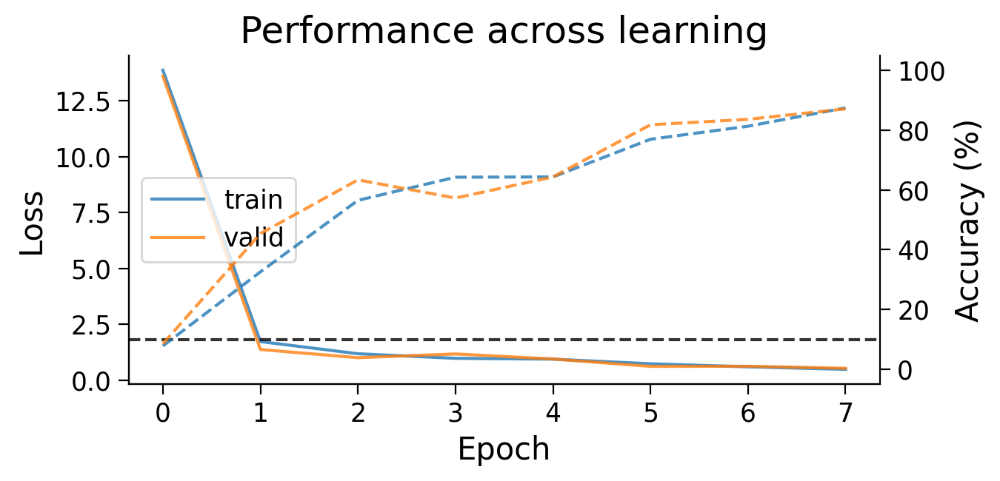

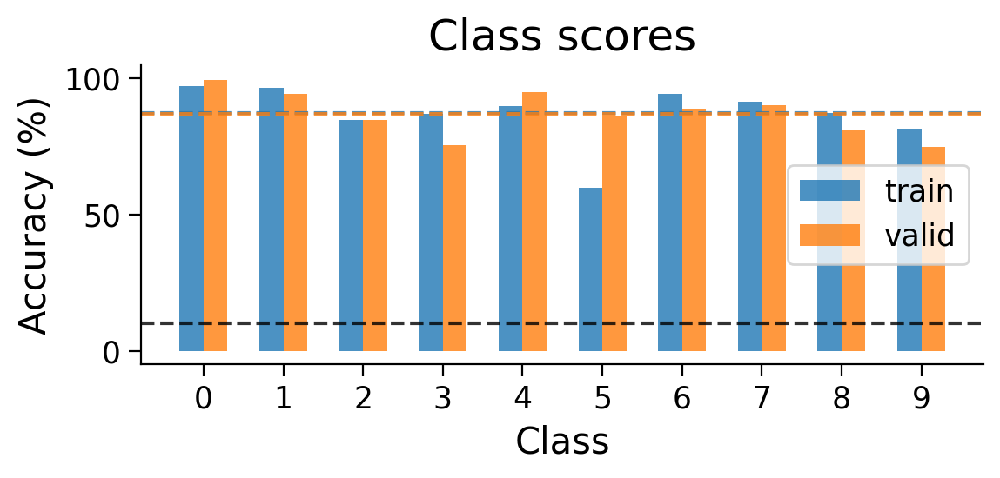

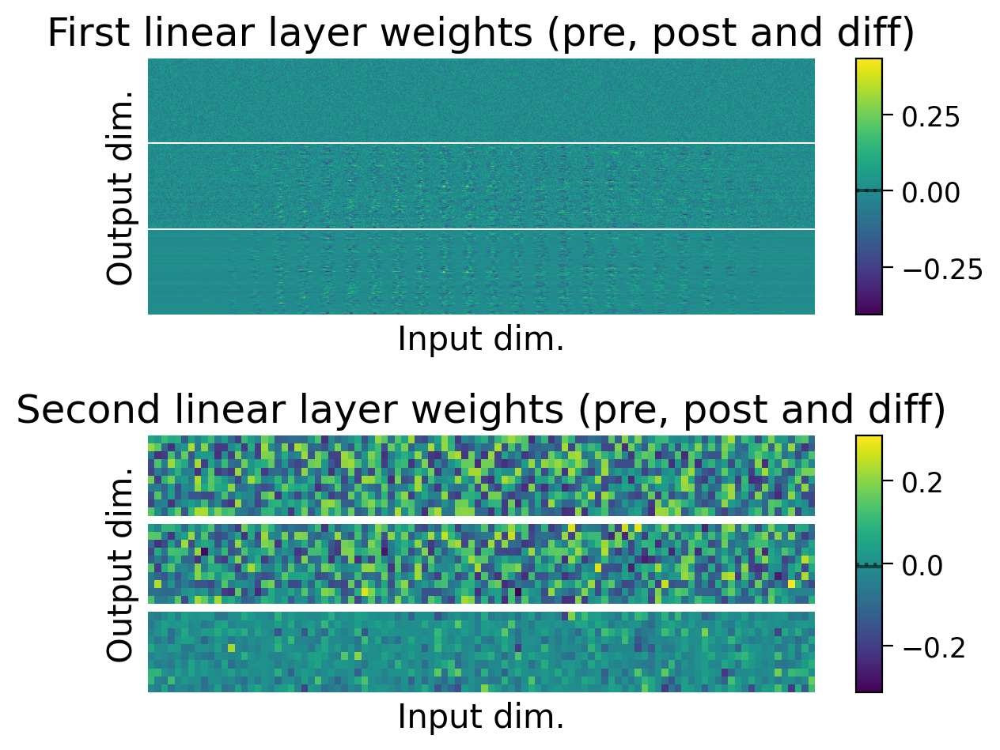

In [ ]:
LR = 1e-3
backpropSNN_10cls = SNN(
    num_hidden=100,
    num_outputs=10,  # Assuming 2-class classification for MNIST
    num_steps=25,
    beta=0.95,
)

backprop_optimizer_10cls = BasicOptimizer(backpropSNN_10cls.parameters(), lr=LR)

backpropSNN_results_dict_10cls = train_model(
    backpropSNN_10cls,
    train_loader,
    valid_loader,
    backprop_optimizer_10cls,
    num_epochs=8
    );

plot_results(backpropSNN_results_dict_10cls, num_classes=10)
plot_scores_per_class(backpropSNN_results_dict_10cls, num_classes=10)
plot_weights(backpropSNN_10cls);

# Hebbian SNN

#### Hebbian rule

In [ ]:
class HebbianFunction(torch.autograd.Function):
    @staticmethod
    def forward(ctx, input, weight, bias=None, nonlinearity=None, target=None):
        # Ensure input is a 2D matrix
        input = input.view(input.size(0), -1)

        # Perform the forward pass computation
        output = input.mm(weight.t())
        if bias is not None:
            output += bias.unsqueeze(0).expand_as(output)
        if nonlinearity is not None:
            output = nonlinearity(output)

        # Save tensors needed for backward computation
        output_for_update = output if target is None else target
        ctx.save_for_backward(input, weight, bias, output_for_update)
        return output

    @staticmethod
    def backward(ctx, grad_output=None):
        input, weight, bias, output_for_update = ctx.saved_tensors
        grad_input = None
        grad_weight = None
        grad_bias = None
        grad_nonlinearity = None
        grad_target = None

        if ctx.needs_input_grad[1]:
            grad_weight = output_for_update.t().mm(input)
            grad_weight = grad_weight / len(input)
            grad_weight = grad_weight - grad_weight.mean(axis=0)
            grad_weight = -grad_weight

        if bias is not None and ctx.needs_input_grad[2]:
            grad_bias = output_for_update.mean(axis=0)
            grad_bias = grad_bias - grad_bias.mean()
            grad_bias = -grad_bias

        return grad_input, grad_weight, grad_bias, grad_nonlinearity, grad_target


#### HebbianSNN definition

In [ ]:
class HebbianSNN(nn.Module):
    def __init__(self, num_inputs=28*28, num_hidden=100, num_outputs=10, num_steps=25, beta=0.95, clamp_output=False):
        super(HebbianSNN, self).__init__()
        self.num_inputs = num_inputs
        self.num_hidden = num_hidden
        self.num_outputs = num_outputs
        self.num_steps = num_steps
        self.beta = beta
        self.clamp_output = clamp_output

        self.fc1 = nn.Linear(num_inputs, num_hidden)
        self.lif1 = snn.Leaky(beta=beta)
        self.fc2 = nn.Linear(num_hidden, num_outputs)
        self.lif2 = snn.Leaky(beta=beta)

        self._initialize_weights()
        self._store_initial_weights_biases()  # Added to store initial weights and biases
        self.activations = {}  # Initialize activations dictionary

    def _initialize_weights(self):
        torch.nn.init.xavier_uniform_(self.fc1.weight)
        torch.nn.init.xavier_uniform_(self.fc2.weight)
        if self.fc1.bias is not None:
            torch.nn.init.zeros_(self.fc1.bias)
        if self.fc2.bias is not None:
            torch.nn.init.zeros_(self.fc2.bias)

    def _store_initial_weights_biases(self):
        """
        Stores a copy of the network's initial weights and biases.
        """
        self.init_fc1_weight = self.fc1.weight.data.clone()
        self.init_fc2_weight = self.fc2.weight.data.clone()
        if self.fc1.bias is not None:
            self.init_fc1_bias = self.fc1.bias.data.clone()
        if self.fc2.bias is not None:
            self.init_fc2_bias = self.fc2.bias.data.clone()

    def forward(self, x, target=None):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)  # Flatten the input to a 2D matrix
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = HebbianFunction.apply(x, self.fc1.weight, self.fc1.bias)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            if self.clamp_output and target is not None:
                target_one_hot = torch.nn.functional.one_hot(target, num_classes=self.num_outputs).float()
                cur2 = HebbianFunction.apply(spk1, self.fc2.weight, self.fc2.bias, None, target_one_hot)
            else:
                cur2 = HebbianFunction.apply(spk1, self.fc2.weight, self.fc2.bias)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def forward_backprop(self, x):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = self.fc1(x)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = self.fc2(spk1)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def list_parameters(self):
        """
        Returns a list of model names for a gradient dictionary.

        Returns:
        - params_list (list): List of parameter names.
        """
        params_list = list()

        for layer_str in ["fc1", "fc2"]:
            params_list.append(f"{layer_str}_weight")
            if getattr(self, layer_str).bias is not None:
                params_list.append(f"{layer_str}_bias")

        return params_list

    def gather_gradient_dict(self):
        """
        Gathers a gradient dictionary for the model's parameters. Raises a
        runtime error if any parameters have no gradients.

        Returns:
        - gradient_dict (dict): A dictionary of gradients for each parameter.
        """
        params_list = self.list_parameters()

        gradient_dict = dict()
        for param_name in params_list:
            layer_str, param_str = param_name.split("_")
            layer = getattr(self, layer_str)
            grad = getattr(layer, param_str).grad
            if grad is None:
                raise RuntimeError(f"No gradient was computed for parameter {param_name}")
            gradient_dict[param_name] = grad.detach().clone().numpy()

        return gradient_dict


#### Training SNNHebbian without targets on 2-class task

 12%|█▎        | 1/8 [00:07<00:51,  7.41s/it]

Epoch 1/8
Train Loss: 1.6795, Train Accuracy: 42.46%
Valid Loss: 1.5892, Valid Accuracy: 42.87%


 25%|██▌       | 2/8 [00:17<00:55,  9.22s/it]

Epoch 2/8
Train Loss: 1.3579, Train Accuracy: 44.56%
Valid Loss: 1.1787, Valid Accuracy: 46.01%


 38%|███▊      | 3/8 [00:27<00:47,  9.44s/it]

Epoch 3/8
Train Loss: 1.7392, Train Accuracy: 46.21%
Valid Loss: 2.4144, Valid Accuracy: 46.09%


 50%|█████     | 4/8 [00:37<00:39,  9.80s/it]

Epoch 4/8
Train Loss: 3.4120, Train Accuracy: 46.25%
Valid Loss: 4.3084, Valid Accuracy: 46.09%


 62%|██████▎   | 5/8 [00:48<00:29, 10.00s/it]

Epoch 5/8
Train Loss: 4.8781, Train Accuracy: 46.25%
Valid Loss: 5.1395, Valid Accuracy: 46.09%


 75%|███████▌  | 6/8 [00:58<00:20, 10.12s/it]

Epoch 6/8
Train Loss: 5.9249, Train Accuracy: 46.25%
Valid Loss: 7.1230, Valid Accuracy: 46.09%


 88%|████████▊ | 7/8 [01:09<00:10, 10.22s/it]

Epoch 7/8
Train Loss: 8.2054, Train Accuracy: 46.25%
Valid Loss: 8.4540, Valid Accuracy: 46.09%


100%|██████████| 8/8 [01:18<00:00,  9.82s/it]

Epoch 8/8
Train Loss: 8.6214, Train Accuracy: 46.25%
Valid Loss: 9.7646, Valid Accuracy: 46.09%


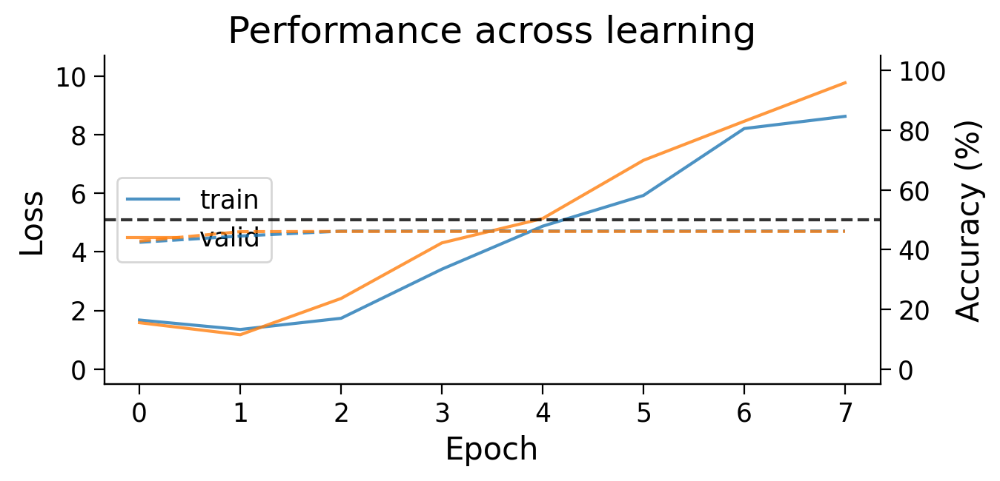

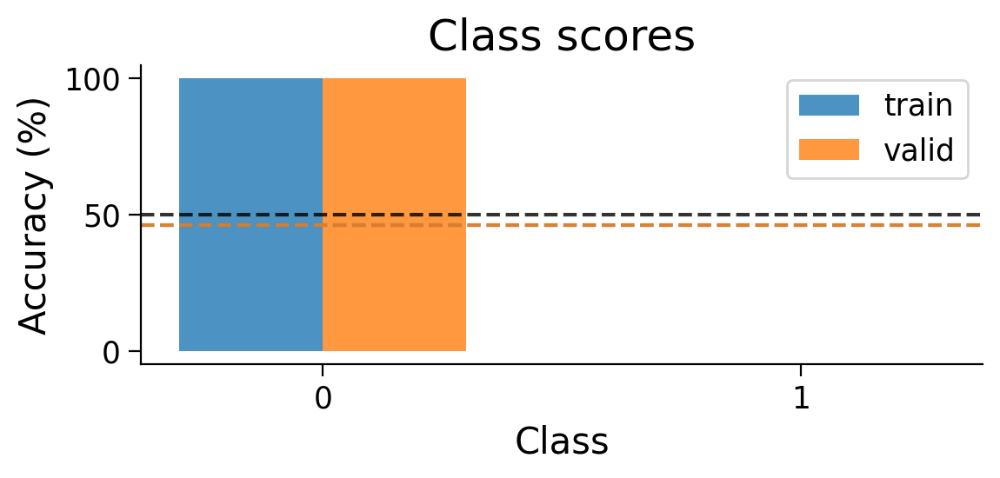

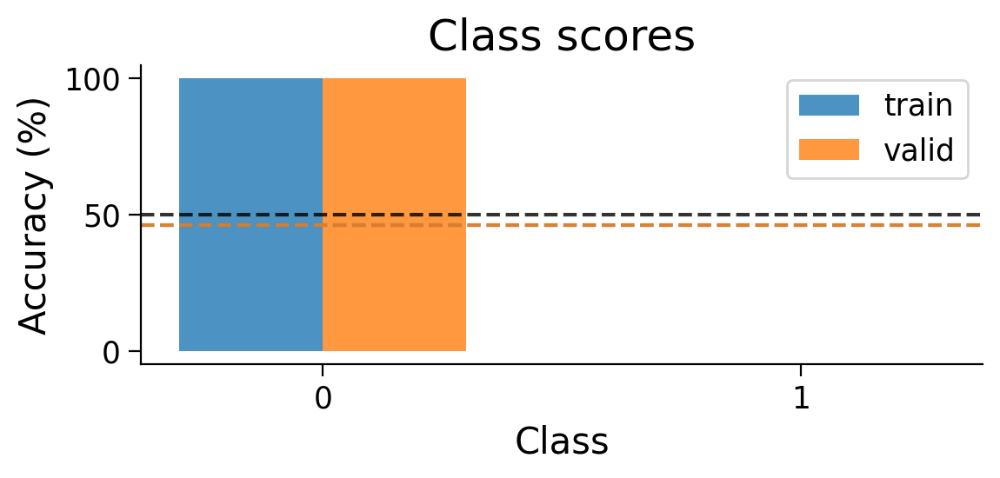

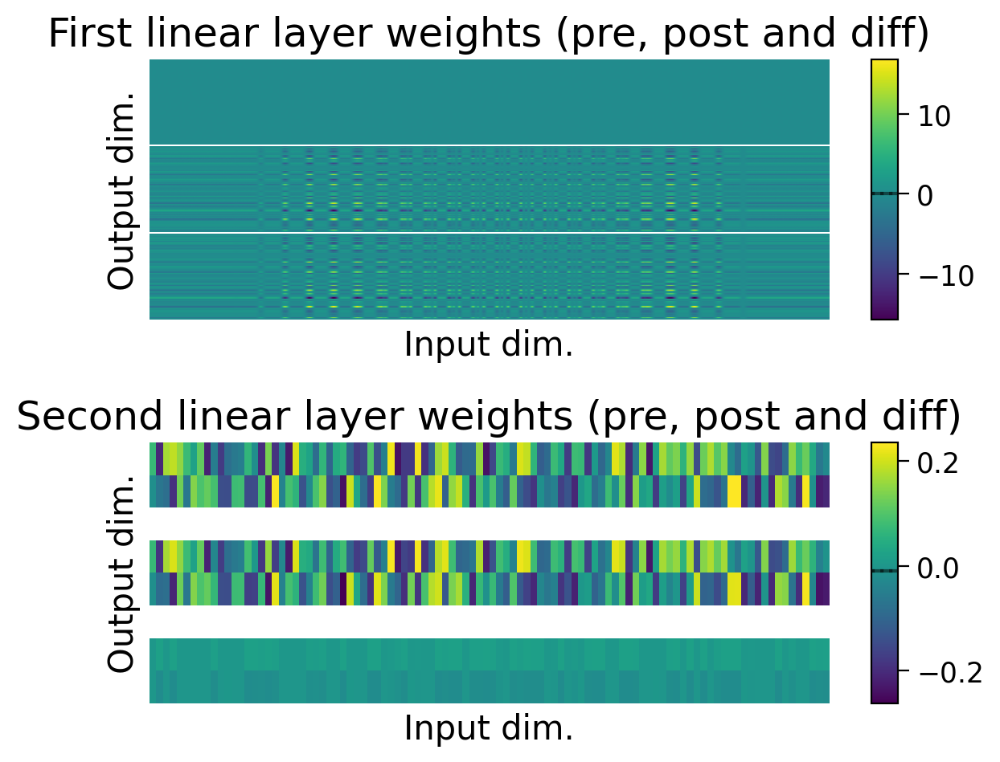

In [ ]:
HEBB_LR = 1e-6
HebbianSNN_2cls = HebbianSNN(
    num_hidden=100,
    num_outputs=2,  # Assuming 2-class classification for MNIST
    num_steps=25,
    beta=0.95,
    clamp_output=False,
).to(device)

Hebb_optimizer_2cls = BasicOptimizer(HebbianSNN_2cls.parameters(), lr=HEBB_LR)

Hebb_results_dict_2cls = train_model(
    HebbianSNN_2cls,
    train_loader_2cls,
    valid_loader_2cls,
    Hebb_optimizer_2cls,
    num_epochs=8
    );

plot_results(Hebb_results_dict_2cls, num_classes=2)
plot_scores_per_class(Hebb_results_dict_2cls, num_classes=2)
plot_scores_per_class(Hebb_results_dict_2cls, num_classes=2)
plot_weights(HebbianSNN_2cls);

#### Training SNNHebbian with targets on 2-class task

 12%|█▎        | 1/8 [00:07<00:50,  7.23s/it]

Epoch 1/8
Train Loss: 6.6182, Train Accuracy: 56.98%
Valid Loss: 6.5780, Valid Accuracy: 56.75%


 25%|██▌       | 2/8 [00:18<00:55,  9.31s/it]

Epoch 2/8
Train Loss: 6.6886, Train Accuracy: 56.42%
Valid Loss: 6.8708, Valid Accuracy: 55.29%


 38%|███▊      | 3/8 [00:28<00:49,  9.97s/it]

Epoch 3/8
Train Loss: 5.8126, Train Accuracy: 56.66%
Valid Loss: 5.1279, Valid Accuracy: 57.06%


 50%|█████     | 4/8 [00:39<00:41, 10.27s/it]

Epoch 4/8
Train Loss: 4.5859, Train Accuracy: 56.16%
Valid Loss: 4.5284, Valid Accuracy: 54.14%


 62%|██████▎   | 5/8 [00:49<00:30, 10.13s/it]

Epoch 5/8
Train Loss: 4.6416, Train Accuracy: 53.77%
Valid Loss: 4.7480, Valid Accuracy: 53.91%


 75%|███████▌  | 6/8 [00:59<00:20, 10.26s/it]

Epoch 6/8
Train Loss: 5.1764, Train Accuracy: 53.75%
Valid Loss: 5.4916, Valid Accuracy: 53.91%


 88%|████████▊ | 7/8 [01:10<00:10, 10.39s/it]

Epoch 7/8
Train Loss: 5.5845, Train Accuracy: 53.75%
Valid Loss: 5.5383, Valid Accuracy: 53.91%


100%|██████████| 8/8 [01:21<00:00, 10.16s/it]

Epoch 8/8
Train Loss: 5.5628, Train Accuracy: 53.75%
Valid Loss: 5.5307, Valid Accuracy: 53.91%


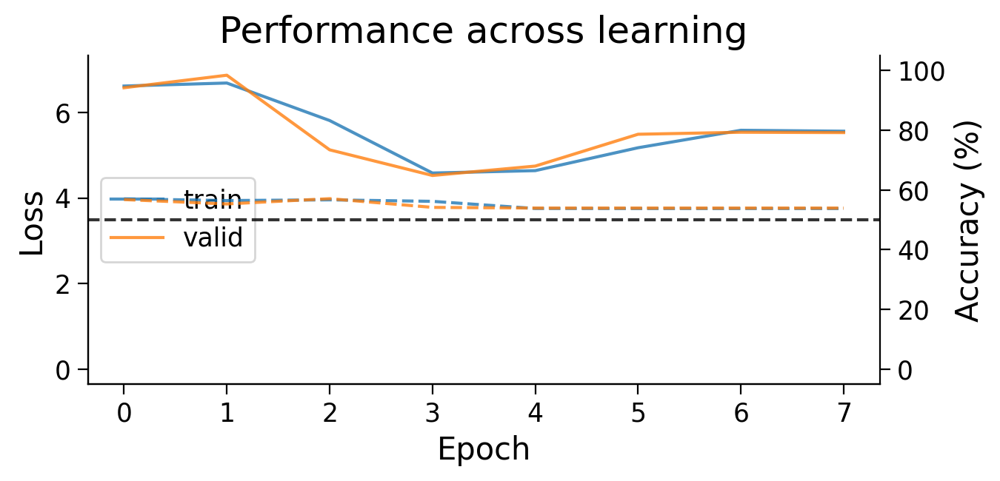

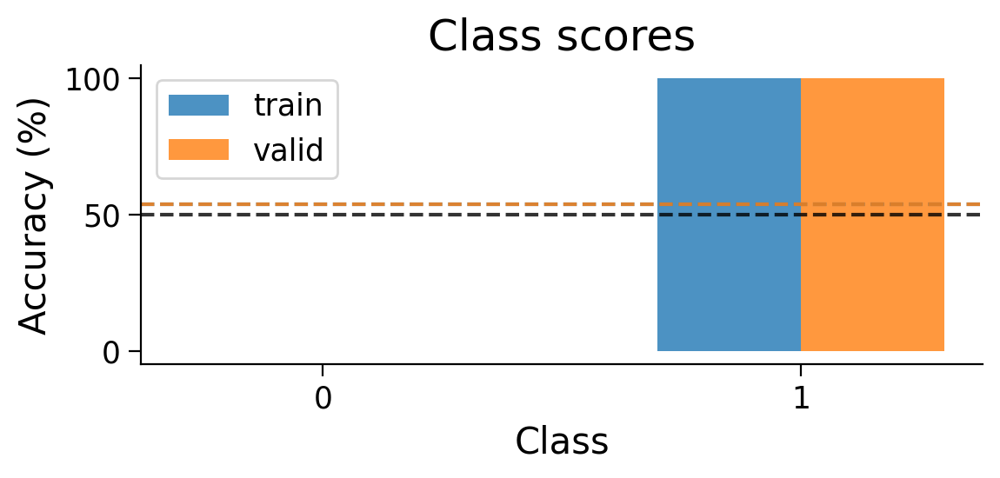

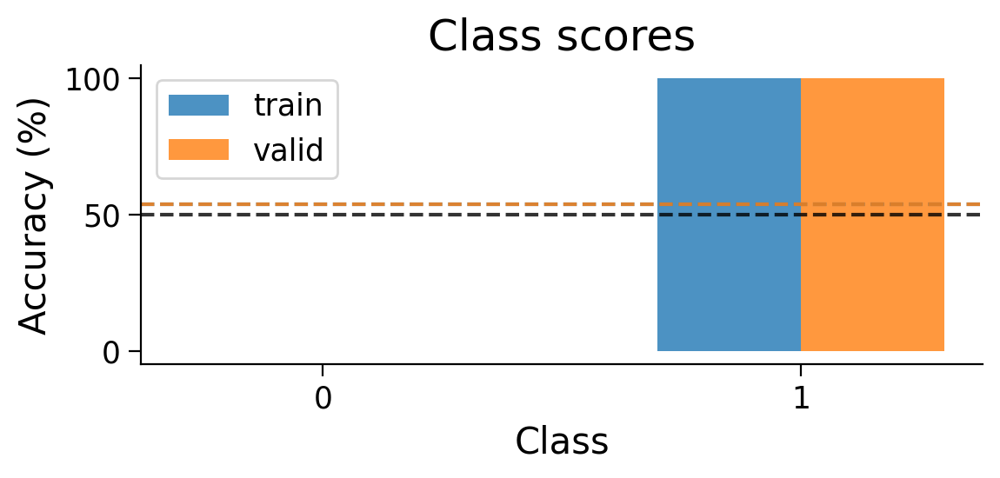

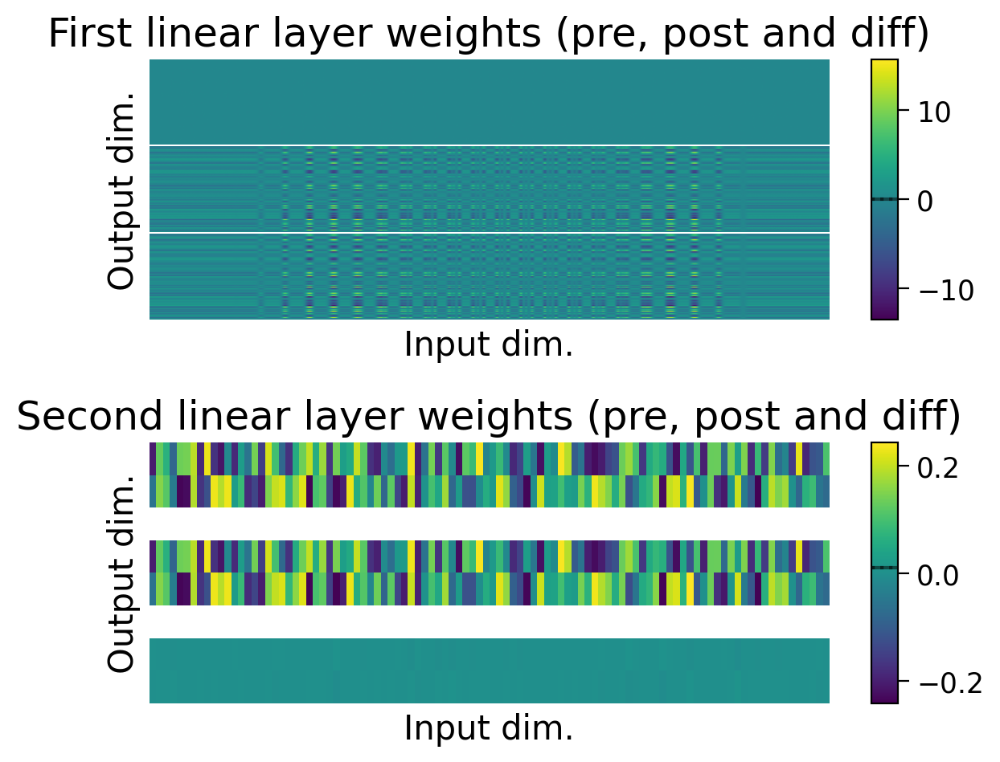

In [ ]:
HEBB_LR = 1e-6
HebbianSNN_2cls = HebbianSNN(
    num_hidden=100,
    num_outputs=2,  # Assuming 2-class classification for MNIST
    num_steps=25,
    beta=0.95,
    clamp_output=True,
)

Hebb_optimizer_2cls = BasicOptimizer(HebbianSNN_2cls.parameters(), lr=HEBB_LR)

Hebb_results_dict_2cls = train_model(
    HebbianSNN_2cls,
    train_loader_2cls,
    valid_loader_2cls,
    Hebb_optimizer_2cls,
    num_epochs=8
    );

plot_results(Hebb_results_dict_2cls, num_classes=2)
plot_scores_per_class(Hebb_results_dict_2cls, num_classes=2)
plot_scores_per_class(Hebb_results_dict_2cls, num_classes=2)
plot_weights(HebbianSNN_2cls);

#### Training SNNHebbian without targets on 10-class task

 12%|█▎        | 1/8 [00:33<03:55, 33.68s/it]

Epoch 1/8
Train Loss: 14.4540, Train Accuracy: 8.62%
Valid Loss: 14.5196, Valid Accuracy: 8.57%


 25%|██▌       | 2/8 [01:22<04:16, 42.69s/it]

Epoch 2/8
Train Loss: 15.5520, Train Accuracy: 9.27%
Valid Loss: 15.1762, Valid Accuracy: 10.19%


 38%|███▊      | 3/8 [02:14<03:53, 46.70s/it]

Epoch 3/8
Train Loss: 14.8838, Train Accuracy: 10.09%
Valid Loss: 14.7209, Valid Accuracy: 10.19%


 50%|█████     | 4/8 [03:03<03:11, 47.80s/it]

Epoch 4/8
Train Loss: 14.3584, Train Accuracy: 10.09%
Valid Loss: 13.6726, Valid Accuracy: 10.19%


 62%|██████▎   | 5/8 [04:01<02:33, 51.29s/it]

Epoch 5/8
Train Loss: 13.6954, Train Accuracy: 11.25%
Valid Loss: 13.6281, Valid Accuracy: 11.72%


 75%|███████▌  | 6/8 [04:59<01:47, 53.68s/it]

Epoch 6/8
Train Loss: 13.6964, Train Accuracy: 11.23%
Valid Loss: 13.6281, Valid Accuracy: 11.72%


 88%|████████▊ | 7/8 [05:58<00:55, 55.28s/it]

Epoch 7/8
Train Loss: 13.6964, Train Accuracy: 11.23%
Valid Loss: 13.6281, Valid Accuracy: 11.72%


100%|██████████| 8/8 [06:56<00:00, 52.11s/it]

Epoch 8/8
Train Loss: 13.6964, Train Accuracy: 11.23%
Valid Loss: 13.6281, Valid Accuracy: 11.72%


<Axes: title={'center': 'Class scores'}, xlabel='Class', ylabel='Accuracy (%)'>

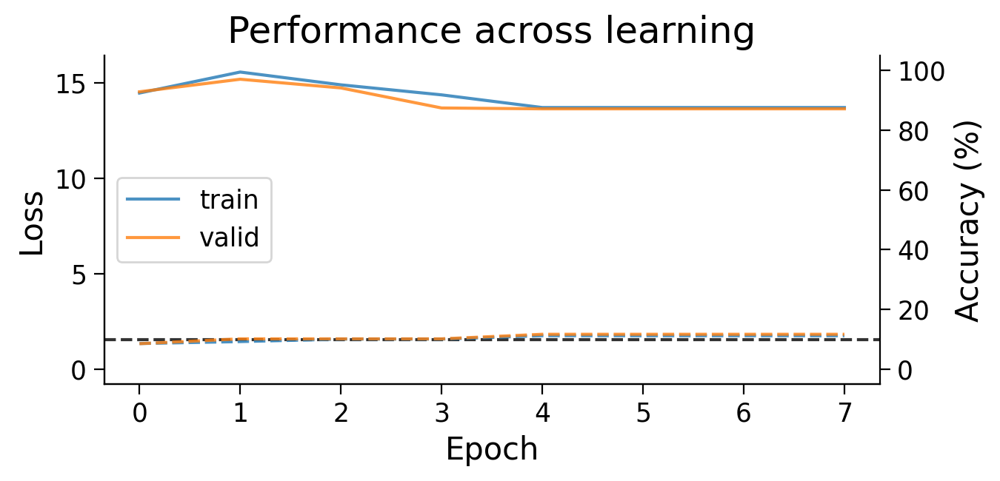

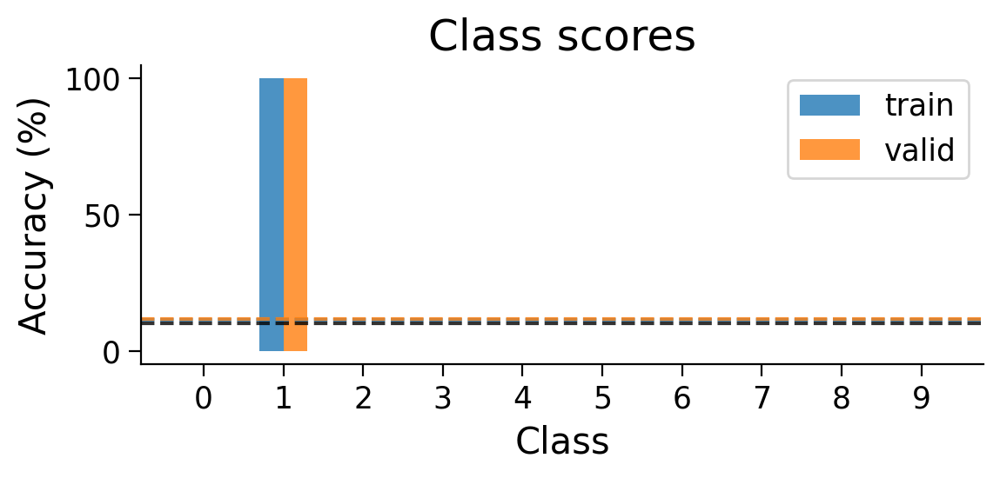

In [ ]:
# Define a learning rate for Hebbian learning
HEBB_LR = 1e-6

# Initialize the Hebbian-based SNN with clamping and gradient clipping
hebbian_snn = HebbianSNN(
    num_hidden=100,
    num_outputs=10,  # Assuming 10-class classification for MNIST
    num_steps=25,
    beta=0.95,
    clamp_output=False
)

# Initialize the optimizer for the Hebbian-based SNN
hebbian_optimizer = BasicOptimizer(hebbian_snn.parameters(), lr=HEBB_LR)

# Assuming train_loader and valid_loader are defined
# Train the Hebbian-based SNN
hebbian_results_dict = train_model(
    hebbian_snn,
    train_loader,
    valid_loader,
    hebbian_optimizer,
    num_epochs=8
)


# Plot results for the Hebbian-based SNN
plot_results(hebbian_results_dict, num_classes=10)
plot_scores_per_class(hebbian_results_dict, num_classes=10)


#### Training SNNHebbian with targets on 10-class task

 12%|█▎        | 1/8 [00:34<04:02, 34.64s/it]

Epoch 1/8
Train Loss: 18.5788, Train Accuracy: 5.19%
Valid Loss: 18.7089, Valid Accuracy: 5.20%


 25%|██▌       | 2/8 [01:25<04:23, 43.90s/it]

Epoch 2/8
Train Loss: 18.6225, Train Accuracy: 5.26%
Valid Loss: 18.8573, Valid Accuracy: 5.68%


 38%|███▊      | 3/8 [02:14<03:52, 46.59s/it]

Epoch 3/8
Train Loss: 18.7569, Train Accuracy: 5.97%
Valid Loss: 18.9903, Valid Accuracy: 6.13%


 50%|█████     | 4/8 [03:04<03:11, 47.88s/it]

Epoch 4/8
Train Loss: 18.8708, Train Accuracy: 6.34%
Valid Loss: 18.9259, Valid Accuracy: 6.30%


 62%|██████▎   | 5/8 [03:55<02:26, 48.86s/it]

Epoch 5/8
Train Loss: 18.5908, Train Accuracy: 6.27%
Valid Loss: 18.3526, Valid Accuracy: 5.78%


 75%|███████▌  | 6/8 [04:45<01:38, 49.38s/it]

Epoch 6/8
Train Loss: 17.9114, Train Accuracy: 5.61%
Valid Loss: 17.6528, Valid Accuracy: 4.95%


 88%|████████▊ | 7/8 [05:36<00:49, 49.71s/it]

Epoch 7/8
Train Loss: 17.3438, Train Accuracy: 5.30%
Valid Loss: 17.2571, Valid Accuracy: 5.45%


100%|██████████| 8/8 [06:26<00:00, 48.32s/it]

Epoch 8/8
Train Loss: 17.0699, Train Accuracy: 5.41%
Valid Loss: 17.0272, Valid Accuracy: 5.07%


<Axes: title={'center': 'Class scores'}, xlabel='Class', ylabel='Accuracy (%)'>

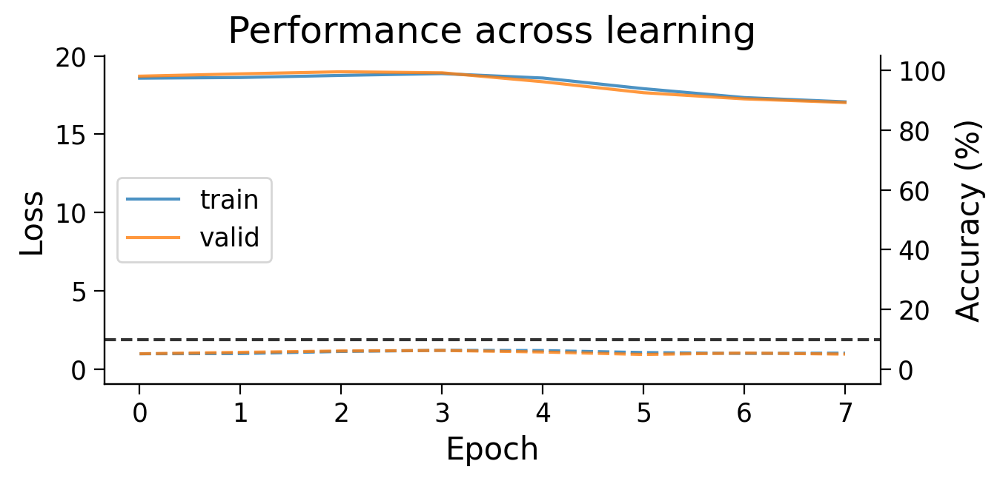

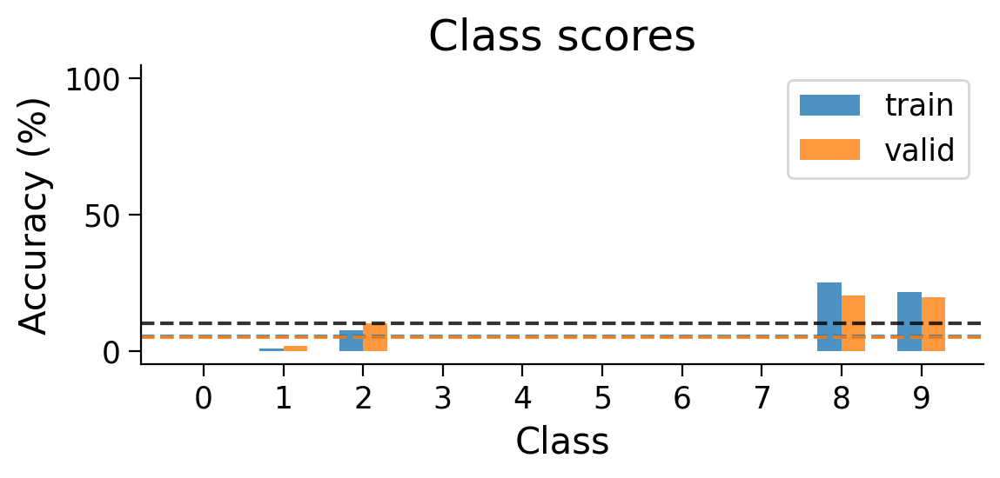

In [ ]:
# Define a learning rate for Hebbian learning
HEBB_LR = 1e-7

# Initialize the Hebbian-based SNN with clamping and gradient clipping
hebbian_snn = HebbianSNN(
    num_hidden=100,
    num_outputs=10,  # Assuming 10-class classification for MNIST
    num_steps=25,
    beta=0.95,
    clamp_output=True,
)

# Initialize the optimizer for the Hebbian-based SNN
hebbian_optimizer = BasicOptimizer(hebbian_snn.parameters(), lr=HEBB_LR)

# Assuming train_loader and valid_loader are defined
# Train the Hebbian-based SNN
hebbian_results_dict = train_model(
    hebbian_snn,
    train_loader,
    valid_loader,
    hebbian_optimizer,
    num_epochs=8
)


# Plot results for the Hebbian-based SNN
plot_results(hebbian_results_dict, num_classes=10)
plot_scores_per_class(hebbian_results_dict, num_classes=10)


# Feedback alignment SNN

### Feedback alignment function

In [ ]:
import torch
import torch.nn as nn
from torch.autograd import Function
import snntorch as snn


class LinearFAFunction(Function):
    @staticmethod
    def forward(ctx, input, weight, weight_fa, bias=None):
        ctx.save_for_backward(input, weight, weight_fa, bias)
        output = input.mm(weight.t())
        if bias is not None:
            output += bias.unsqueeze(0).expand_as(output)
        return output

    @staticmethod
    def backward(ctx, grad_output):
        input, weight, weight_fa, bias = ctx.saved_tensors
        grad_input = grad_weight = grad_weight_fa = grad_bias = None
        if ctx.needs_input_grad[0]:
            grad_input = grad_output.mm(weight_fa)
        if ctx.needs_input_grad[1]:
            grad_weight = grad_output.t().mm(input)
        if ctx.needs_input_grad[2]:
            grad_weight_fa = grad_output.t().mm(input)
        if bias is not None and ctx.needs_input_grad[3]:
            grad_bias = grad_output.sum(0).squeeze(0)
        return grad_input, grad_weight, grad_weight_fa, grad_bias


class FALinear(nn.Module):
    def __init__(self, input_features, output_features, bias=True):
        super(FALinear, self).__init__()
        self.input_features = input_features
        self.output_features = output_features

        self.weight = nn.Parameter(torch.Tensor(output_features, input_features))
        if bias:
            self.bias = nn.Parameter(torch.Tensor(output_features))
        else:
            self.register_parameter('bias', None)

        self.weight_fa = nn.Parameter(torch.rand(output_features, input_features, requires_grad=False).to(self.weight.device))

        torch.nn.init.kaiming_uniform_(self.weight)
        torch.nn.init.kaiming_uniform_(self.weight_fa)
        torch.nn.init.constant_(self.bias, 1)

    def forward(self, input):
        return LinearFAFunction.apply(input, self.weight, self.weight_fa, self.bias)

### Feedback alignment SNN definition

In [ ]:
class FeedbackAlignmentSNN(nn.Module):
    def __init__(self, num_inputs=28*28, num_hidden=100, num_outputs=10, num_steps=25, beta=0.95, clamp_output=None):
        super(FeedbackAlignmentSNN, self).__init__()
        self.num_inputs = num_inputs
        self.num_hidden = num_hidden
        self.num_outputs = num_outputs
        self.num_steps = num_steps
        self.beta = beta
        self.clamp_output = clamp_output

        self.fc1 = FALinear(num_inputs, num_hidden)
        self.lif1 = snn.Leaky(beta=beta)
        self.fc2 = FALinear(num_hidden, num_outputs)
        self.lif2 = snn.Leaky(beta=beta)

        self._initialize_weights()
        self._store_initial_weights_biases()  # Added to store initial weights and biases
        self.activations = {}  # Initialize activations dictionary

    def _initialize_weights(self):
        torch.nn.init.xavier_uniform_(self.fc1.weight)
        torch.nn.init.xavier_uniform_(self.fc2.weight)
        torch.nn.init.xavier_uniform_(self.fc1.weight_fa)  # Ensure weight_fa is initialized
        torch.nn.init.xavier_uniform_(self.fc2.weight_fa)  # Ensure weight_fa is initialized
        if self.fc1.bias is not None:
            torch.nn.init.zeros_(self.fc1.bias)
        if self.fc2.bias is not None:
            torch.nn.init.zeros_(self.fc2.bias)

    def _store_initial_weights_biases(self):
        """
        Stores a copy of the network's initial weights and biases.
        """
        self.init_fc1_weight = self.fc1.weight.data.clone()
        self.init_fc2_weight = self.fc2.weight.data.clone()
        self.init_fc1_weight_fa = self.fc1.weight_fa.data.clone()
        self.init_fc2_weight_fa = self.fc2.weight_fa.data.clone()
        if self.fc1.bias is not None:
            self.init_fc1_bias = self.fc1.bias.data.clone()
        if self.fc2.bias is not None:
            self.init_fc2_bias = self.fc2.bias.data.clone()

    def forward(self, x, target=None):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)  # Flatten the input to a 2D matrix
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = LinearFAFunction.apply(x, self.fc1.weight, self.fc1.weight_fa, self.fc1.bias)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = LinearFAFunction.apply(spk1, self.fc2.weight, self.fc2.weight_fa, self.fc2.bias)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def forward_backprop(self, x):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = self.fc1(x)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = self.fc2(spk1)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def list_parameters(self):
        """
        Returns a list of model names for a gradient dictionary.

        Returns:
        - params_list (list): List of parameter names.
        """
        params_list = list()

        for layer_str in ["fc1", "fc2"]:
            params_list.append(f"{layer_str}_weight")
            params_list.append(f"{layer_str}_weight_fa")
            if getattr(self, layer_str).bias is not None:
                params_list.append(f"{layer_str}_bias")

        return params_list

    def gather_gradient_dict(self):
        """
        Gathers a gradient dictionary for the model's parameters. Raises a
        runtime error if any parameters have no gradients.

        Returns:
        - gradient_dict (dict): A dictionary of gradients for each parameter.
        """
        params_list = self.list_parameters()

        gradient_dict = dict()
        for param_name in params_list:
            if param_name.endswith("_weight_fa"):
              layer_str, param_str = param_name.split("_", 1)
            else:
              layer_str, param_str = param_name.split("_")
            layer = getattr(self, layer_str)
            grad = getattr(layer, param_str).grad
            if grad is None:
                raise RuntimeError(f"No gradient was computed for parameter {param_name}")
            gradient_dict[param_name] = grad.detach().clone().numpy()

        return gradient_dict


### Training FA SNN on 2-class task

 12%|█▎        | 1/8 [00:06<00:43,  6.20s/it]

Epoch 1/8
Train Loss: 0.6974, Train Accuracy: 47.45%
Valid Loss: 0.6709, Valid Accuracy: 47.01%


 25%|██▌       | 2/8 [00:15<00:49,  8.31s/it]

Epoch 2/8
Train Loss: 0.1306, Train Accuracy: 90.65%
Valid Loss: 0.0169, Valid Accuracy: 98.77%


 38%|███▊      | 3/8 [00:25<00:45,  9.02s/it]

Epoch 3/8
Train Loss: 0.0206, Train Accuracy: 99.22%
Valid Loss: 0.0051, Valid Accuracy: 99.54%


 50%|█████     | 4/8 [00:34<00:36,  9.05s/it]

Epoch 4/8
Train Loss: 0.0110, Train Accuracy: 99.40%
Valid Loss: 0.0070, Valid Accuracy: 99.23%


 62%|██████▎   | 5/8 [00:44<00:27,  9.29s/it]

Epoch 5/8
Train Loss: 0.0045, Train Accuracy: 99.66%
Valid Loss: 0.0049, Valid Accuracy: 99.62%


 75%|███████▌  | 6/8 [00:54<00:19,  9.51s/it]

Epoch 6/8
Train Loss: 0.0037, Train Accuracy: 99.80%
Valid Loss: 0.0087, Valid Accuracy: 99.46%


 88%|████████▊ | 7/8 [01:04<00:09,  9.62s/it]

Epoch 7/8
Train Loss: 0.0065, Train Accuracy: 99.54%
Valid Loss: 0.0053, Valid Accuracy: 99.39%


100%|██████████| 8/8 [01:13<00:00,  9.22s/it]

Epoch 8/8
Train Loss: 0.0033, Train Accuracy: 99.74%
Valid Loss: 0.0043, Valid Accuracy: 99.54%


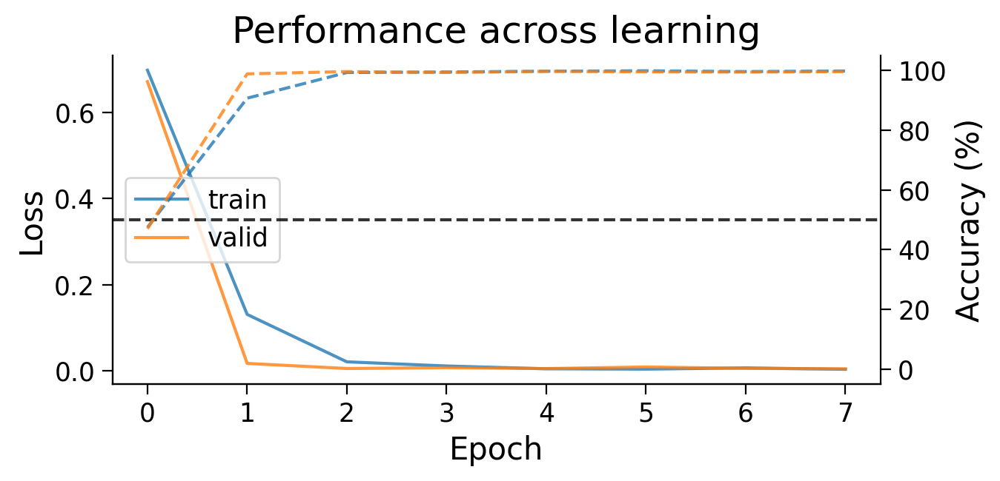

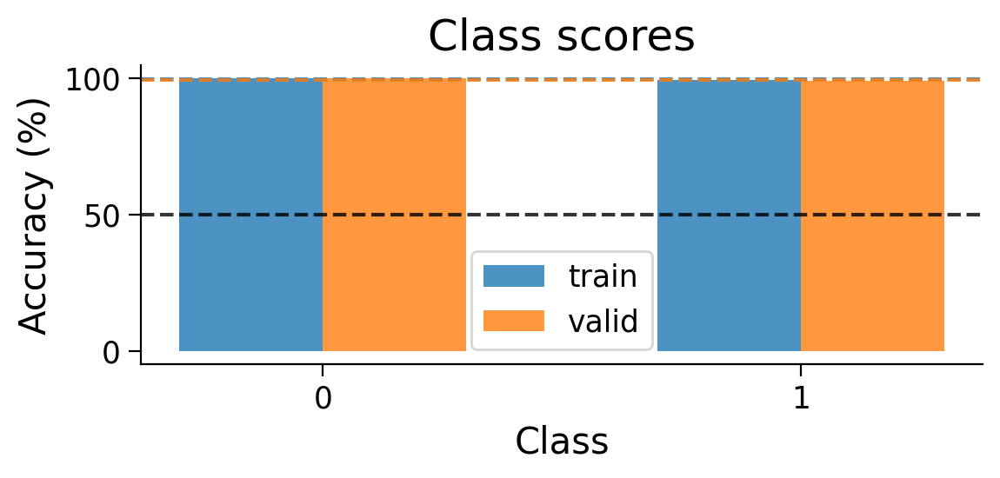

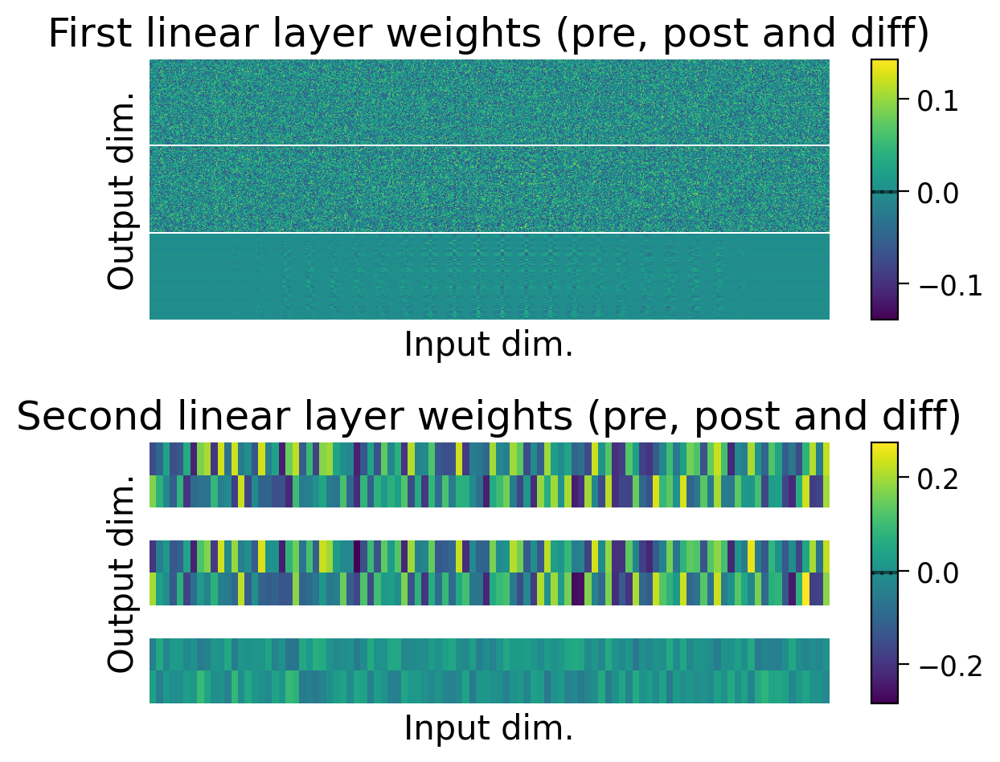

In [ ]:
# Instantiate the models with correct number of outputs
fa_snn_2cls = FeedbackAlignmentSNN(
    num_hidden=100,
    num_outputs=2,  # Set to 2 for 2 classes
    num_steps=25,
    beta=0.95,
)
# Define the optimizer
fa_optimizer_2cls = BasicOptimizer(fa_snn_2cls.parameters(), lr=1e-3)

fa_results_dict_2cls = train_model(fa_snn_2cls, train_loader_2cls, valid_loader_2cls, fa_optimizer_2cls, num_epochs=8);

plot_results(fa_results_dict_2cls, num_classes=2)
plot_scores_per_class(fa_results_dict_2cls, num_classes=2)
plot_weights(fa_snn_2cls);

### Training FA SNN on 10-class task

 12%|█▎        | 1/8 [00:32<03:46, 32.39s/it]

Epoch 1/8
Train Loss: 13.0947, Train Accuracy: 8.93%
Valid Loss: 13.0491, Valid Accuracy: 8.82%


 25%|██▌       | 2/8 [01:17<03:59, 39.95s/it]

Epoch 2/8
Train Loss: 2.1961, Train Accuracy: 17.90%
Valid Loss: 2.0721, Valid Accuracy: 20.22%


 38%|███▊      | 3/8 [02:04<03:34, 42.99s/it]

Epoch 3/8
Train Loss: 2.0118, Train Accuracy: 21.63%
Valid Loss: 1.8296, Valid Accuracy: 27.40%


 50%|█████     | 4/8 [02:49<02:55, 43.95s/it]

Epoch 4/8
Train Loss: 1.7686, Train Accuracy: 27.39%
Valid Loss: 1.7639, Valid Accuracy: 26.47%


 62%|██████▎   | 5/8 [03:36<02:14, 44.95s/it]

Epoch 5/8
Train Loss: 1.7228, Train Accuracy: 28.17%
Valid Loss: 1.7362, Valid Accuracy: 28.04%


 75%|███████▌  | 6/8 [04:22<01:30, 45.19s/it]

Epoch 6/8
Train Loss: 1.6824, Train Accuracy: 30.64%
Valid Loss: 1.5720, Valid Accuracy: 36.81%


 88%|████████▊ | 7/8 [05:08<00:45, 45.59s/it]

Epoch 7/8
Train Loss: 1.5269, Train Accuracy: 39.14%
Valid Loss: 1.5011, Valid Accuracy: 41.24%


100%|██████████| 8/8 [05:54<00:00, 44.30s/it]

Epoch 8/8
Train Loss: 1.4582, Train Accuracy: 42.45%
Valid Loss: 1.3311, Valid Accuracy: 49.34%


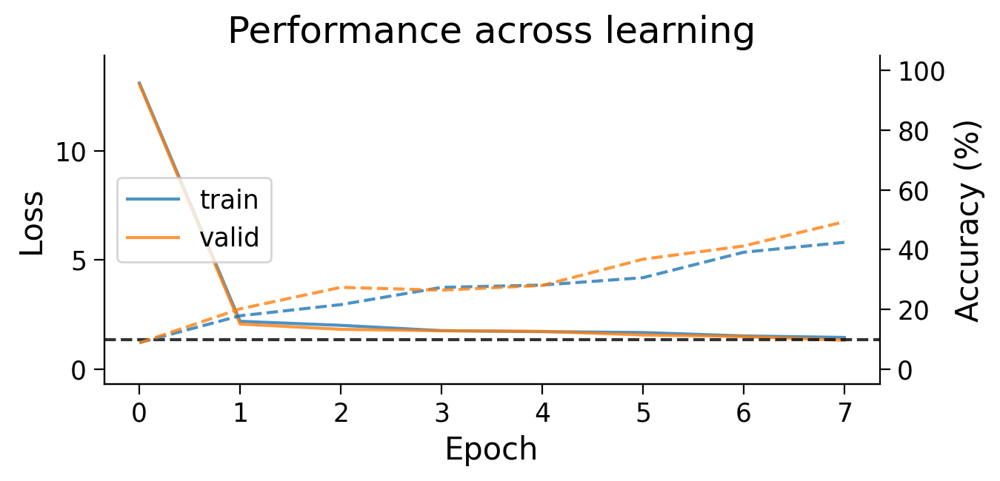

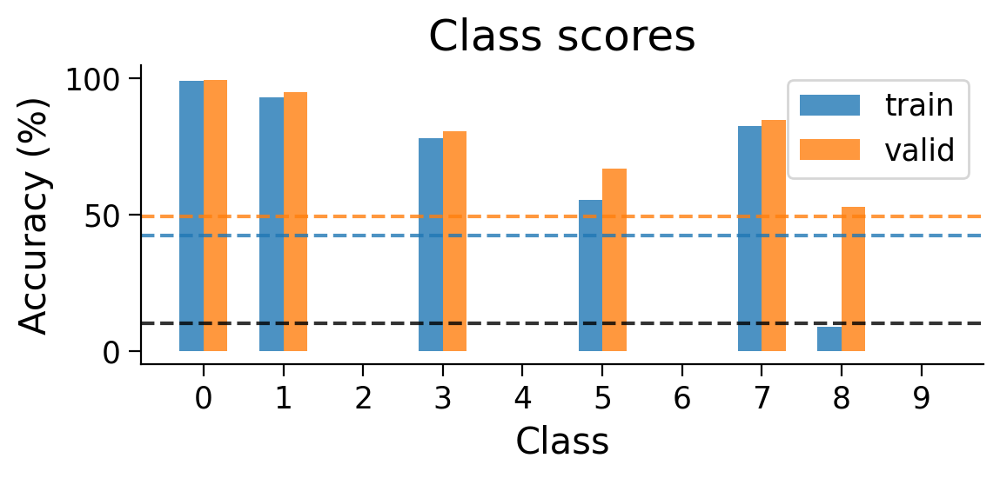

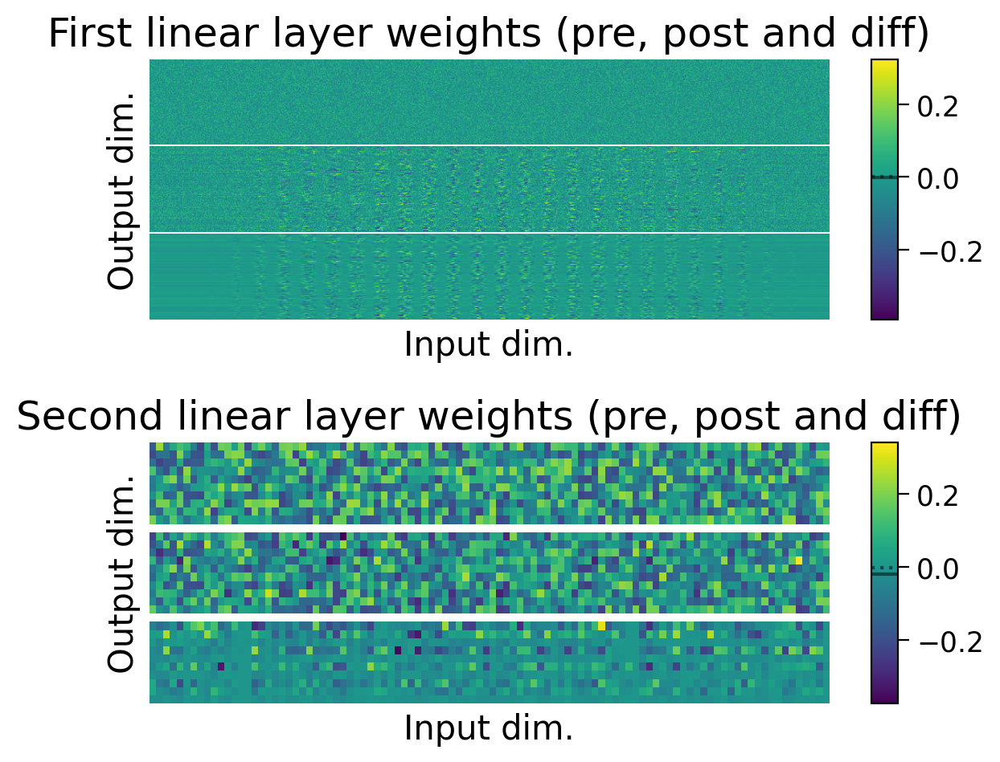

In [ ]:
# Instantiate the models with correct number of outputs
fa_snn = FeedbackAlignmentSNN(
    num_hidden=100,
    num_outputs=10,  # Set to 10 for MNIST
    num_steps=25,
    beta=0.95,
)
# Define the optimizer
fa_optimizer = BasicOptimizer(fa_snn.parameters(), lr=1e-3)

fa_results_dict = train_model(fa_snn, train_loader, valid_loader, fa_optimizer, num_epochs=8);

plot_results(fa_results_dict, num_classes=10)
plot_scores_per_class(fa_results_dict, num_classes=10)
plot_weights(fa_snn);

# Kolen-Pollack SNN

### Kolen-Pollack function

In [ ]:
class LinearKPFunction(LinearFAFunction):
    @staticmethod
    def backward(ctx, grad_output):
        grad_input, grad_weight, grad_weight_fa, grad_bias = LinearFAFunction.backward(ctx, grad_output)
        grad_weight_fa = grad_weight
        return grad_input, grad_weight, grad_weight_fa, grad_bias


class KPLinear(FALinear):
    def __init__(self, input_features, output_features, bias=True):
        super(KPLinear, self).__init__(input_features, output_features, bias)

    def forward(self, input):
        return LinearKPFunction.apply(input, self.weight, self.weight_fa, self.bias)


### Kolen-Pollack SNN definition

In [ ]:
class KolenPollackSNN(nn.Module):
    def __init__(self, num_inputs=28*28, num_hidden=100, num_outputs=10, num_steps=25, beta=0.95, clamp_output=False):
        super(KolenPollackSNN, self).__init__()
        self.num_inputs = num_inputs
        self.num_hidden = num_hidden
        self.num_outputs = num_outputs
        self.num_steps = num_steps
        self.beta = beta
        self.clamp_output = clamp_output

        self.fc1 = KPLinear(num_inputs, num_hidden)
        self.lif1 = snn.Leaky(beta=beta)
        self.fc2 = KPLinear(num_hidden, num_outputs)
        self.lif2 = snn.Leaky(beta=beta)

        self._initialize_weights()
        self._store_initial_weights_biases()  # Added to store initial weights and biases
        self.activations = {}  # Initialize activations dictionary

    def _initialize_weights(self):
        torch.nn.init.xavier_uniform_(self.fc1.weight)
        torch.nn.init.xavier_uniform_(self.fc2.weight)
        torch.nn.init.xavier_uniform_(self.fc1.weight_fa)  # Ensure weight_fa is initialized
        torch.nn.init.xavier_uniform_(self.fc2.weight_fa)  # Ensure weight_fa is initialized
        if self.fc1.bias is not None:
            torch.nn.init.zeros_(self.fc1.bias)
        if self.fc2.bias is not None:
            torch.nn.init.zeros_(self.fc2.bias)

    def _store_initial_weights_biases(self):
        """
        Stores a copy of the network's initial weights and biases.
        """
        self.init_fc1_weight = self.fc1.weight.data.clone()
        self.init_fc2_weight = self.fc2.weight.data.clone()
        self.init_fc1_weight_fa = self.fc1.weight_fa.data.clone()
        self.init_fc2_weight_fa = self.fc2.weight_fa.data.clone()
        if self.fc1.bias is not None:
            self.init_fc1_bias = self.fc1.bias.data.clone()
        if self.fc2.bias is not None:
            self.init_fc2_bias = self.fc2.bias.data.clone()

    def forward(self, x, target=None):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)  # Flatten the input to a 2D matrix
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = LinearKPFunction.apply(x, self.fc1.weight, self.fc1.weight_fa, self.fc1.bias)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = LinearKPFunction.apply(spk1, self.fc2.weight, self.fc2.weight_fa, self.fc2.bias)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def forward_backprop(self, x):
        self.activations = {}  # Reset activations
        x = x.view(x.size(0), -1)
        mem1 = self.lif1.init_leaky()
        mem2 = self.lif2.init_leaky()

        spk2_rec = []
        mem2_rec = []

        for step in range(self.num_steps):
            cur1 = self.fc1(x)
            spk1, mem1 = self.lif1(cur1, mem1)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc1'] = mem1.detach().cpu().numpy()  # Record activations
            cur2 = self.fc2(spk1)
            spk2, mem2 = self.lif2(cur2, mem2)
            if step == self.num_steps - 1:  # Take the last representation
                self.activations[f'step_{step}_fc2'] = mem2.detach().cpu().numpy()  # Record activations
            spk2_rec.append(spk2)
            mem2_rec.append(mem2)

        return torch.stack(spk2_rec, dim=0), torch.stack(mem2_rec, dim=0)

    def list_parameters(self):
        """
        Returns a list of model names for a gradient dictionary.

        Returns:
        - params_list (list): List of parameter names.
        """
        params_list = list()

        for layer_str in ["fc1", "fc2"]:
            params_list.append(f"{layer_str}_weight")
            params_list.append(f"{layer_str}_weight_fa")
            if getattr(self, layer_str).bias is not None:
                params_list.append(f"{layer_str}_bias")

        return params_list

    def gather_gradient_dict(self):
        """
        Gathers a gradient dictionary for the model's parameters. Raises a
        runtime error if any parameters have no gradients.

        Returns:
        - gradient_dict (dict): A dictionary of gradients for each parameter.
        """
        params_list = self.list_parameters()

        gradient_dict = dict()
        for param_name in params_list:
            if param_name.endswith("_weight_fa"):
              layer_str, param_str = param_name.split("_", 1)
            else:
              layer_str, param_str = param_name.split("_")
            layer = getattr(self, layer_str)
            grad = getattr(layer, param_str).grad
            if grad is None:
                raise RuntimeError(f"No gradient was computed for parameter {param_name}")
            gradient_dict[param_name] = grad.detach().clone().numpy()

        return gradient_dict


### Training KP SNN on 2-class task

 12%|█▎        | 1/8 [00:06<00:45,  6.48s/it]

Epoch 1/8
Train Loss: 1.8736, Train Accuracy: 49.42%
Valid Loss: 1.9334, Valid Accuracy: 49.23%


 25%|██▌       | 2/8 [00:16<00:49,  8.33s/it]

Epoch 2/8
Train Loss: 0.1727, Train Accuracy: 84.51%
Valid Loss: 0.0299, Valid Accuracy: 98.31%


 38%|███▊      | 3/8 [00:25<00:45,  9.02s/it]

Epoch 3/8
Train Loss: 0.0128, Train Accuracy: 99.36%
Valid Loss: 0.0177, Valid Accuracy: 99.08%


 50%|█████     | 4/8 [00:35<00:37,  9.35s/it]

Epoch 4/8
Train Loss: 0.0103, Train Accuracy: 99.54%
Valid Loss: 0.0098, Valid Accuracy: 99.08%


 62%|██████▎   | 5/8 [00:45<00:27,  9.30s/it]

Epoch 5/8
Train Loss: 0.0076, Train Accuracy: 99.70%
Valid Loss: 0.0052, Valid Accuracy: 99.69%


 75%|███████▌  | 6/8 [00:54<00:18,  9.38s/it]

Epoch 6/8
Train Loss: 0.0046, Train Accuracy: 99.86%
Valid Loss: 0.0086, Valid Accuracy: 99.85%


 88%|████████▊ | 7/8 [01:04<00:09,  9.50s/it]

Epoch 7/8
Train Loss: 0.0075, Train Accuracy: 99.76%
Valid Loss: 0.0065, Valid Accuracy: 99.54%


100%|██████████| 8/8 [01:14<00:00,  9.28s/it]

Epoch 8/8
Train Loss: 0.0067, Train Accuracy: 99.80%
Valid Loss: 0.0042, Valid Accuracy: 99.54%


array([<Axes: title={'center': 'First linear layer weights (pre, post and diff)'}, xlabel='Input dim.', ylabel='Output dim.'>,
       <Axes: title={'center': 'Second linear layer weights (pre, post and diff)'}, xlabel='Input dim.', ylabel='Output dim.'>],
      dtype=object)

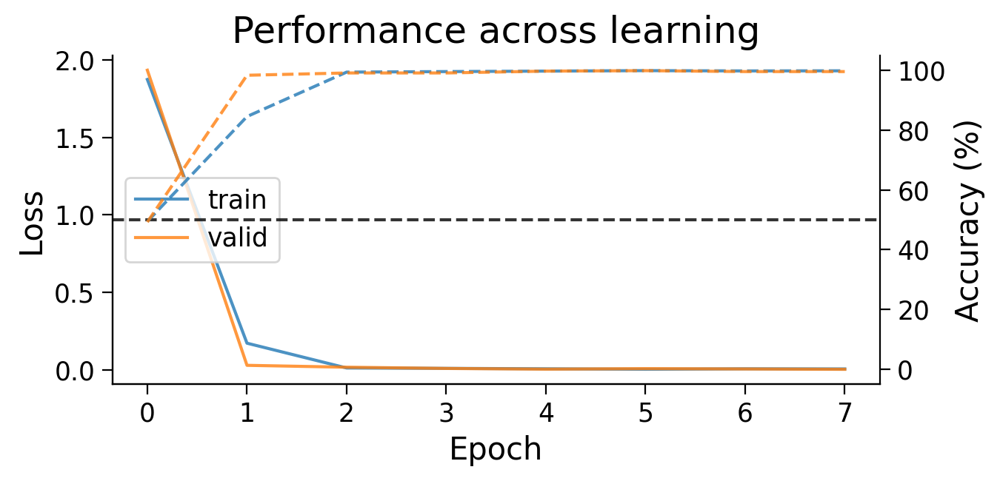

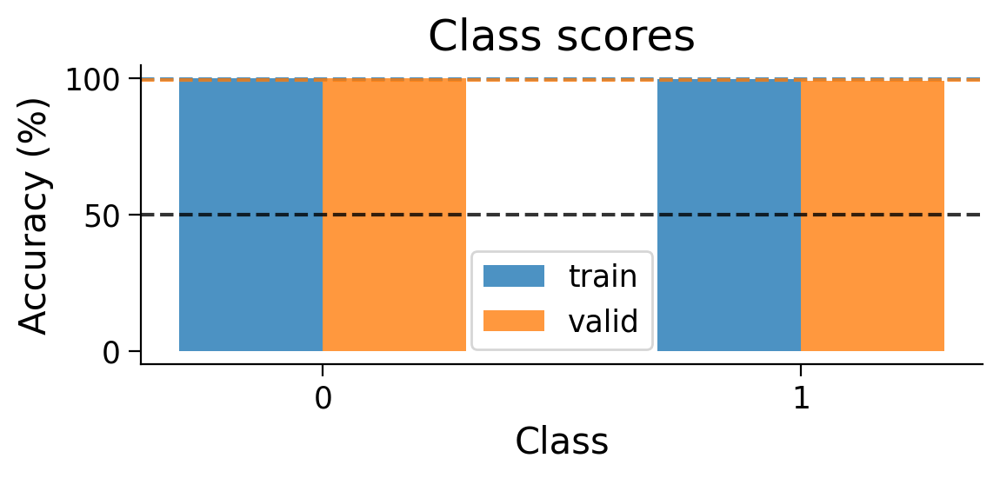

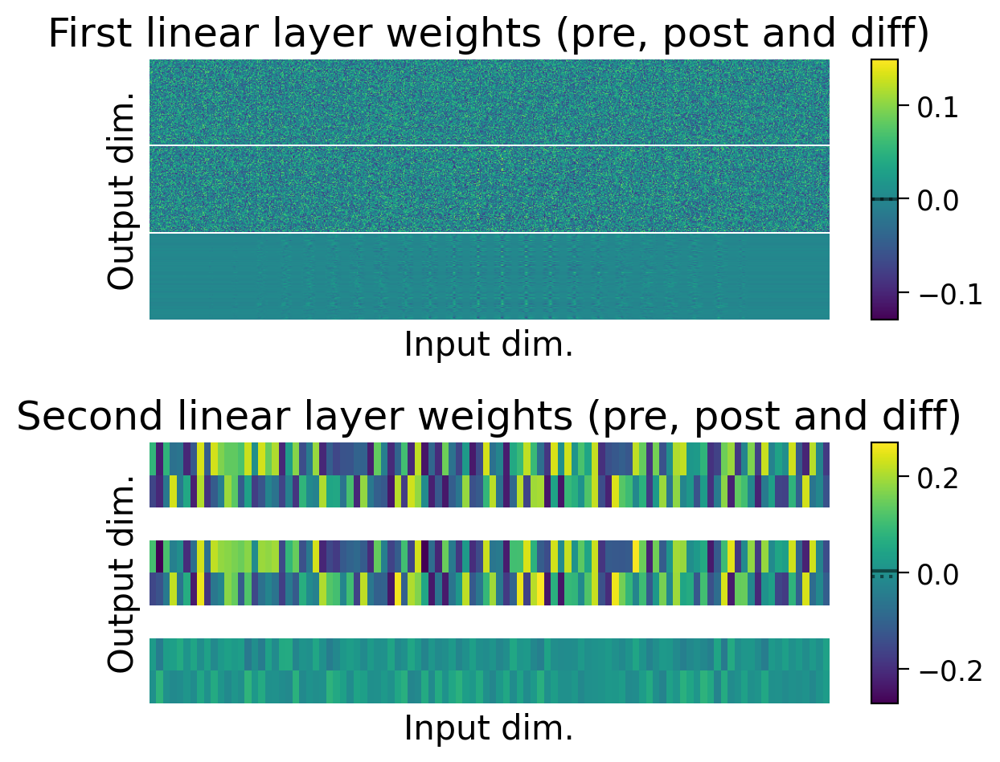

In [ ]:
kp_snn_2cls = KolenPollackSNN(
    num_hidden=100,
    num_outputs=2,  # Set to 2 for 2 classes
    num_steps=25,
    beta=0.95,
)

# Define the optimizer
kp_optimizer_2cls = BasicOptimizer(kp_snn_2cls.parameters(), lr=1e-3)

# Assuming train_loader and valid_loader are defined

# Train the Kolen-Pollack SNN
kp_results_dict_2cls = train_model(kp_snn_2cls, train_loader_2cls, valid_loader_2cls, kp_optimizer_2cls, num_epochs=8)

# Plot the weights for the trained models
plot_results(kp_results_dict_2cls, num_classes=2)
plot_scores_per_class(kp_results_dict_2cls, num_classes=2)
plot_weights(kp_snn_2cls)

### Training KP SNN on 10-class task

 12%|█▎        | 1/8 [00:32<03:45, 32.21s/it]

Epoch 1/8
Train Loss: 15.9505, Train Accuracy: 7.30%
Valid Loss: 15.9718, Valid Accuracy: 7.38%


 25%|██▌       | 2/8 [01:19<04:05, 40.89s/it]

Epoch 2/8
Train Loss: 2.2231, Train Accuracy: 19.23%
Valid Loss: 2.0820, Valid Accuracy: 20.34%


 38%|███▊      | 3/8 [02:06<03:39, 43.91s/it]

Epoch 3/8
Train Loss: 2.0724, Train Accuracy: 20.18%
Valid Loss: 2.0608, Valid Accuracy: 21.17%


 50%|█████     | 4/8 [02:53<02:59, 44.94s/it]

Epoch 4/8
Train Loss: 2.0640, Train Accuracy: 20.39%
Valid Loss: 2.0550, Valid Accuracy: 21.10%


 62%|██████▎   | 5/8 [03:39<02:15, 45.29s/it]

Epoch 5/8
Train Loss: 2.0600, Train Accuracy: 20.54%
Valid Loss: 2.0510, Valid Accuracy: 21.80%


 75%|███████▌  | 6/8 [04:26<01:31, 45.88s/it]

Epoch 6/8
Train Loss: 1.8317, Train Accuracy: 34.87%
Valid Loss: 1.6849, Valid Accuracy: 41.61%


 88%|████████▊ | 7/8 [05:12<00:46, 46.11s/it]

Epoch 7/8
Train Loss: 1.6406, Train Accuracy: 43.31%
Valid Loss: 1.6270, Valid Accuracy: 42.66%


100%|██████████| 8/8 [05:58<00:00, 44.80s/it]

Epoch 8/8
Train Loss: 1.5751, Train Accuracy: 45.72%
Valid Loss: 1.5005, Valid Accuracy: 49.41%


array([<Axes: title={'center': 'First linear layer weights (pre, post and diff)'}, xlabel='Input dim.', ylabel='Output dim.'>,
       <Axes: title={'center': 'Second linear layer weights (pre, post and diff)'}, xlabel='Input dim.', ylabel='Output dim.'>],
      dtype=object)

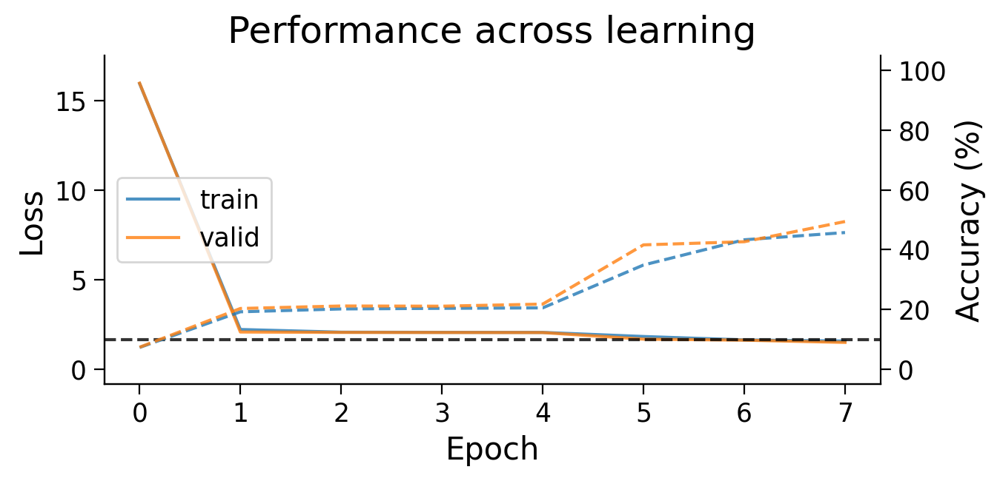

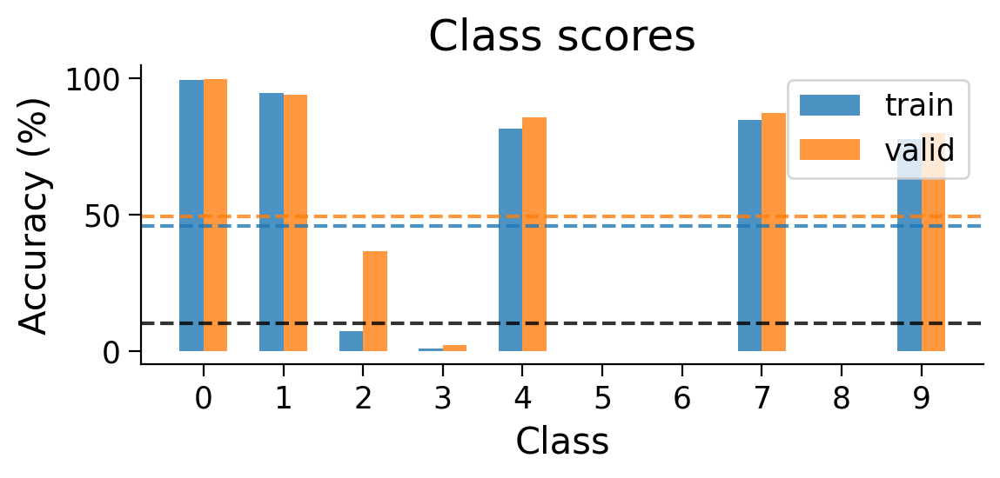

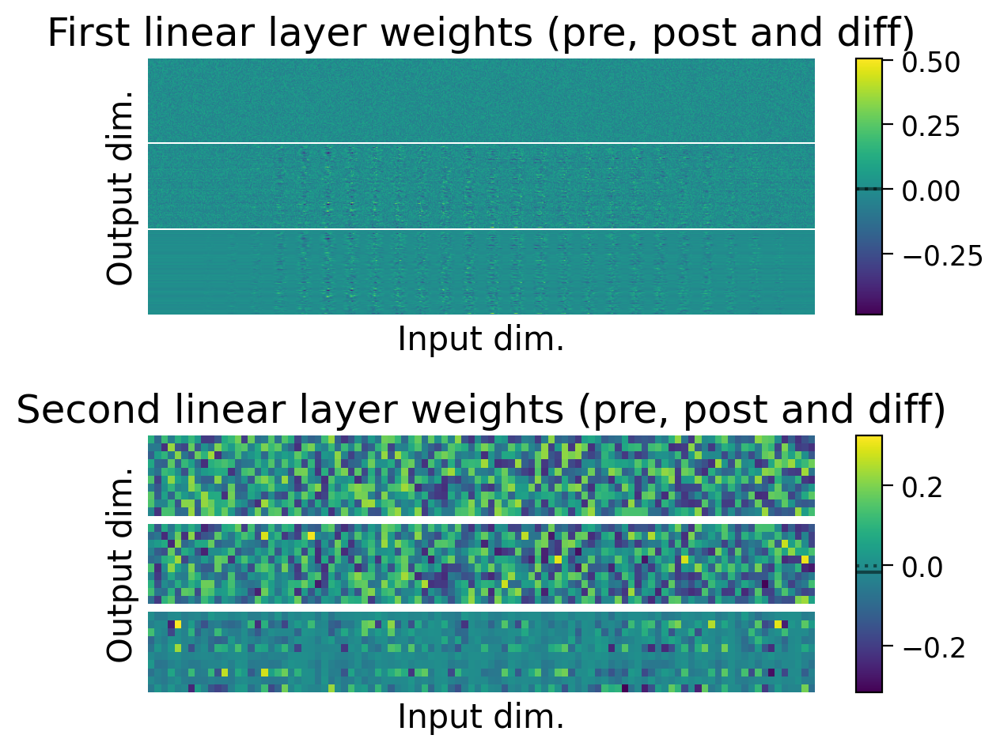

In [ ]:
kp_snn = KolenPollackSNN(
    num_hidden=100,
    num_outputs=10,  # Set to 10 for MNIST
    num_steps=25,
    beta=0.95,
)

# Define the optimizer
kp_optimizer = BasicOptimizer(kp_snn.parameters(), lr=1e-3)

# Assuming train_loader and valid_loader are defined

# Train the Kolen-Pollack SNN
kp_results_dict = train_model(kp_snn, train_loader, valid_loader, kp_optimizer, num_epochs=8)

# Plot the weights for the trained models
plot_results(kp_results_dict, num_classes=10)
plot_scores_per_class(kp_results_dict, num_classes=10)
plot_weights(kp_snn)

# Part 3: Analysis

## Learning performance analysis

In [ ]:
kp_results_dict_10cls['avg_train_losses'].shape

AttributeError: 'list' object has no attribute 'shape'

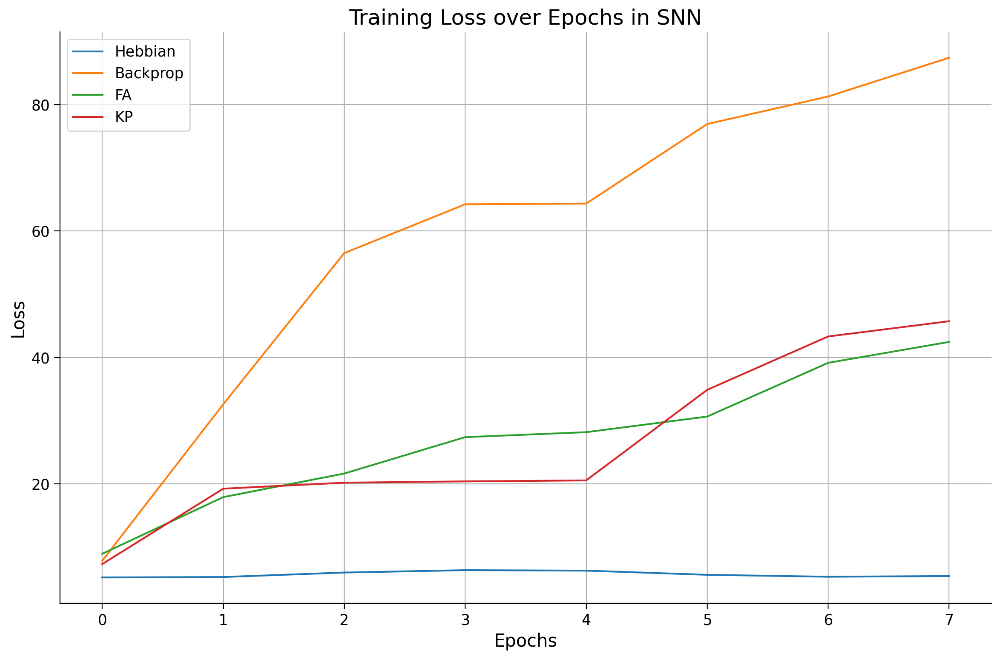

In [ ]:
import matplotlib.pyplot as plt
hebbian_results_dict
# Plotting the training and validation losses
plt.figure(figsize=(12, 8))

# Hebbian MLP
plt.plot(hebbian_results_dict['avg_train_accuracies'], label='Hebbian', linestyle='-')
# plt.plot(Hebb_results_dict_10cls['avg_valid_losses'], label='Hebbian Valid Loss', linestyle='--')

# Standard MLP
plt.plot(backpropSNN_results_dict_10cls['avg_train_accuracies'], label='Backprop', linestyle='-')
# plt.plot(MLP_results_dict_10cls['avg_valid_losses'], label='MLP Valid Loss', linestyle='--')

# Feedback Alignment MLP
plt.plot(fa_results_dict['avg_train_accuracies'], label='FA', linestyle='-')
# plt.plot(FA_results_dict_10cls['avg_valid_losses'], label='FA Valid Loss', linestyle='--')

# Kolen-Pollack MLP
plt.plot(kp_results_dict['avg_train_accuracies'], label='KP', linestyle='-')
# plt.plot(kp_results_dict_10cls['avg_valid_losses'], label='KP Valid Loss', linestyle='--')

# Adding titles and labels
plt.title('Training Loss over Epochs in SNN')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
Hebb_results_dict_10cls['avg_train_accuracies'']

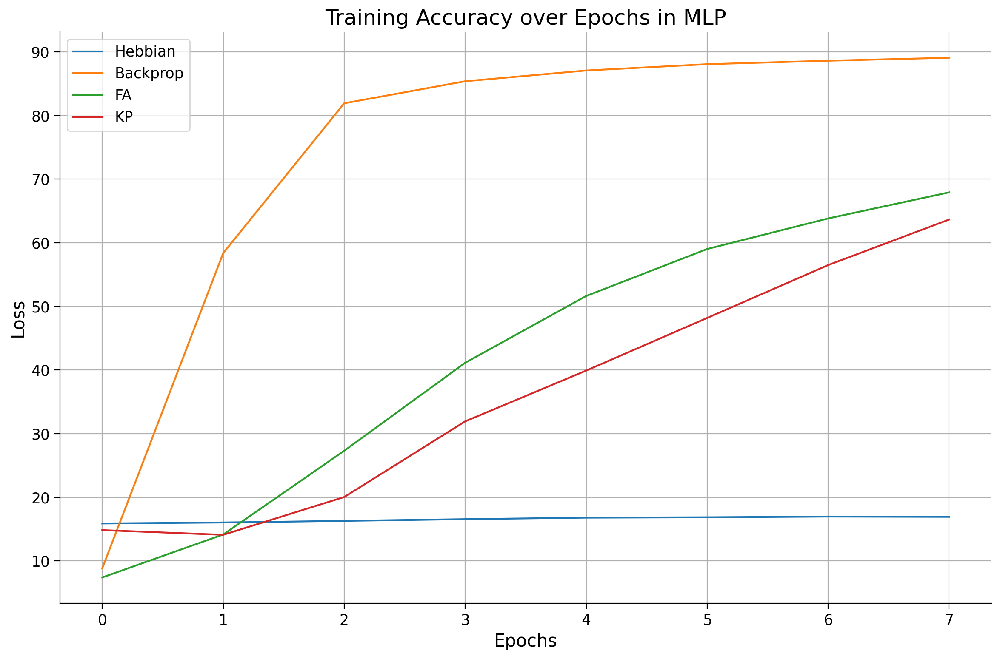

In [ ]:
import matplotlib.pyplot as plt

# Plotting the training and validation losses
plt.figure(figsize=(12, 8))

# Hebbian MLP
plt.plot(Hebb_results_dict_10cls['avg_train_accuracies'], label='Hebbian', linestyle='-')
# plt.plot(Hebb_results_dict_10cls['avg_valid_losses'], label='Hebbian Valid Loss', linestyle='--')

# Standard MLP
plt.plot(MLP_results_dict_10cls['avg_train_accuracies'], label='Backprop', linestyle='-')
# plt.plot(MLP_results_dict_10cls['avg_valid_losses'], label='MLP Valid Loss', linestyle='--')

# Feedback Alignment MLP
plt.plot(FA_results_dict_10cls['avg_train_accuracies'], label='FA', linestyle='-')
# plt.plot(FA_results_dict_10cls['avg_valid_losses'], label='FA Valid Loss', linestyle='--')

# Kolen-Pollack MLP
plt.plot(kp_results_dict_10cls['avg_train_accuracies'], label='KP', linestyle='-')
# plt.plot(kp_results_dict_10cls['avg_valid_losses'], label='KP Valid Loss', linestyle='--')

# Adding titles and labels
plt.title('Training Accuracy over Epochs in MLP')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Plotting the training and validation losses
plt.figure(figsize=(12, 8))

# Hebbian MLP
plt.plot(Hebb_results_dict_10cls['avg_train_losses'], label='Hebbian', linestyle='-')
# plt.plot(Hebb_results_dict_10cls['avg_valid_losses'], label='Hebbian Valid Loss', linestyle='--')

# Standard MLP
plt.plot(MLP_results_dict_10cls['avg_train_losses'], label='MLP', linestyle='-')
# plt.plot(MLP_results_dict_10cls['avg_valid_losses'], label='MLP Valid Loss', linestyle='--')

# Feedback Alignment MLP
plt.plot(FA_results_dict_10cls['avg_train_losses'], label='FA', linestyle='-')
# plt.plot(FA_results_dict_10cls['avg_valid_losses'], label='FA Valid Loss', linestyle='--')

# Kolen-Pollack MLP
plt.plot(kp_results_dict_10cls['avg_train_losses'], label='KP', linestyle='-')
# plt.plot(kp_results_dict_10cls['avg_valid_losses'], label='KP Valid Loss', linestyle='--')

# Adding titles and labels
plt.title('Training Loss over Epochs in MLP')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Plotting the training and validation losses
plt.figure(figsize=(12, 8))

# Hebbian MLP
plt.plot(Hebb_results_dict_10cls['avg_train_losses'], label='Hebbian Train Loss', linestyle='-')
# plt.plot(Hebb_results_dict_10cls['avg_valid_losses'], label='Hebbian Valid Loss', linestyle='--')

# Standard MLP
plt.plot(MLP_results_dict_10cls['avg_train_losses'], label='MLP Train Loss', linestyle='-')
# plt.plot(MLP_results_dict_10cls['avg_valid_losses'], label='MLP Valid Loss', linestyle='--')

# Feedback Alignment MLP
plt.plot(FA_results_dict_10cls['avg_train_losses'], label='FA Train Loss', linestyle='-')
# plt.plot(FA_results_dict_10cls['avg_valid_losses'], label='FA Valid Loss', linestyle='--')

# Kolen-Pollack MLP
plt.plot(kp_results_dict_10cls['avg_train_losses'], label='KP Train Loss', linestyle='-')
# plt.plot(kp_results_dict_10cls['avg_valid_losses'], label='KP Valid Loss', linestyle='--')

# Adding titles and labels
plt.title('Training and Validation Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.show()


## Bias and variance analysis

### Calculate Cosine similarity for bias

In [ ]:
#@markdown `train_and_calculate_cosine_sim(MLP, train_loader, valid_loader, optimizer)`:
#@markdown Trains a model using a specific learning rule, while computing the cosine
#@markdown similarity of the gradients proposed the learning rule compared to those proposed
#@markdown by error backpropagation.
def train_and_calculate_cosine_sim(MLP, train_loader, valid_loader, optimizer,
                                   num_epochs=8):
  """
  Train model across epochs, calculating the cosine similarity between the
  gradients proposed by the learning rule it's trained with, compared to those
  proposed by error backpropagation.

  Arguments:
  - MLP (torch model): Model to train.
  - train_loader (torch dataloader): Dataloader to use to train the model.
  - valid_loader (torch dataloader): Dataloader to use to validate the model.
  - optimizer (torch optimizer): Optimizer to use to update the model.
  - num_epochs (int, optional): Number of epochs to train model.

  Returns:
  - cosine_sim (dict): Dictionary storing the cosine similarity between the
    model's learning rule and backprop across epochs, computed on the
    validation data.
  """

  criterion = SF.ce_count_loss()

  cosine_sim_dict = {key: list() for key in MLP.list_parameters() if 'weight' in key}

  for e in tqdm(range(num_epochs)):
    MLP.train()
    for X, y in train_loader:
      # y_pred = MLP(X, y=y)
      # loss = criterion(torch.log(y_pred), y)
      y_pred, mem_rec = MLP(X, y)
      loss = criterion(y_pred, y)  # Calculate the loss
      optimizer.zero_grad()
      if e != 0:
        loss.backward()
        optimizer.step()

    MLP.eval()
    lr_gradients_dict = {key: list() for key in cosine_sim_dict.keys()}
    backprop_gradients_dict = {key: list() for key in cosine_sim_dict.keys()}

    for X, y in valid_loader:
      # collect gradients computed with learning rule
      y_pred,_ = MLP(X, y)
      loss = criterion(y_pred, y)

      MLP.zero_grad()
      loss.backward()
      for key, value in MLP.gather_gradient_dict().items():
        if 'weight' in key:
          lr_gradients_dict[key].append(value)
      MLP.zero_grad()

      # collect gradients computed with backprop
      y_pred,_ = MLP.forward_backprop(X)
      loss = criterion(y_pred, y)

      MLP.zero_grad()
      loss.backward()
      for key, value in MLP.gather_gradient_dict().items():
        if 'weight' in key:
          backprop_gradients_dict[key].append(value)
      MLP.zero_grad()

    for key in cosine_sim_dict.keys():
      lr_grad = np.asarray(lr_gradients_dict[key])
      bp_grad = np.asarray(backprop_gradients_dict[key])
      if (lr_grad == 0).all():
        warnings.warn(
          f"Learning rule computed all 0 gradients for epoch {e}. "
          "Cosine similarity cannot be calculated."
          )
        epoch_cosine_sim = np.nan
      elif (bp_grad == 0).all():
        warnings.warn(
          f"Backprop. rule computed all 0 gradients for epoch {e}. "
          "Cosine similarity cannot be calculated."
          )
        epoch_cosine_sim = np.nan
      else:
        epoch_cosine_sim = calculate_cosine_similarity(lr_grad, bp_grad)

      cosine_sim_dict[key].append(epoch_cosine_sim)

  return cosine_sim_dict


def calculate_cosine_similarity(data1, data2):
    """
    Calculates the cosine similarity between two vectors.

    Arguments:
    - data1 (torch Tensor): first vector
    - data2 (torch Tensor): second vector
    """

    data1 = data1.reshape(-1)
    data2 = data2.reshape(-1)

    numerator = np.dot(data1, data2)
    denominator = (
        np.sqrt(np.dot(data1, data1)) * np.sqrt(np.dot(data2, data2))
      )

    cosine_sim = numerator / denominator

    return cosine_sim

#@markdown `plot_gradient_cosine_sims(cosine_sim_dict)`: Plots cosine similarity
#@markdown of the gradients proposed by a model across learning to those proposed
#@markdown by error backpropagation.
def plot_gradient_cosine_sims(cosine_sim_dict, ax=None):
  """
  Plot gradient cosine similarities to error backpropagation for various
  learning rules.

  Arguments:
  - cosine_sim_dict (dict): Gradient cosine similarities for each learning rule.
  - ax (plt subplot, optional): Axis on which to plot gradient cosine
    similarities. If None, a new axis will be created.

  Returns:
  - ax (plt subplot): Axis on which gradient cosine similarities were plotted.
  """

  if ax is None:
    _, ax = plt.subplots(figsize=(8, 4))

  max_num_epochs = 0
  for m, (model_type, cosine_sims) in enumerate(cosine_sim_dict.items()):
    cosine_sims = np.asarray(cosine_sims) # params x epochs
    num_epochs = cosine_sims.shape[1]
    x = np.arange(num_epochs)
    cosine_sim_means = np.nanmean(cosine_sims, axis=0)
    cosine_sim_sems = scipy.stats.sem(cosine_sims, axis=0, nan_policy="omit")

    ax.plot(x, cosine_sim_means, label=model_type, alpha=0.8)

    color = get_plotting_color(model_idx=m)
    ax.fill_between(
        x,
        cosine_sim_means - cosine_sim_sems,
        cosine_sim_means + cosine_sim_sems,
        alpha=0.3, lw=0, color=color
        )

    for i, param_cosine_sims in enumerate(cosine_sims):
      s = 20 + i * 30
      ax.scatter(x, param_cosine_sims, color=color, s=s, alpha=0.6)

    max_num_epochs = max(max_num_epochs, num_epochs)

  if max_num_epochs > 0:
    x = np.arange(max_num_epochs)
    xlabels = [f"{int(e)}" for e in x]
    ax.set_xticks(x)
    ax.set_xticklabels(xlabels)

  ymin = ax.get_ylim()[0]
  ymin = min(-0.1, ymin)
  ax.set_ylim(ymin, 1.1)

  ax.axhline(0, ls="dashed", color="k", zorder=-5, alpha=0.5)

  ax.set_xlabel("Epoch")
  ax.set_ylabel("Cosine similarity")
  ax.set_title("Cosine similarity to backprop gradients in SNN")
  ax.legend()

  return ax

def get_plotting_color(model_idx=None):
    # Define a color palette
    palette = [
        '#1f77b4',  # blue
        '#ff7f0e',  # orange
        '#2ca02c',  # green
        '#d62728',  # red
        '#9467bd',  # purple
        '#8c564b',  # brown
        '#e377c2',  # pink
        '#7f7f7f',  # gray
        '#bcbd22',  # yellow-green
        '#17becf'   # cyan
    ]
    if model_idx is not None:
        # Cycle through colors if the number of models exceeds the palette size
        return palette[model_idx % len(palette)]
    else:
        raise ValueError("model_idx cannot be None")

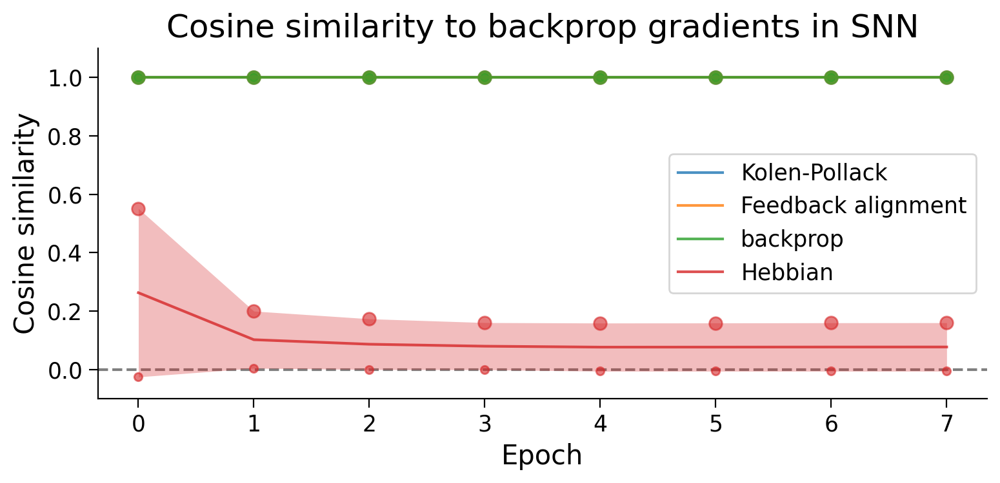

In [ ]:
# Example usage:
HEBB_LR = 1e-6
NUM_HIDDEN = 100
NUM_EPOCHS = 8
NUM_CLASSES = 10
LR = 0.001
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

cosine_sim_dict = dict()
for model_type in ["Hebbian"]:
  model_params = {
      "num_inputs": 28*28,
      "num_hidden": NUM_HIDDEN,
      "num_outputs": NUM_CLASSES,  # Assuming 10-class classification
      "num_steps": 10,
      "beta": 0.95,
      "clamp_output": True
  }

  if model_type == "Hebbian":
    model_fct = HebbianSNN
    lr = HEBB_LR
  elif model_type == "Kolen-Pollack":
    model_fct = KolenPollackSNN
    lr = LR
  elif model_type == "Feedback alignment":
    model_fct = FeedbackAlignmentSNN
    lr = LR
  else:
    model_fct = SNN
    lr = LR

  model = model_fct(**model_params)

  optimizer = BasicOptimizer(model.parameters(), lr=lr)

  print(f"Collecting Cosine similarities for {model_type}-trained model...")
  model_cosine_sim_dict = train_and_calculate_cosine_sim(
      model, train_loader, valid_loader, optimizer, num_epochs=NUM_EPOCHS
      )

  cosine_sim_dict[model_type] = [
      cos_sim for cos_sim in model_cosine_sim_dict.values()
      ]

plot_gradient_cosine_sims(cosine_sim_dict);

In [ ]:
# cosine_sim_dict = {'Kolen-Pollack': [
#         [1.0, 0.99999994, 0.99999994, 1.0, 1.0, 0.9999999, 1.0000001, 1.0000001],
#         [1.0, 0.99999994, 0.99999994, 1.0, 1.0, 0.9999999, 1.0000001, 1.0000001],
#     ],
#     'Feedback alignment': [
#         [0.99999994, 1.0, 1.0000001, 1.0, 1.0, 1.0000001, 1.0000001, 1.0000001],
#         [0.99999994, 1.0, 1.0000001, 1.0, 1.0, 1.0000001, 1.0000001, 1.0000001],
#     ],
#     'backprop': [
#         [1.0000001, 1.0, 1.0000001, 0.99999994, 1.0, 1.0, 1.0000001, 1.0],
#         [1.0, 0.9999999, 1.0, 0.99999994, 1.0, 0.99999994, 1.0, 1.0000001]
#     ],
# 'Hebbian': [[-0.025209418,
#    0.0045813546,
#    -5.8196332e-05,
#    -0.0006045643,
#    -0.005531302,
#    -0.0055983425,
#    -0.005595489,
#    -0.005599969],
#   [0.55118906,
#    0.19994748,
#    0.17360912,
#    0.16064401,
#    0.15915555,
#    0.15948074,
#    0.1600413,
#    0.16029334]]
# }

### Compute SNR for variance

In [ ]:
#@markdown `compute_gradient_SNR(MLP, dataset)`: Passes a dataset through a model
#@markdown and computes the SNR of the gradients computed by the model for each example.
#@markdown Returns a dictionary containing the gradient SNRs for each layer of a model.

def compute_gradient_SNR(MLP, dataset):
  """
  Computes gradient SNRs for a model given a dataset.

  Arguments:
  - MLP (torch model): Model for which to compute gradient SNRs.
  - dataset (torch dataset): Dataset with which to compute gradient SNRs.

  Returns:
  - SNR_dict (dict): Dictionary compiling gradient SNRs for each parameter
    (i.e., the weights and/or biases of each layer).
  """

  MLP.eval()

  criterion = SF.ce_count_loss()

  # zero out gradients
  MLP.zero_grad

  gradients = {key: list() for key in MLP.list_parameters()}

  # initialize a loader with a batch size of 1
  loader = torch.utils.data.DataLoader(dataset, batch_size=1)

  # collect gradients computed on the dataset of data
  for X, y in loader:
    y_pred, mem_rec = MLP(X.view(X.size(0), -1))
    loss = criterion(y_pred, y)

    MLP.zero_grad() # zero grad before
    loss.backward()
    for key, value in MLP.gather_gradient_dict().items():
      gradients[key].append(value)
    MLP.zero_grad() # zero grad after, since no optimzer step is taken

  # aggregate the gradients
  SNR_dict = {key: list() for key in MLP.list_parameters()}
  for key, value in gradients.items():
      SNR_dict[key] = compute_SNR(np.asarray(value))

  return SNR_dict


def compute_SNR(data, epsilon=1e-7):
    """
    Calculates the average SNR for of data across the first axis.

    Arguments:
    - data (torch Tensor): items x gradients
    - epsilon (float, optional): value added to the denominator to avoid
      division by zero.

    Returns:
    - avg_SNR (float): average SNR across data items
    """

    absolute_mean = np.abs(np.mean(data, axis=0))
    std = np.std(data, axis=0)
    SNR_by_item = absolute_mean / (std + epsilon)
    avg_SNR = np.mean(SNR_by_item)

    return avg_SNR




#@markdown `plot_gradient_SNRs(SNR_dict)`: Plots gradient SNRs collected in
#@markdown a dictionary.
def plot_gradient_SNRs(SNR_dict, width=0.5, ax=None):
    """
    Plot gradient SNRs for various learning rules.

    Arguments:
    - SNR_dict (dict): Gradient SNRs for each learning rule.
    - width (float, optional): Width of the bars.
    - ax (plt subplot, optional): Axis on which to plot gradient SNRs. If None, a
      new axis will be created.

    Returns:
    - ax (plt subplot): Axis on which gradient SNRs were plotted.
    """
    if ax is None:
        wid = min(8, len(SNR_dict) * 1.5)
        _, ax = plt.subplots(figsize=(wid, 4))

    xlabels = list()
    SNR_means = list()
    SNR_sems = list()
    SNRs_scatter = list()
    for m, (model_type, SNRs) in enumerate(SNR_dict.items()):
        xlabels.append(model_type)
        color = get_plotting_color(model_idx=m)
        ax.bar(
            m, np.mean(SNRs), yerr=scipy.stats.sem(SNRs),
            alpha=0.5, width=width, capsize=5, color=color
        )
        s = [20 + i * 30 for i in range(len(SNRs))]
        ax.scatter([m] * len(SNRs), SNRs, alpha=0.8, s=s, color=color, zorder=5)

    x = np.arange(len(xlabels))
    ax.set_xticks(x)
    x_pad = (x.max() - x.min() + width) * 0.3
    ax.set_xlim(x.min() - x_pad, x.max() + x_pad)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Learning rule")
    ax.set_ylabel("SNR")
    ax.set_title("SNR of the gradients in MLP")

    return ax

In [ ]:
NUM_HIDDEN = 100
NUM_EPOCHS = 8
NUM_CLASSES = 2
SNR_dict = dict()
for model_type in ["Kolen-Pollack", "Feedback alignment",  "Hebbian", "Backprop"]:
  model_params = {
      "num_inputs": 28*28,
      "num_hidden": NUM_HIDDEN,
      "num_outputs": NUM_CLASSES,
      "num_steps": 25,
      "beta": 0.95,
      # "clamp_output": False,
  }

  if model_type == "Hebbian":
    model_fct = HebbianSNN
  elif model_type == "Feedback alignment":
    model_fct = FeedbackAlignmentSNN
  elif model_type== "Kolen-Pollack":
    model_fct = KolenPollackSNN
  else:
    model_fct = SNN

  model = model_fct(**model_params)

  model_SNR_dict = compute_gradient_SNR(model, valid_loader_2cls.dataset)

  SNR_dict[model_type] = [SNR for SNR in model_SNR_dict.values()]

# {'Kolen-Pollack': [0.06860958, 0.06860958],
#  'Feedback alignment': [0.061654955, 0.061654955],
#  'Hebbian': [0.3472793, 0.33642766],
#  'Backprop': [0.07408184, 0.07562712]}

plot_gradient_SNRs(SNR_dict);

TypeError: super(type, obj): obj must be an instance or subtype of type

In [ ]:
SNR_dict

## Representational dissimilarity analysis

In [ ]:
!pip install snntorch rsatoolbox torchlens
!pip install torch torchvision matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 656.0/656.0 kB 16.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 41.5 MB/s eta 0:00:00


In [ ]:
# Import necessary libraries
import torch
from torchvision import datasets, transforms
import torchlens as tl
import rsatoolbox
from rsatoolbox.data import Dataset
from rsatoolbox.rdm.calc import calc_rdm



# Function to extract features (activations) from the SNN
def extract_snn_features(model, imgs):
    model.eval()
    all_activations = dict()
    with torch.no_grad():
        model(imgs)
        count = 1
        for step_layer in model.activations.keys():
          all_activations[f'fc{count}'] = model.activations[step_layer]
          count += 1
    return all_activations

# Define dataset and transformation
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.1307,), (0.3081,))
])
test_dataset = datasets.MNIST('../data', train=False, download=True, transform=transform)

# Function to create a balanced dataset with 5 instances of each digit in order
def create_ordered_balanced_test_set(test_dataset, num_samples_per_digit=5):
    digit_data = {i: [] for i in range(10)}  # Initialize dictionary to hold images for each digit

    # Collect images for each digit
    for img, label in test_dataset:
        if len(digit_data[label]) < num_samples_per_digit:
            digit_data[label].append((img, label))
        if all(len(images) >= num_samples_per_digit for images in digit_data.values()):
            break

    # Create the balanced dataset
    ordered_balanced_data = []
    for digit in range(10):
        ordered_balanced_data.extend(digit_data[digit])

    return ordered_balanced_data

def calc_rdms_snn(activations, method='correlation'):
    ds_list = []
    activations = snn_activations
    for step_layer, feats in activations.items():
        all_feats = feats.reshape(feats.shape[0], -1)  # Flatten features if needed
        ds = rsatoolbox.data.Dataset(all_feats, descriptors=dict(step_layer=step_layer))
        ds_list.append(ds)
    rdms = rsatoolbox.rdm.calc.calc_rdm(ds_list, method=method)
    rdms_dict = {list(activations.keys())[i]: rdms.get_matrices()[i] for i in range(len(activations))}

    # Normalize the RDM values to be between 0 and 1
    for key in rdms_dict:
        rdm = rdms_dict[key]
        rdm_min = rdm.min()
        rdm_max = rdm.max()
        rdms_dict[key] = (rdm - rdm_min) / (rdm_max - rdm_min)

    return rdms, rdms_dict

# Visualize the RDMs
def plot_rdms(rdms_dict, model_name):
    fig, axes = plt.subplots(1, len(rdms_dict), figsize=(15, 5))
    fig.suptitle(f"RDMs across layers for {model_name}")
    for i, (step_layer, rdm) in enumerate(rdms_dict.items()):
        im = axes[i].imshow(rdm, cmap='magma_r')
        axes[i].set_title(step_layer)
        axes[i].set_xlabel("Input Index")
        axes[i].set_ylabel("Input Index")
        fig.colorbar(im, ax=axes[i])
    plt.show()

# Create the ordered balanced test set
ordered_balanced_test_data = create_ordered_balanced_test_set(test_dataset, num_samples_per_digit=5)

# Separate images and labels
ordered_balanced_test_imgs = torch.stack([img for img, label in ordered_balanced_test_data])
ordered_balanced_test_labels = torch.tensor([label for img, label in ordered_balanced_test_data])

# Print the digits corresponding to the input indices
for idx, label in enumerate(ordered_balanced_test_labels):
    print(f"Input Index {idx}: Digit {label.item()}")

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 9912422/9912422 [00:00<00:00, 79342203.31it/s]


Extracting ../data/MNIST/raw/train-images-idx3-ubyte.gz to ../data/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 28881/28881 [00:00<00:00, 30667264.26it/s]

Extracting ../data/MNIST/raw/train-labels-idx1-ubyte.gz to ../data/MNIST/raw



Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 1648877/1648877 [00:00<00:00, 33176107.63it/s]

Extracting ../data/MNIST/raw/t10k-images-idx3-ubyte.gz to ../data/MNIST/raw



Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 4542/4542 [00:00<00:00, 1978248.05it/s]

Extracting ../data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ../data/MNIST/raw

Input Index 0: Digit 0
Input Index 1: Digit 0
Input Index 2: Digit 0
Input Index 3: Digit 0
Input Index 4: Digit 0
Input Index 5: Digit 1
Input Index 6: Digit 1
Input Index 7: Digit 1
Input Index 8: Digit 1
Input Index 9: Digit 1
Input Index 10: Digit 2
Input Index 11: Digit 2
Input Index 12: Digit 2
Input Index 13: Digit 2
Input Index 14: Digit 2
Input Index 15: Digit 3
Input Index 16: Digit 3
Input Index 17: Digit 3
Input Index 18: Digit 3
Input Index 19: Digit 3
Input Index 20: Digit 4
Input Index 21: Digit 4
Input Index 22: Digit 4
Input Index 23: Digit 4
Input Index 24: Digit 4
Input Index 25: Digit 5
Input Index 26: Digit 5
Input Index 27: Digit 5
Input Index 28: Digit 5
Input Index 29: Digit 5
Input Index 30: Digit 6
Input Index 31: Digit 6
Input Index 32: Digit 6
Input Index 33: Digit 6
Input Index 34: Digit 6
Input Index 35: Digit 7
Input Index 36: Digit 7
Input Index 37: Digit 7
Input Index 38: Digit

#### Backprop SNN

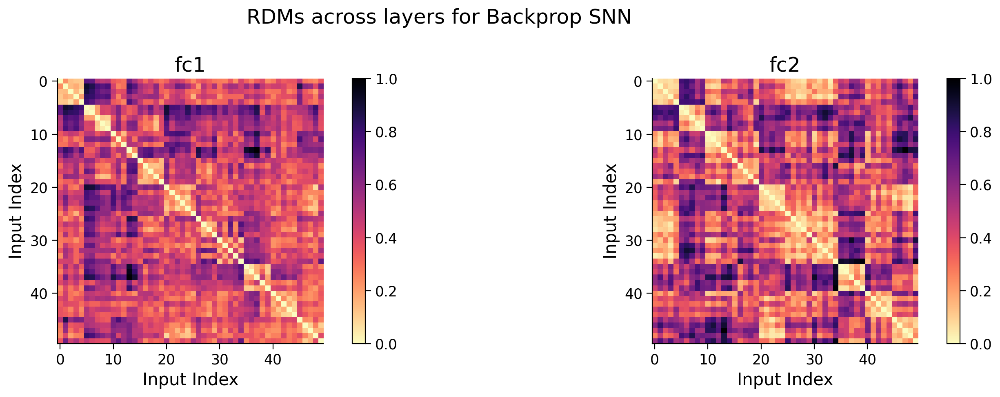

In [ ]:
model = backpropSNN_10cls
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
rdms_snn, rdms_dict_snn = calc_rdms_snn(snn_activations)

# Plot RDMs for the SNN
plot_rdms(rdms_dict_snn, "Backprop SNN")



#### Hebbian SNN

In [ ]:
snn_activations['fc1'][0][0]

2454836600000000.0

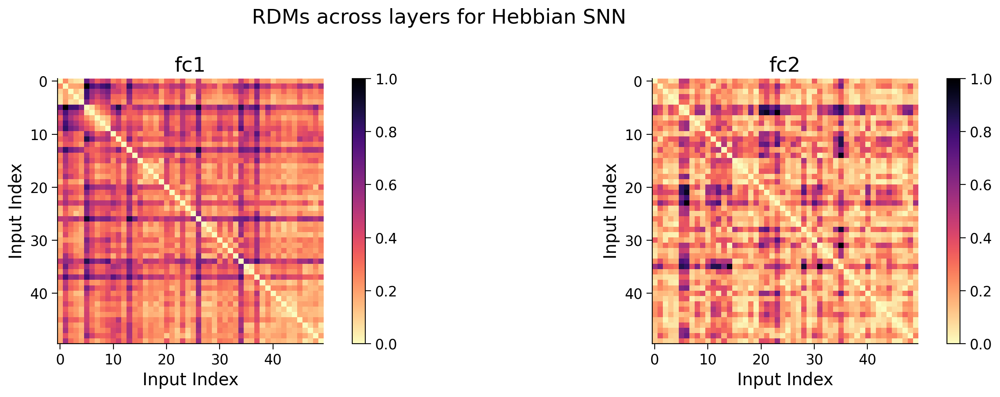

In [ ]:
model = hebbian_snn
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
rdms_snn, rdms_dict_snn = calc_rdms_snn(snn_activations)

# Plot RDMs for the SNN
plot_rdms(rdms_dict_snn, "Hebbian SNN")



### FA SNN

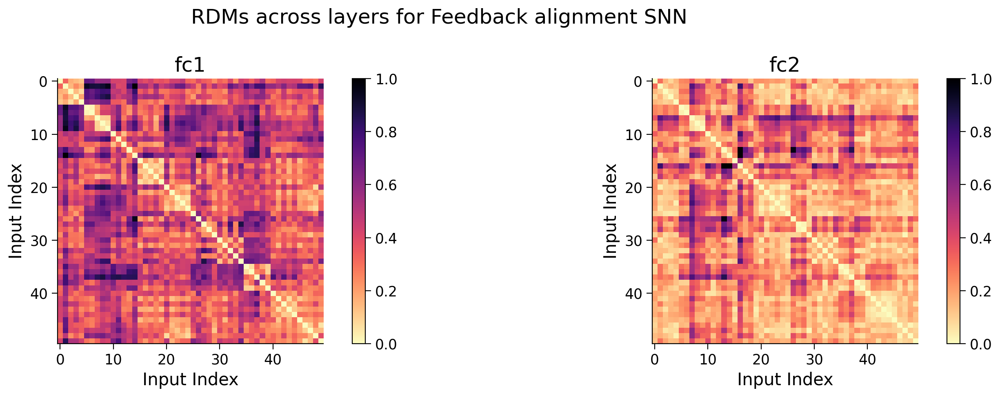

In [ ]:
model = fa_snn
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
rdms_snn, rdms_dict_snn = calc_rdms_snn(snn_activations)

# Plot RDMs for the SNN
plot_rdms(rdms_dict_snn, "Feedback alignment SNN")



### KP SNN

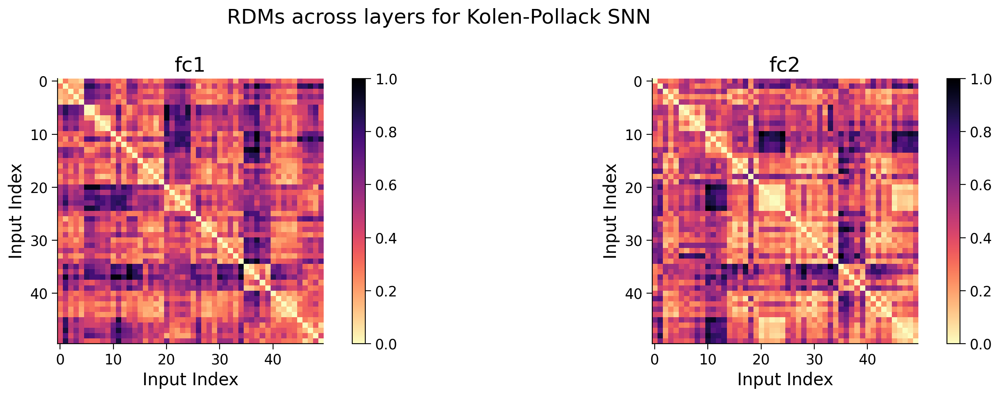

In [ ]:
model = kp_snn
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
rdms_snn, rdms_dict_snn = calc_rdms_snn(snn_activations)

# Plot RDMs for the SNN
plot_rdms(rdms_dict_snn, "Kolen-Pollack SNN")



### Backprop MLP

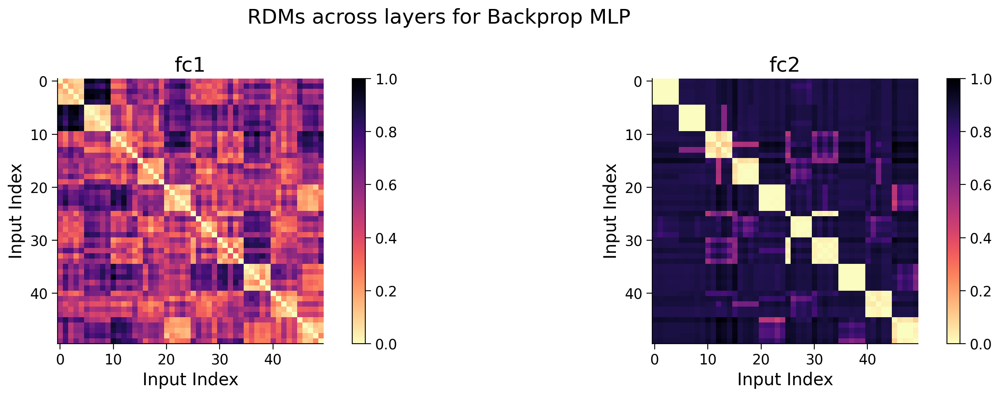

In [ ]:
model = MLP_10cls
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
rdms_snn, rdms_dict_snn = calc_rdms_snn(snn_activations)

# Plot RDMs for the SNN
plot_rdms(rdms_dict_snn, "Backprop MLP")



### Hebbian MLP

In [ ]:
snn_activations

{'fc1': array([[1.3536934 , 0.        , 0.        , ..., 1.6694564 , 0.        ,
         0.        ],
        [1.1547979 , 0.26819086, 0.        , ..., 0.90203375, 0.        ,
         0.        ],
        [0.6603729 , 0.        , 0.        , ..., 0.88866466, 0.        ,
         0.        ],
        ...,
        [1.5497204 , 0.        , 0.10648227, ..., 0.5471679 , 0.        ,
         0.        ],
        [1.1666958 , 0.        , 0.22147912, ..., 0.5886326 , 0.        ,
         0.        ],
        [1.3263938 , 0.        , 0.        , ..., 1.5028911 , 0.65976006,
         0.        ]], dtype=float32),
 'fc2': array([[0.13366897, 0.11653508, 0.07452279, 0.07320619, 0.09752449,
         0.04962336, 0.08470029, 0.20163268, 0.09438071, 0.07420551],
        [0.11145756, 0.1019818 , 0.09460159, 0.08211496, 0.08857418,
         0.08681691, 0.11313021, 0.1107079 , 0.11391819, 0.09669673],
        [0.16353491, 0.10185685, 0.07620013, 0.07840309, 0.10467748,
         0.06911416, 0.08995883, 

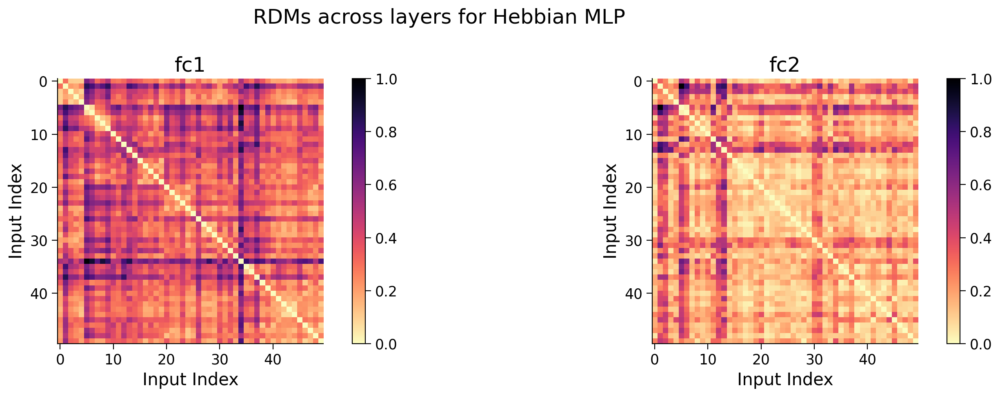

In [ ]:
model = HebbianMLP_10cls
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
rdms_snn, rdms_dict_snn = calc_rdms_snn(snn_activations)

# Plot RDMs for the SNN
plot_rdms(rdms_dict_snn, "Hebbian MLP")



## Dimensionality reduction

In [ ]:
from sklearn.decomposition import PCA
from sklearn import manifold
import matplotlib as mpl
import matplotlib.pyplot as plt


# # Function to plot dimensionality reduction results
# def plot_dim_reduction(model_features, labels, transformer_funcs):
#     """
#     Plots the dimensionality reduction results for model features using various transformers.

#     Inputs:
#     - model_features (dict): Dictionary containing model features for each layer.
#     - labels (array-like): Array of labels corresponding to the model features.
#     - transformer_funcs (list): List of dimensionality reduction techniques to apply ('PCA', 'MDS', 't-SNE').
#     """
#     with plt.xkcd():

#         transformers = []
#         for t in transformer_funcs:
#             if t == 'PCA': transformers.append(PCA(n_components=2))
#             if t == 'MDS': transformers.append(manifold.MDS(n_components=2, normalized_stress='auto'))
#             if t == 't-SNE': transformers.append(manifold.TSNE(n_components=2, perplexity=40, verbose=0))

#         fig = plt.figure(figsize=(8, 2.5*len(transformers)))
#         # and we add one plot per reference point
#         gs = fig.add_gridspec(len(transformers), len(model_features))
#         fig.subplots_adjust(wspace=0.2, hspace=0.2)

#         return_layers = list(model_features.keys())

#         for f in range(len(transformer_funcs)):

#             for l in range(len(return_layers)):
#                 layer = return_layers[l]
#                 feats = model_features[layer].detach().cpu().flatten(1)
#                 feats_transformed = transformers[f].fit_transform(feats)

#                 amin, amax = feats_transformed.min(), feats_transformed.max()
#                 amin, amax = (amin + amax) / 2 - (amax - amin) * 5/8, (amin + amax) / 2 + (amax - amin) * 5/8
#                 ax = plt.subplot(gs[f, l])
#                 ax.set_xlim([amin, amax])
#                 ax.set_ylim([amin, amax])
#                 ax.axis("off")
#                 if f == 0: ax.text(0.5, 1.12, f'{layer}', size=16, ha="center", transform=ax.transAxes)
#                 if l == 0: ax.text(-0.3, 0.5, transformer_funcs[f], size=16, ha="center", transform=ax.transAxes)
#                 num_colors = len(np.unique(labels))
#                 cmap = plt.get_cmap('viridis_r', num_colors)
#                 norm = mpl.colors.BoundaryNorm(np.arange(-0.5, num_colors), cmap.N)
#                 ax_ = ax.scatter(feats_transformed[:, 0], feats_transformed[:, 1], c=labels, cmap=cmap, norm=norm)

#         fig.subplots_adjust(right=0.9)
#         cbar_ax = fig.add_axes([1.01, 0.18, 0.01, 0.53])
#         fig.colorbar(ax_, cax=cbar_ax, ticks=np.linspace(0, 9, 10))
#         plt.show()


In [ ]:
def plot_dim_reduction(model_features, labels, transformer_funcs):
    """
    Plots the dimensionality reduction results for model features using various transformers.

    Inputs:
    - model_features (dict): Dictionary containing model features for each layer.
    - labels (array-like): Array of labels corresponding to the model features.
    - transformer_funcs (list): List of dimensionality reduction techniques to apply ('PCA', 'MDS', 't-SNE').
    """
    with plt.xkcd():

        transformers = []
        for t in transformer_funcs:
            if t == 'PCA': transformers.append(PCA(n_components=2))
            if t == 'MDS': transformers.append(manifold.MDS(n_components=2, normalized_stress='auto'))
            if t == 't-SNE': transformers.append(manifold.TSNE(n_components=2, perplexity=40, verbose=0))

        fig = plt.figure(figsize=(8, 2.5*len(transformers)))
        # and we add one plot per reference point
        gs = fig.add_gridspec(len(transformers), len(model_features))
        fig.subplots_adjust(wspace=0.2, hspace=0.2)

        return_layers = list(model_features.keys())

        for f in range(len(transformer_funcs)):

            for l in range(len(return_layers)):
                layer = return_layers[l]
                feats = model_features[layer]
                feats_transformed = transformers[f].fit_transform(feats)

                amin, amax = feats_transformed.min(), feats_transformed.max()
                amin, amax = (amin + amax) / 2 - (amax - amin) * 5/8, (amin + amax) / 2 + (amax - amin) * 5/8
                ax = plt.subplot(gs[f, l])
                ax.set_xlim([amin, amax])
                ax.set_ylim([amin, amax])
                ax.axis("off")
                if f == 0: ax.text(0.5, 1.12, f'{layer}', size=16, ha="center", transform=ax.transAxes)
                if l == 0: ax.text(-0.3, 0.5, transformer_funcs[f], size=16, ha="center", transform=ax.transAxes)
                num_colors = len(np.unique(labels))
                cmap = plt.get_cmap('viridis_r', num_colors)
                norm = mpl.colors.BoundaryNorm(np.arange(-0.5, num_colors), cmap.N)
                ax_ = ax.scatter(feats_transformed[:, 0], feats_transformed[:, 1], c=labels, cmap=cmap, norm=norm)

        fig.subplots_adjust(right=0.9)
        cbar_ax = fig.add_axes([1.01, 0.18, 0.01, 0.53])
        fig.colorbar(ax_, cax=cbar_ax, ticks=np.linspace(0, 9, 10))
        plt.show()

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


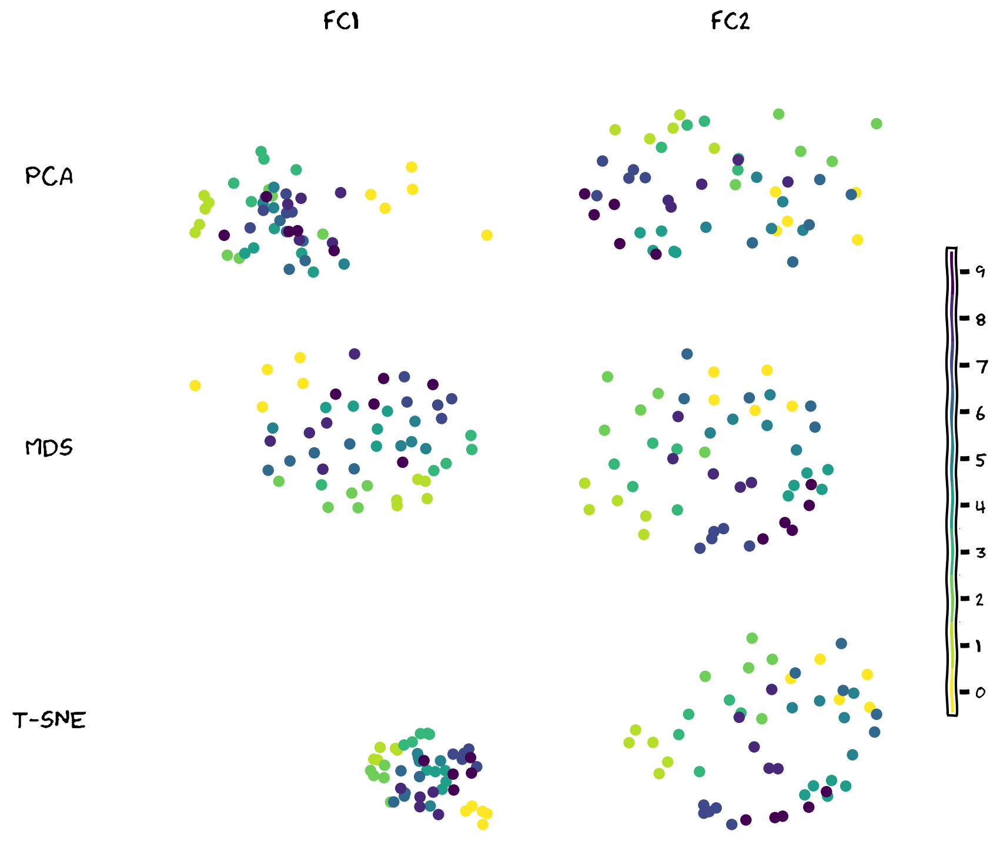

In [ ]:
model = backpropSNN_10cls
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
plot_dim_reduction(snn_activations, ordered_balanced_test_labels, transformer_funcs =['PCA', 'MDS', 't-SNE'])

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


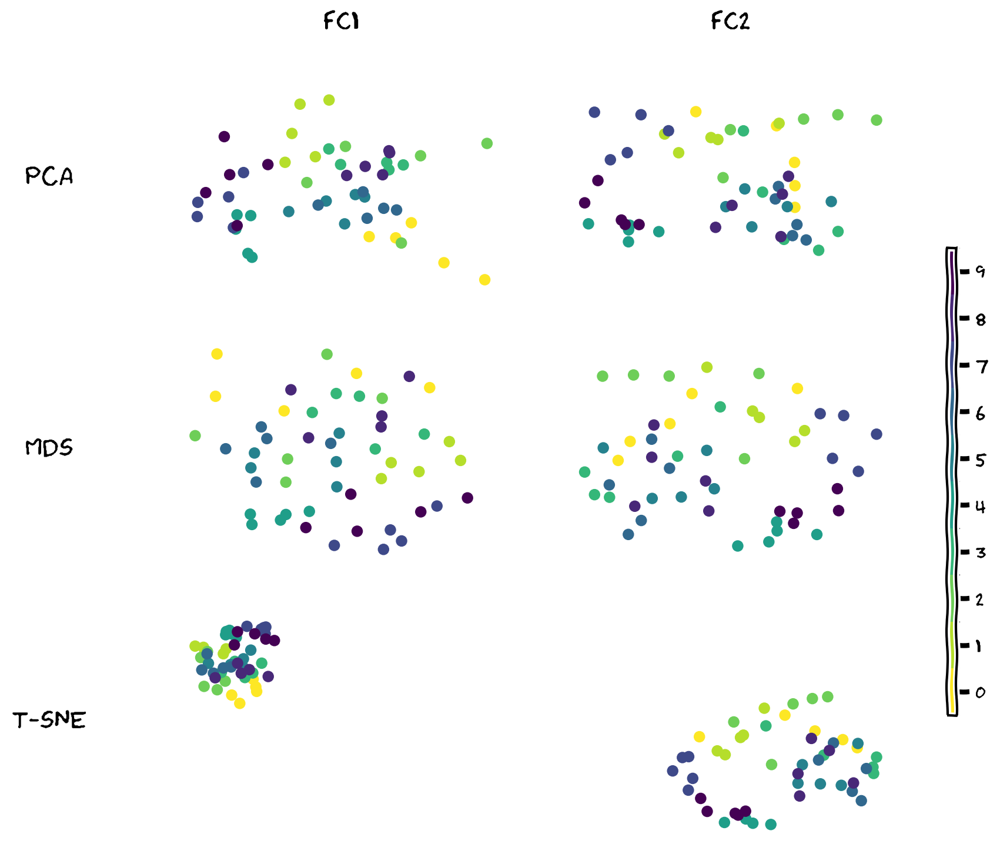

In [ ]:
model = kp_snn
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
plot_dim_reduction(snn_activations, ordered_balanced_test_labels, transformer_funcs =['PCA', 'MDS', 't-SNE'])

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


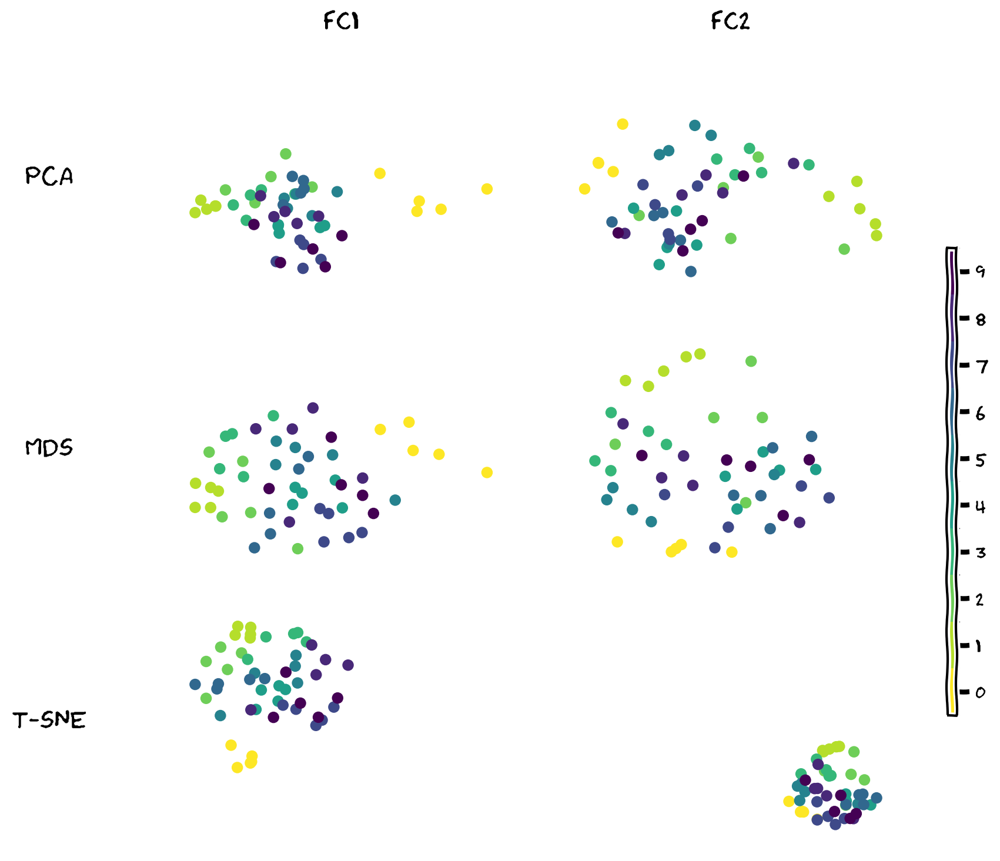

In [ ]:
model = fa_snn
snn_activations = extract_snn_features(model, ordered_balanced_test_imgs)
plot_dim_reduction(snn_activations, ordered_balanced_test_labels, transformer_funcs =['PCA', 'MDS', 't-SNE'])

In [ ]:
BackpropMLP_activations = extract_snn_features(MLP_10cls, ordered_balanced_test_imgs)
BackpropSNN_activations = extract_snn_features(backpropSNN_10cls, ordered_balanced_test_imgs)
HebbianMLP_activations = extract_snn_features(HebbianMLP_10cls, ordered_balanced_test_imgs)
HebbianSNN_activations = extract_snn_features(hebbian_snn, ordered_balanced_test_imgs)
FeedbackAlignmentSNN_activations = extract_snn_features(fa_snn, ordered_balanced_test_imgs)
KolenPollackSNN_activations = extract_snn_features(kp_snn, ordered_balanced_test_imgs)

In [ ]:
fc1_rep = np.vstack([BackpropMLP_activations['fc1'], BackpropSNN_activations['fc1'],\
             HebbianMLP_activations['fc1'], HebbianSNN_activations['fc1'], FeedbackAlignmentSNN_activations['fc1'], \
             KolenPollackSNN_activations['fc1']])
fc2_rep = np.vstack([BackpropMLP_activations['fc2'], BackpropSNN_activations['fc2'],\
             HebbianMLP_activations['fc2'], HebbianSNN_activations['fc2'], FeedbackAlignmentSNN_activations['fc2'], \
             KolenPollackSNN_activations['fc2']])

In [ ]:
activations_learning_rules = dict()
activations_learning_rules['fc1'] = fc1_rep
activations_learning_rules['fc2'] = fc2_rep

In [ ]:
fc2_rep.shape

(300, 10)

In [ ]:
import torch

str_list = ['backprop MLP', 'backprop SNN', 'hebbian MLP', 'hebbian SNN', 'feedback alignment SNN', 'Kolen-Pollack SNN']

# Create a mapping from strings to numerical labels
mapping = {s: i for i, s in enumerate(str_list)}

# Convert the list of strings to a list of numerical labels
label_list = [mapping[s] for s in str_list]

# Create a tensor from the label list
learning_rules = torch.tensor(label_list)

print(learning_rules)

tensor([0, 1, 2, 3, 4, 5])


In [ ]:
# Number of repetitions for each digit
num_repeats = 50

# Create a list of digits
digits = list(range(6))

# Repeat each digit and flatten the list
repeated_digits = [digit for digit in digits for _ in range(num_repeats)]

# Create a tensor from the repeated digits
learning_rules = torch.tensor(repeated_digits)

print(learning_rules.shape)

torch.Size([300])


### All learning rules

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn import manifold
import matplotlib as mpl

def plot_dim_reduction(model_features, labels, transformer_funcs, custom_labels=None):
    """
    Plots the dimensionality reduction results for model features using various transformers.

    Inputs:
    - model_features (dict): Dictionary containing model features for each layer.
    - labels (array-like): Array of labels corresponding to the model features.
    - transformer_funcs (list): List of dimensionality reduction techniques to apply ('PCA', 'MDS', 't-SNE').
    - custom_labels (dict): Dictionary mapping label indices to custom text labels.
    """
    with plt.xkcd():
        transformers = []
        for t in transformer_funcs:
            if t == 'PCA': transformers.append(PCA(n_components=2))
            if t == 'MDS': transformers.append(manifold.MDS(n_components=2, normalized_stress='auto'))
            if t == 't-SNE': transformers.append(manifold.TSNE(n_components=2, perplexity=40, verbose=0))

        fig = plt.figure(figsize=(8, 2.5*len(transformers)))
        gs = fig.add_gridspec(len(transformers), len(model_features))
        fig.subplots_adjust(wspace=0.2, hspace=0.2)

        return_layers = list(model_features.keys())

        markers = ['o', 's', 'D', 'v', '^', '<', '>', 'p', '*', 'h']
        colors = plt.cm.get_cmap('tab10', len(np.unique(labels)))

        for f in range(len(transformer_funcs)):
            for l in range(len(return_layers)):
                layer = return_layers[l]
                feats = model_features[layer]
                feats_transformed = transformers[f].fit_transform(feats)

                amin, amax = feats_transformed.min(), feats_transformed.max()
                amin, amax = (amin + amax) / 2 - (amax - amin) * 5/8, (amin + amax) / 2 + (amax - amin) * 5/8
                ax = plt.subplot(gs[f, l])
                ax.set_xlim([amin, amax])
                ax.set_ylim([amin, amax])
                ax.axis("off")
                if f == 0: ax.text(0.5, 1.12, f'{layer}', size=16, ha="center", transform=ax.transAxes)
                if l == 0: ax.text(-0.3, 0.5, transformer_funcs[f], size=16, ha="center", transform=ax.transAxes)

                for i in range(len(np.unique(labels))):
                    class_data = feats_transformed[labels == i]
                    ax.scatter(class_data[:, 0], class_data[:, 1], alpha=0.6,
                               label=custom_labels[i] if custom_labels else f'Class {i}',
                               marker=markers[i % len(markers)], color=colors(i))

        fig.subplots_adjust(right=0.9)
        cbar_ax = fig.add_axes([1.01, 0.18, 0.01, 0.53])
        fig.colorbar(ax.collections[0], cax=cbar_ax, ticks=np.linspace(0, 9, 10))

        # Customizing the legend
        handles, labels = ax.get_legend_handles_labels()
        legend = fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Classes", title_fontsize='13', fontsize='11')

        for handle in legend.legendHandles:
            handle.set_alpha(1)  # Make legend markers fully opaque
            handle._sizes = [100]  # Adjust the size of the markers in the legend

        plt.show()

custom_labels = {
    0: "Backprop MLP",
    1: "Backprop SNN",
    2: "Hebbian MLP",
    3: "Hebbian SNN",
    4: "FA SNN",
    5: "KP SNN",
}



<ipython-input-73-82e6657a9654>:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', len(np.unique(labels)))
<ipython-input-73-82e6657a9654>:62: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in legend.legendHandles:
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


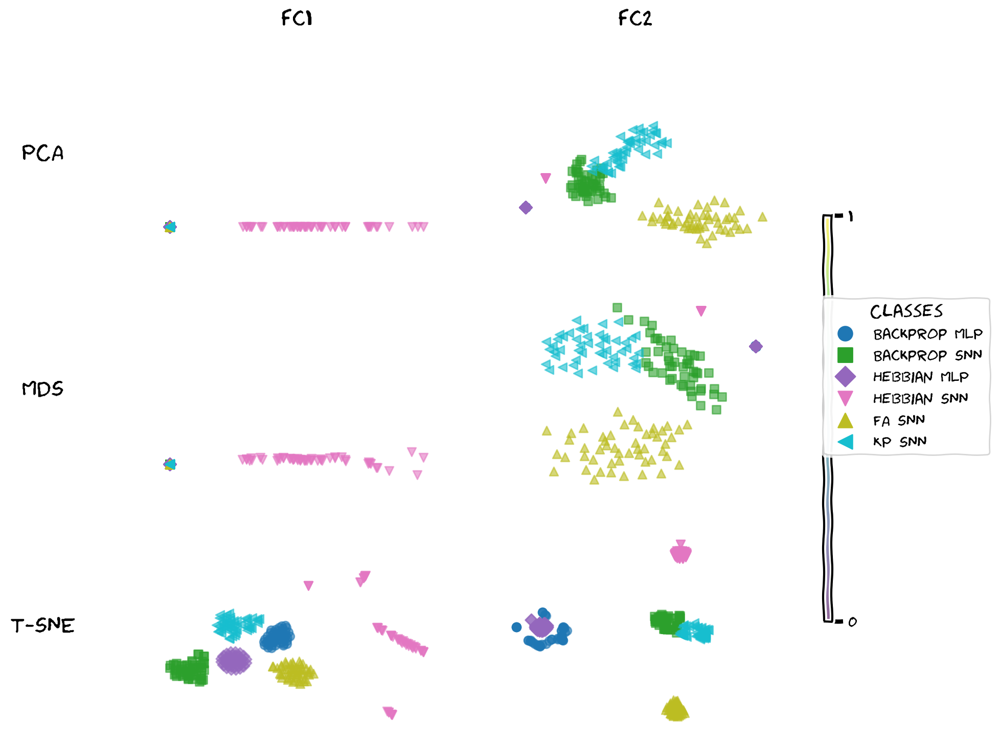

In [ ]:
plot_dim_reduction(activations_learning_rules, learning_rules, transformer_funcs =['PCA', 'MDS', 't-SNE'], custom_labels=custom_labels)

### All learning rules in SNN

<ipython-input-73-82e6657a9654>:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', len(np.unique(labels)))
<ipython-input-73-82e6657a9654>:62: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in legend.legendHandles:
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


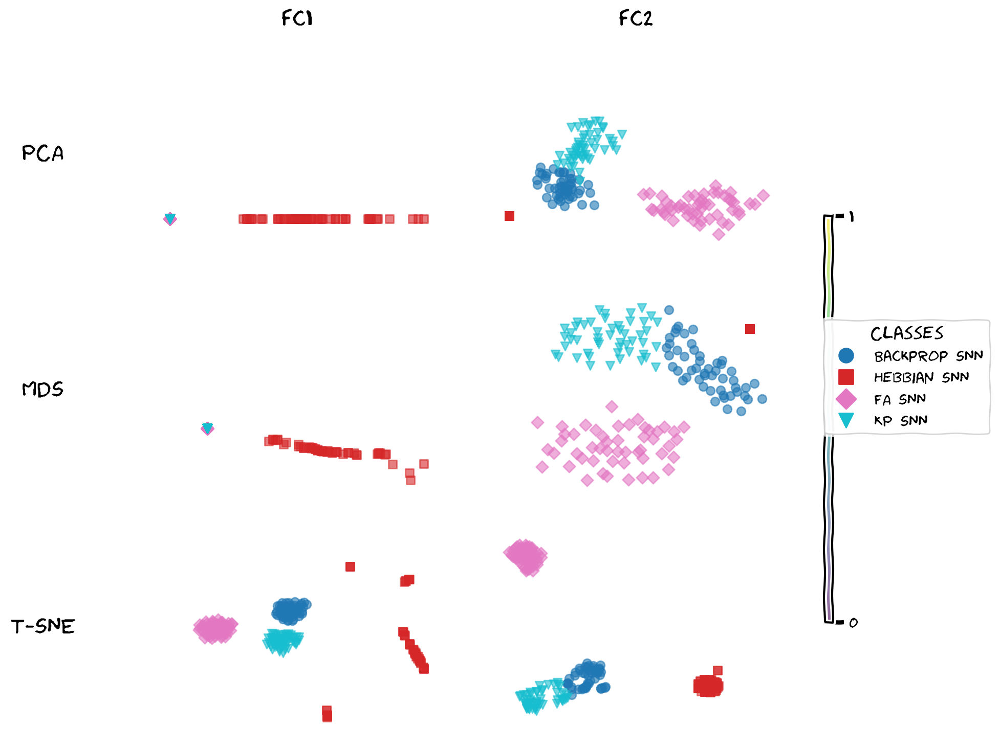

In [ ]:
fc1_rep_snn = np.vstack([BackpropSNN_activations['fc1'], HebbianSNN_activations['fc1'], FeedbackAlignmentSNN_activations['fc1'], \
             KolenPollackSNN_activations['fc1']])
fc2_rep_snn = np.vstack([ BackpropSNN_activations['fc2'], HebbianSNN_activations['fc2'], FeedbackAlignmentSNN_activations['fc2'], \
             KolenPollackSNN_activations['fc2']])

activations_learning_rules_snn = dict()
activations_learning_rules_snn['fc1'] = fc1_rep_snn
activations_learning_rules_snn['fc2'] = fc2_rep_snn

# Number of repetitions for each digit
num_repeats = 50

# Create a list of digits
digits = list(range(4))

# Repeat each digit and flatten the list
repeated_digits = [digit for digit in digits for _ in range(num_repeats)]

# Create a tensor from the repeated digits
learning_rules_snn = torch.tensor(repeated_digits)

custom_labels = {
    0: "Backprop SNN",
    1: "Hebbian SNN",
    2: "FA SNN",
    3: "KP SNN",
}


plot_dim_reduction(activations_learning_rules_snn, learning_rules_snn, transformer_funcs =['PCA', 'MDS', 't-SNE'], custom_labels=custom_labels)

In [ ]:
fc2_rep_snn.shape

(20, 10)